# IMPORT

https://lightgbm.readthedocs.io/en/latest/pythonapi/lightgbm.LGBMClassifier.html

In [1]:
import pandas as pd

from sklearn.model_selection import train_test_split

import pycaret
from pycaret.classification import *

In [2]:
df = pd.read_csv('all_data.csv', index_col='datetime', parse_dates=True, infer_datetime_format=True)

In [3]:
df

,inverter,id,panel_size,temperature_2m,relative_humidity_2m,apparent_temperature,precipitation,rain,cloud_cover,cloud_cover_low,...,shortwave_radiation_instant,direct_radiation_instant,diffuse_radiation_instant,direct_normal_irradiance_instant,terrestrial_radiation_instant,azimuth,zenith,month,hour,energy
datetime,,,,,,,,,,,,,,,,,,,,,
2023-11-03 00:00:00,0.0,inverter1,107.1,18.358,87.850685,19.639536,0.0,0.0,0.9,1.0,...,0.0,0.0,0.0,0.0,0.0,68.572855,140.781921,11,0,0.0
2023-11-03 00:00:00,0.0,inverter2,95.2,18.358,87.850685,19.639536,0.0,0.0,0.9,1.0,...,0.0,0.0,0.0,0.0,0.0,68.572855,140.781921,11,0,0.0
2023-11-03 00:00:00,0.0,inverter3,57.8,18.358,87.850685,19.639536,0.0,0.0,0.9,1.0,...,0.0,0.0,0.0,0.0,0.0,68.572855,140.781921,11,0,0.0
2023-11-03 01:00:00,0.0,inverter1,107.1,18.008,84.240660,18.794280,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,80.521781,128.969584,11,1,0.0
2023-11-03 01:00:00,0.0,inverter2,95.2,18.008,84.240660,18.794280,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,80.521781,128.969584,11,1,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-06-30 22:00:00,0.0,inverter2,95.2,27.258,59.964790,28.525260,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,2.623530,121.698732,6,22,0.0
2024-06-30 22:00:00,0.0,inverter3,57.8,27.258,59.964790,28.525260,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,2.623530,121.698732,6,22,0.0
2024-06-30 23:00:00,0.0,inverter1,107.1,27.058,54.521236,27.628948,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,18.442864,119.448533,6,23,0.0


In [4]:
df = df.reset_index()
df = df.sort_values(by='datetime')

In [5]:
df1 = df[df['id']=='inverter1']
df1 = df1.drop('id',axis=1)

df2 = df[df['id']=='inverter2']
df2 = df2.drop('id',axis=1)

df3 = df[df['id']=='inverter3']
df3 = df3.drop('id',axis=1)

# SARIMA

https://alkaline-ml.com/pmdarima/modules/generated/pmdarima.arima.auto_arima.html

https://www.statsmodels.org/dev/generated/statsmodels.tsa.statespace.sarimax.SARIMAX.html

https://cienciadedatos.net/documentos/py51-arima-sarimax-models-python

## tuning

In [69]:
import pmdarima as pmd

model = pmd.auto_arima(df1['inverter'],start_p=1,start_q=1,test='adf',m=24,seasonal=True,trace=True)

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(1,0,1)[24] intercept   : AIC=56571.877, Time=36.82 sec
 ARIMA(0,0,0)(0,0,0)[24] intercept   : AIC=65238.436, Time=0.09 sec
 ARIMA(1,0,0)(1,0,0)[24] intercept   : AIC=57670.342, Time=16.33 sec
 ARIMA(0,0,1)(0,0,1)[24] intercept   : AIC=60453.064, Time=18.65 sec
 ARIMA(0,0,0)(0,0,0)[24]             : AIC=66427.142, Time=0.08 sec
 ARIMA(1,0,1)(0,0,1)[24] intercept   : AIC=58053.759, Time=18.09 sec
 ARIMA(1,0,1)(1,0,0)[24] intercept   : AIC=57541.007, Time=18.85 sec
 ARIMA(1,0,1)(2,0,1)[24] intercept   : AIC=56563.895, Time=352.11 sec
 ARIMA(1,0,1)(2,0,0)[24] intercept   : AIC=57058.665, Time=190.33 sec
 ARIMA(1,0,1)(2,0,2)[24] intercept   : AIC=inf, Time=565.24 sec
 ARIMA(1,0,1)(1,0,2)[24] intercept   : AIC=56550.716, Time=349.08 sec
 ARIMA(1,0,1)(0,0,2)[24] intercept   : AIC=57737.521, Time=132.27 sec
 ARIMA(0,0,1)(1,0,2)[24] intercept   : AIC=59372.440, Time=155.17 sec
 ARIMA(1,0,0)(1,0,2)[24] intercept   : AIC=56725.905, Time=175

Performing stepwise search to minimize aic

     ARIMA(1,0,1)(1,0,1)[24] intercept   : AIC=56571.877, Time=36.82 sec
 
     ARIMA(0,0,0)(0,0,0)[24] intercept   : AIC=65238.436, Time=0.09 sec
 
     ARIMA(1,0,0)(1,0,0)[24] intercept   : AIC=57670.342, Time=16.33 sec
 
     ARIMA(0,0,1)(0,0,1)[24] intercept   : AIC=60453.064, Time=18.65 sec
 
     ARIMA(0,0,0)(0,0,0)[24]             : AIC=66427.142, Time=0.08 sec
 
     ARIMA(1,0,1)(0,0,1)[24] intercept   : AIC=58053.759, Time=18.09 sec
 
     ARIMA(1,0,1)(1,0,0)[24] intercept   : AIC=57541.007, Time=18.85 sec
 
     ARIMA(1,0,1)(2,0,1)[24] intercept   : AIC=56563.895, Time=352.11 sec
 
     ARIMA(1,0,1)(2,0,0)[24] intercept   : AIC=57058.665, Time=190.33 sec
 
     ARIMA(1,0,1)(2,0,2)[24] intercept   : AIC=inf, Time=565.24 sec
 
     ARIMA(1,0,1)(1,0,2)[24] intercept   : AIC=56550.716, Time=349.08 sec
 
     ARIMA(1,0,1)(0,0,2)[24] intercept   : AIC=57737.521, Time=132.27 sec
 
     ARIMA(0,0,1)(1,0,2)[24] intercept   : AIC=59372.440, Time=155.17 sec
 
     ARIMA(1,0,0)(1,0,2)[24] intercept   : AIC=56725.905, Time=175.58 sec
 
     ARIMA(2,0,1)(1,0,2)[24] intercept   : AIC=56943.214, Time=232.29 sec
 
     ARIMA(1,0,2)(1,0,2)[24] intercept   : AIC=56552.794, Time=239.81 sec
 
     ARIMA(0,0,0)(1,0,2)[24] intercept   : AIC=60889.348, Time=156.10 sec
 
     ARIMA(0,0,2)(1,0,2)[24] intercept   : AIC=58188.512, Time=220.57 sec
 
     ARIMA(2,0,0)(1,0,2)[24] intercept   : AIC=56572.780, Time=196.17 sec
 
     ARIMA(2,0,2)(1,0,2)[24] intercept   : AIC=inf, Time=276.03 sec
 
     ARIMA(1,0,1)(1,0,2)[24]             : AIC=56555.237, Time=136.12 sec

Best model:  ARIMA(1,0,1)(1,0,2)[24] intercept

Total fit time: 3485.965 seconds

## calculate SMAPE

In [203]:
import numpy as np
import math

import statsmodels.api as sm

In [204]:
def metric(y_true, y_pred):
    mape = (np.abs(y_pred - y_true) / np.abs(y_true)).map(lambda x: 0 if math.isnan(x) else x)
    mape = mape.map(lambda x: 1 if math.isinf(x) else x)
    res = 100 * np.mean(mape)
                        #.map(lambda x: x if x<100 else 0))
    
    print(f"MAPE ML Model: {res}")   
    
    res = 100 * np.mean((np.abs(y_pred - y_true) / (np.abs(y_true) + np.abs(y_pred))).map(lambda x: 0 if math.isnan(x) else x))
                        #.map(lambda x: x if x<100 else 0))
    
    print(f"SMAPE ML Model: {res}")  

In [205]:
df1 = df[df['id']=='inverter1']
df1 = df1.reset_index().drop('index',axis=1)

data_train_1 = df1[:2500].copy()
data_test_1 = df1[2500:].copy()

X_train = data_train_1.drop(['datetime','id','inverter'],axis=1)
y_train = data_train_1['inverter']

X_test = data_test_1.drop(['datetime','id','inverter'],axis=1)
y_test = data_test_1[['inverter']]

In [ ]:
sarima = sm.tsa.statespace.SARIMAX(y_train,order=(1,0,1),seasonal_order=(1,0,2,24),enforce_stationarity=False)

In [207]:
sarima_model = sarima.fit()

C:\Users\tsiop\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [208]:
pred = sarima_model.predict(start=len(y_train),end=len(y_train)+len(y_test),dynamic=True)

In [209]:
y_test['pred'] = pred

C:\Users\tsiop\AppData\Local\Temp\ipykernel_4928\3484222291.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  y_test['pred'] = pred


<Axes: >

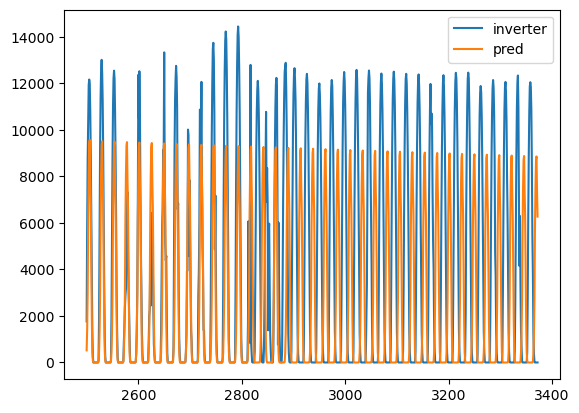

In [210]:
y_test.plot()

C:\Users\tsiop\AppData\Local\Temp\ipykernel_4928\1856846499.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  y_test['pred'] = y_test['pred'].map(lambda x: max(x,0))


<Axes: >

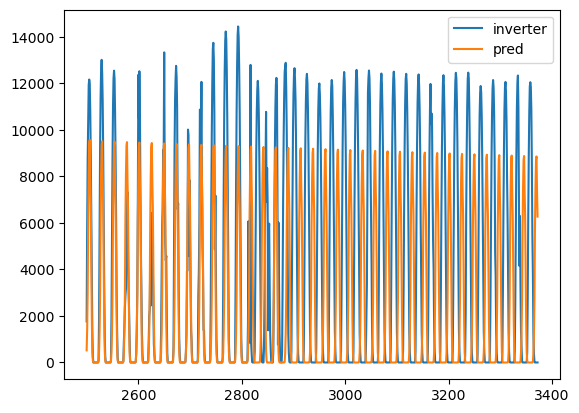

In [211]:
y_test['pred'] = y_test['pred'].map(lambda x: max(x,0))
y_test.plot()

<Axes: >

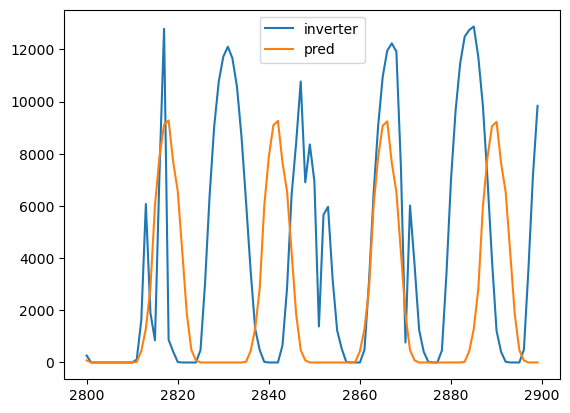

In [212]:
y_test[300:400].plot()

In [213]:
metric(y_test['inverter'],y_test['pred'])

MAPE ML Model: 470.2823956992539
SMAPE ML Model: 80.14615677982113


## train sarimax to find fluctuations

In [9]:
import matplotlib.pyplot as plt
import pandas as pd
import statsmodels.api as sm
import requests
from io import BytesIO

In [10]:
# Fit the model
model = sm.tsa.statespace.SARIMAX(df1['inverter'],order=(1,0,1),seasonal_order=(1,0,2,24),enforce_stationarity=False)
results = model.fit(disp=False)

In [11]:
# Get predictions
# (can also utilize results.get_forecast(steps=n).summary_frame(alpha=0.05))
preds_df = (results
            .get_prediction()
            .summary_frame(alpha=0.01)
)
print(preds_df.head())

inverter  mean      mean_se  mean_ci_lower  mean_ci_upper
0          0.0  1000.000000   -2575.829304    2575.829304
1          0.0  1451.513675   -3738.851460    3738.851460
2          0.0  1457.315930   -3753.797078    3753.797078
3          0.0  1457.366868   -3753.928284    3753.928284
4          0.0  1457.367312   -3753.929429    3753.929429


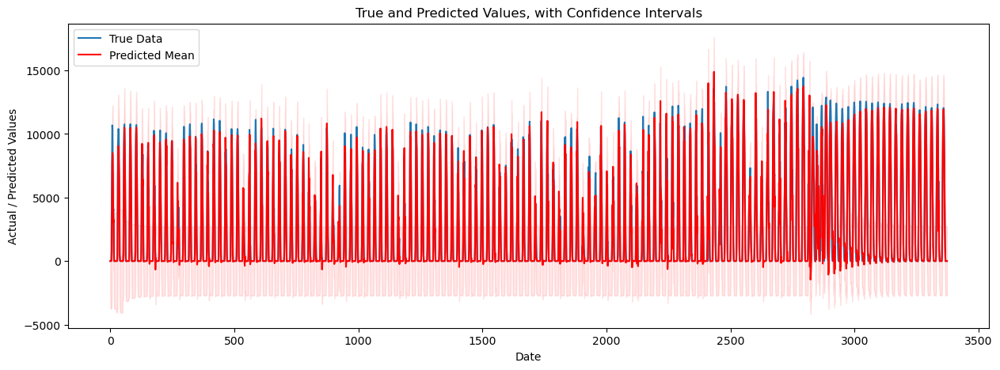

In [12]:
# Plot the training data, predicted means and confidence intervals
fig, ax = plt.subplots(figsize=(15,5))
ax = df1['inverter'].plot(label='True Data')
ax.set(
    title='True and Predicted Values, with Confidence Intervals',
    xlabel='Date',
    ylabel='Actual / Predicted Values'
)
preds_df['mean'].plot(ax=ax, style='r', label='Predicted Mean')
ax.fill_between(
    preds_df.index, preds_df['mean_ci_lower'], preds_df['mean_ci_upper'],
    color='r', alpha=0.1
)
legend = ax.legend(loc='upper left')
plt.show()

In [13]:
preds_df['inverter'] = df1['inverter']
preds_df['datetime'] = df1['datetime']

In [14]:
preds_df['fluctuation'] = preds_df.apply(lambda x: x['inverter']>x['mean_ci_upper'] or x['inverter']<x['mean_ci_lower'], axis=1)

In [15]:
preds_df[preds_df['fluctuation']]

inverter,mean,mean_se,mean_ci_lower,mean_ci_upper,inverter,datetime,fluctuation
7,3812.771532,1457.367316,58.842093,7566.700971,9246.350000,2023-11-03 07:00:00,True
154,7658.093647,1065.992163,4912.279796,10403.907498,3611.833333,2023-11-09 10:00:00,True
178,7960.048233,1060.298388,5228.900574,10691.195891,4734.683333,2023-11-10 10:00:00,True
271,6166.580295,1053.153182,3453.837468,8879.323123,2165.550000,2023-11-14 07:00:00,True
276,1489.645840,1053.153182,-1223.096987,4202.388667,4210.066667,2023-11-14 12:00:00,True
...,...,...,...,...,...,...,...
2899,6000.240620,1052.089326,3290.238105,8710.243136,9837.733333,2024-06-11 06:00:00,True
2922,4072.747291,1052.089326,1362.744775,6782.749807,7047.883333,2024-06-12 05:00:00,True
2923,6557.386449,1052.089326,3847.383933,9267.388965,9621.750000,2024-06-12 06:00:00,True
3336,9802.921389,1052.089326,7092.918873,12512.923905,7053.583333,2024-06-29 11:00:00,True


In [16]:
preds_df['fluctuation'] = preds_df['fluctuation'].astype(int)

<Axes: >

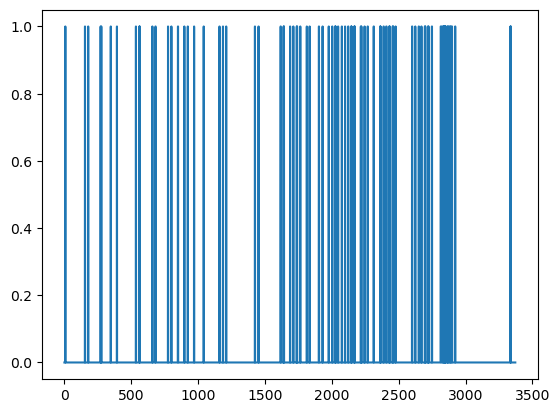

In [17]:
preds_df['fluctuation'].plot()

In [18]:
preds_df['interval'] = preds_df['mean_ci_upper']-preds_df['mean_ci_lower']

<Axes: ylabel='Frequency'>

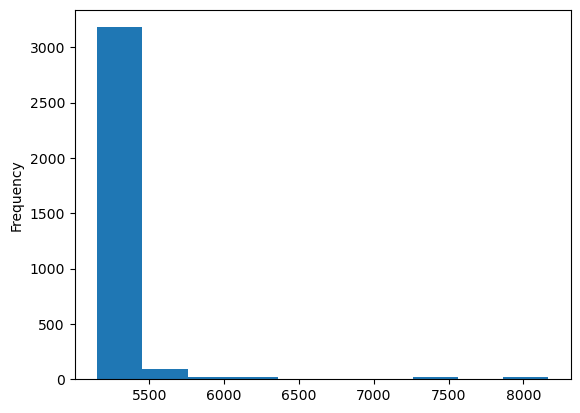

In [19]:
preds_df['interval'].plot.hist()

In [20]:
preds_df['colour'] = preds_df['fluctuation'].map(lambda x: 'red' if x==1 else 'blue')

<Axes: >

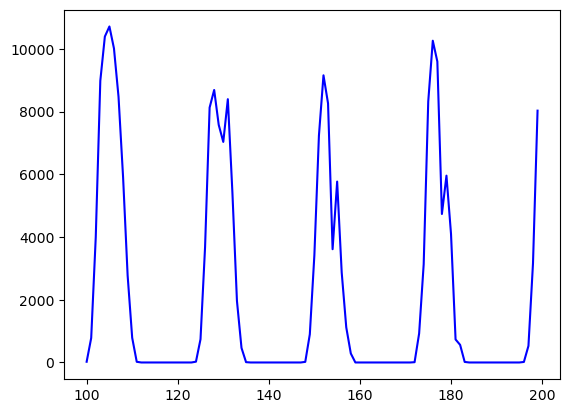

In [21]:
preds_df['inverter'][100:200].plot(color=preds_df.colour)

In [22]:
# import plotly.graph_objects as go

# def plot_base_line(df,y_column):
#     figure = go.Figure()
#     figure.add_trace(go.Scatter(name=y_column, x = df.index, y=df[y_column], marker=dict(color='rgba(50,50,50,0.3)')))
#     figure.show()

# plot_base_line(preds_df,'inverter')

In [23]:
preds_df['size'] = preds_df['fluctuation'].map(lambda x: 2 if x==1 else 1)

In [24]:
fluctuations = preds_df[preds_df['fluctuation']==1]
non_fluctuations = preds_df[preds_df['fluctuation']==0]

In [25]:
fluctuations

inverter,mean,mean_se,mean_ci_lower,mean_ci_upper,inverter,datetime,fluctuation,interval,colour,size
7,3812.771532,1457.367316,58.842093,7566.700971,9246.350000,2023-11-03 07:00:00,1,7507.858878,red,2
154,7658.093647,1065.992163,4912.279796,10403.907498,3611.833333,2023-11-09 10:00:00,1,5491.627702,red,2
178,7960.048233,1060.298388,5228.900574,10691.195891,4734.683333,2023-11-10 10:00:00,1,5462.295317,red,2
271,6166.580295,1053.153182,3453.837468,8879.323123,2165.550000,2023-11-14 07:00:00,1,5425.485655,red,2
276,1489.645840,1053.153182,-1223.096987,4202.388667,4210.066667,2023-11-14 12:00:00,1,5425.485655,red,2
...,...,...,...,...,...,...,...,...,...,...
2899,6000.240620,1052.089326,3290.238105,8710.243136,9837.733333,2024-06-11 06:00:00,1,5420.005032,red,2
2922,4072.747291,1052.089326,1362.744775,6782.749807,7047.883333,2024-06-12 05:00:00,1,5420.005032,red,2
2923,6557.386449,1052.089326,3847.383933,9267.388965,9621.750000,2024-06-12 06:00:00,1,5420.005032,red,2
3336,9802.921389,1052.089326,7092.918873,12512.923905,7053.583333,2024-06-29 11:00:00,1,5420.005032,red,2


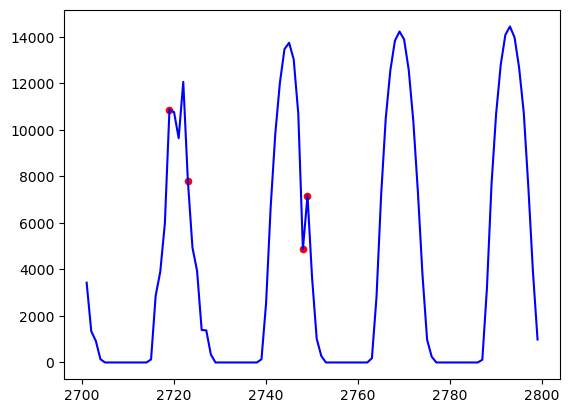

In [26]:
import matplotlib

x = 2700
y = 2800

plt.plot(preds_df.index[(preds_df.index>x) & (preds_df.index<y)], preds_df.inverter[(preds_df.index>x) & (preds_df.index<y)], color="blue", markersize=4)
plt.scatter(fluctuations.index[(fluctuations.index>x) & (fluctuations.index<y)], fluctuations.inverter[(fluctuations.index>x) & (fluctuations.index<y)], color="red", s=20)

plt.show()

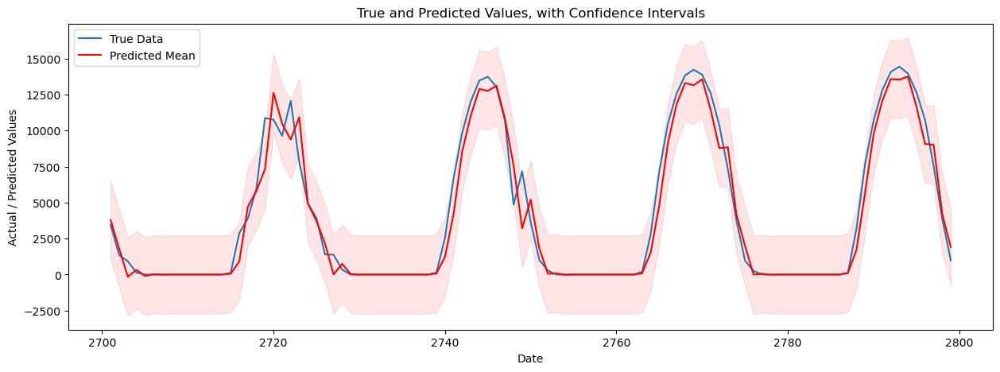

In [27]:
# Plot the training data, predicted means and confidence intervals
fig, ax = plt.subplots(figsize=(15,5))

#x=1100
#y=1200

ax = df1['inverter'][(df1.index>x) & (df1.index<y)].plot(label='True Data')
ax.set(
    title='True and Predicted Values, with Confidence Intervals',
    xlabel='Date',
    ylabel='Actual / Predicted Values'
)
preds_df['mean'][(preds_df.index>x) & (preds_df.index<y)].plot(ax=ax, style='r', label='Predicted Mean')
ax.fill_between(
    preds_df.index[(preds_df.index>x) & (preds_df.index<y)], preds_df['mean_ci_lower'][(preds_df.index>x) & (preds_df.index<y)], preds_df['mean_ci_upper'][(preds_df.index>x) & (preds_df.index<y)],
    color='r', alpha=0.1
)
legend = ax.legend(loc='upper left')
plt.show()

In [28]:
preds_df[x:y]

inverter,mean,mean_se,mean_ci_lower,mean_ci_upper,inverter,datetime,fluctuation,interval,colour,size
2700,6518.319223,1052.089326,3808.316707,9228.321739,5233.033333,2024-04-30 12:00:00,0,5420.005032,blue,1
2701,3773.619258,1052.089326,1063.616742,6483.621774,3430.166667,2024-04-30 13:00:00,0,5420.005032,blue,1
2702,1784.423097,1052.089326,-925.579419,4494.425613,1344.416667,2024-04-30 14:00:00,0,5420.005032,blue,1
2703,-148.978485,1052.089326,-2858.981001,2561.024031,924.416667,2024-04-30 15:00:00,0,5420.005032,blue,1
2704,329.120252,1052.089326,-2380.882264,3039.122768,139.433333,2024-04-30 16:00:00,0,5420.005032,blue,1
...,...,...,...,...,...,...,...,...,...,...
2795,11674.680050,1052.089326,8964.677534,14384.682566,12654.866667,2024-05-04 11:00:00,0,5420.005032,blue,1
2796,9075.481897,1052.089326,6365.479381,11785.484413,10742.716667,2024-05-04 12:00:00,0,5420.005032,blue,1
2797,9006.574508,1052.089326,6296.571992,11716.577024,7538.050000,2024-05-04 13:00:00,0,5420.005032,blue,1
2798,4222.382329,1052.089326,1512.379813,6932.384845,3896.650000,2024-05-04 14:00:00,0,5420.005032,blue,1


# MANUALLY

## INVERTER1

In [6]:
dfi = df[df['id']=='inverter1'].copy()
dfi = dfi.drop('id',axis=1)

In [7]:
dfi = dfi.set_index('datetime')
dfi['inverter_moving_average'] = dfi['inverter'].rolling(window=pd.Timedelta(hours=3),center=True).mean()
dfi['inverter_max'] = dfi['inverter'].rolling(window=pd.Timedelta(hours=24),center=True).max()
dfi['inverter_moving_average_max'] = dfi['inverter_moving_average'].rolling(window=pd.Timedelta(hours=24),center=True).max()

dfi['ratio'] = dfi['inverter_max']/dfi['inverter_moving_average_max']
dfi['inverter_moving_average'] = dfi['inverter_moving_average']*dfi['ratio']
dfi['inverter_moving_average'] = dfi.apply(lambda x: 0 if x['inverter']==0 else x['inverter_moving_average'],axis=1)

dfi['difference'] = abs(dfi['inverter_moving_average']-dfi['inverter'])
dfi['difference_max'] = dfi['difference'].rolling(window=pd.Timedelta(hours=12),center=True).max()
dfi['difference__maxx'] = dfi.apply(lambda x: x['difference'] if x['difference']==x['difference_max'] else 0, axis=1)

dfi['fluctuation'] = dfi['difference__maxx']>(dfi['inverter_max']*1/4)
dfi = dfi.reset_index()

fluctuations = dfi[dfi['fluctuation']==1]

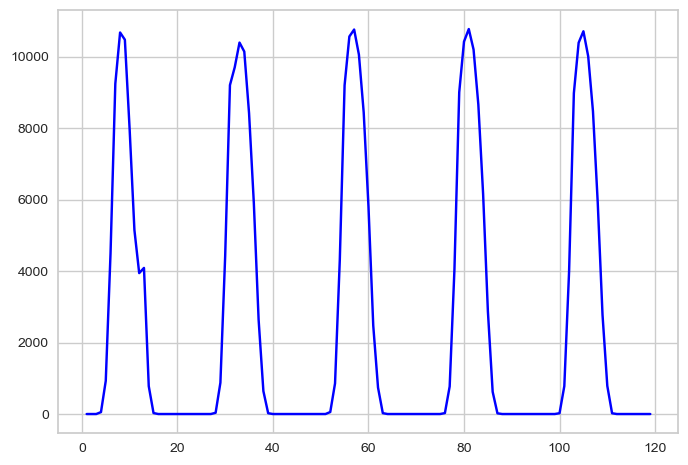

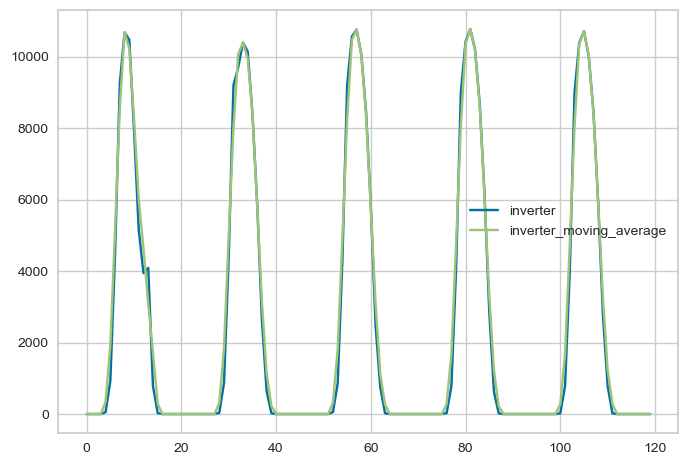

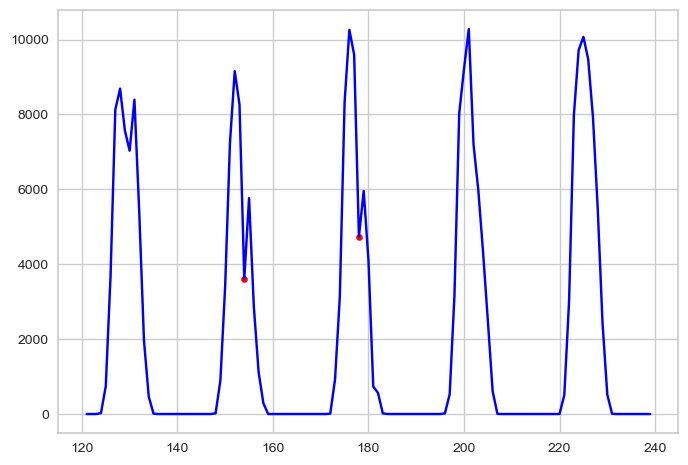

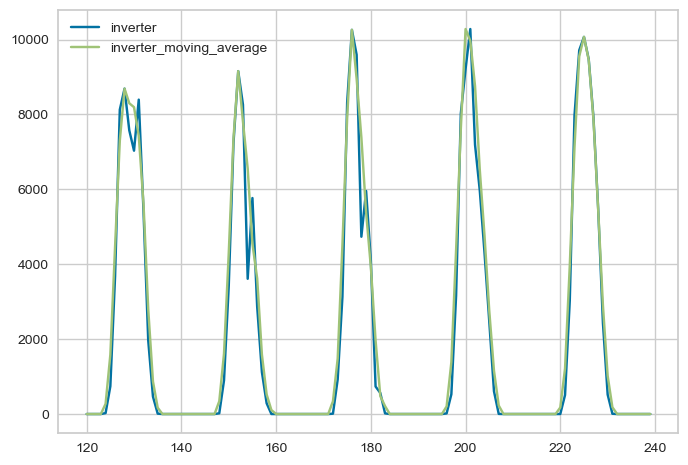

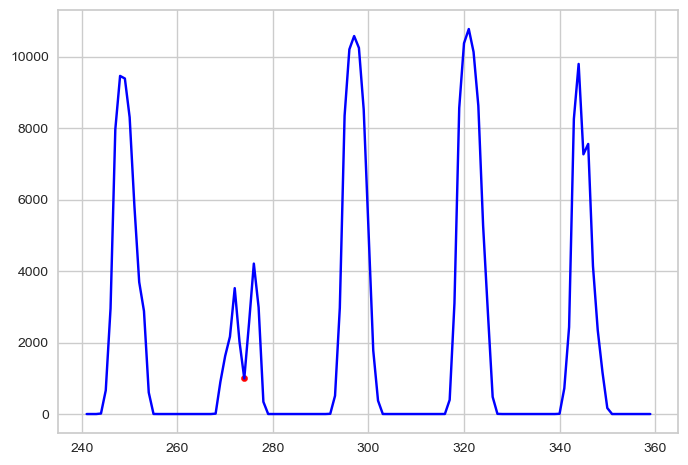

...

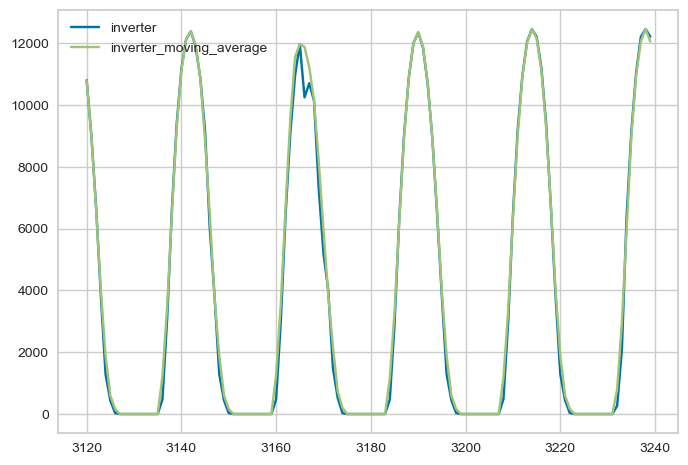

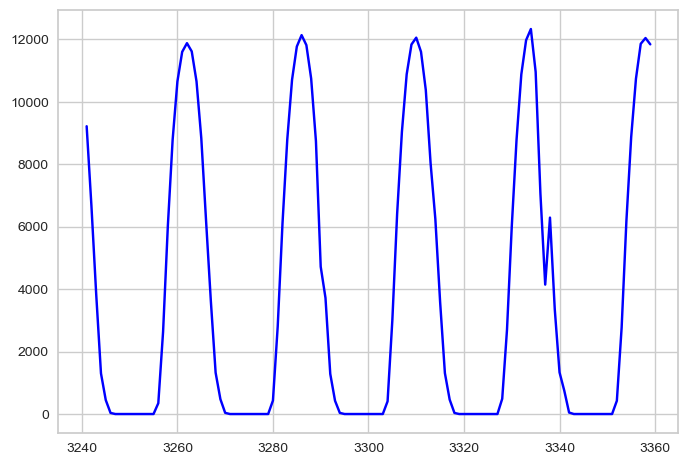

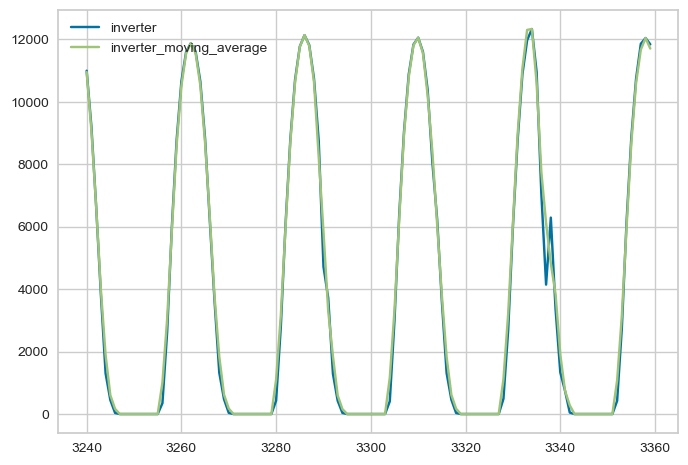

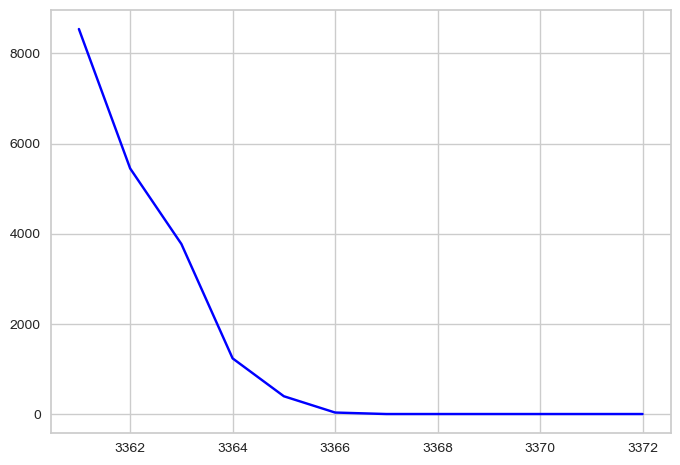

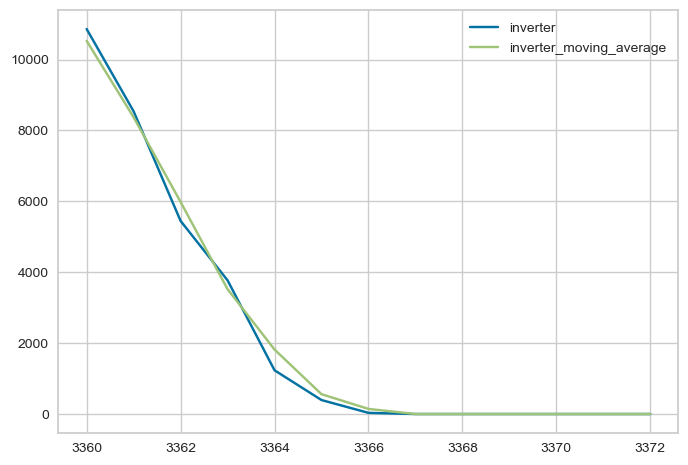

In [8]:
import matplotlib.pyplot as plt

for i in range(0,int(3373/120)+1) :
    x = i*120
    y = (i+1)*120

    plt.plot(dfi.index[(dfi.index>x) & (dfi.index<y)], dfi.inverter[(dfi.index>x) & (dfi.index<y)], color="blue", markersize=4)
    plt.scatter(fluctuations.index[(fluctuations.index>x) & (fluctuations.index<y)], fluctuations.inverter[(fluctuations.index>x) & (fluctuations.index<y)], color="red", s=20)

    plt.show()
    
    dfi[['inverter','inverter_moving_average']][x:y].plot()
    
    plt.show()

In [9]:
dfi.fluctuation.sum()

37

In [10]:
dfi['fluct-1'] = dfi['fluctuation'].shift(-1)
dfi['fluct-2'] = dfi['fluctuation'].shift(-2)
dfi['fluct+1'] = dfi['fluctuation'].shift(1)
dfi['fluct+2'] = dfi['fluctuation'].shift(2)

dfi['fluctuation'] = dfi.apply(lambda x: x['fluct-1'] or x['fluct-2'] or x['fluctuation'] or x['fluct+1'] or x['fluct+2'],axis=1)
dfi['fluctuation'] = dfi['fluctuation'].fillna(False)

In [11]:
dfi.fluctuation.sum()

183

In [12]:
fluctuations = dfi[dfi['fluctuation']==1]

<Axes: xlabel='fluctuation'>

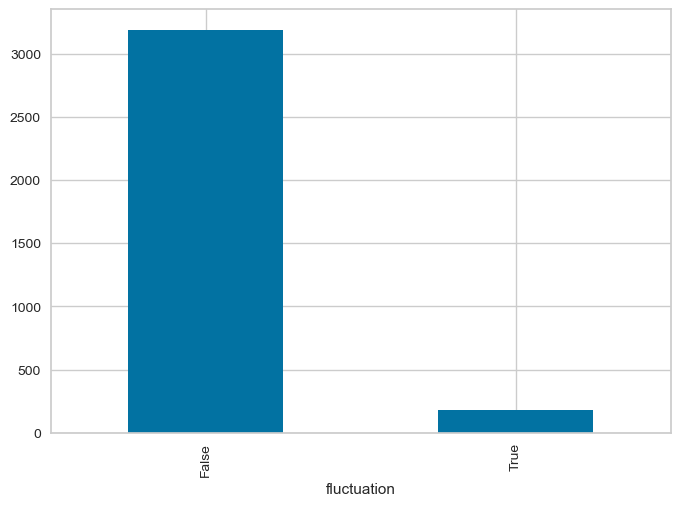

In [13]:
dfi['fluctuation'].value_counts().plot.bar()

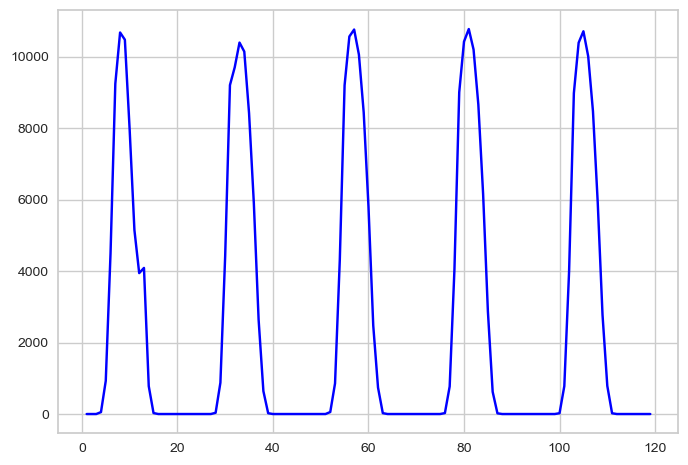

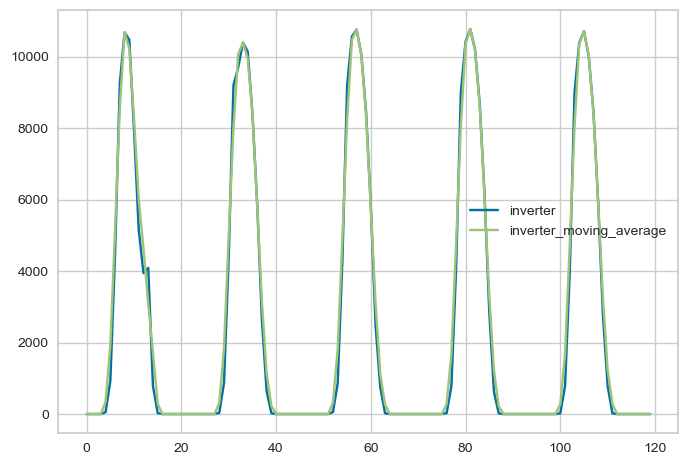

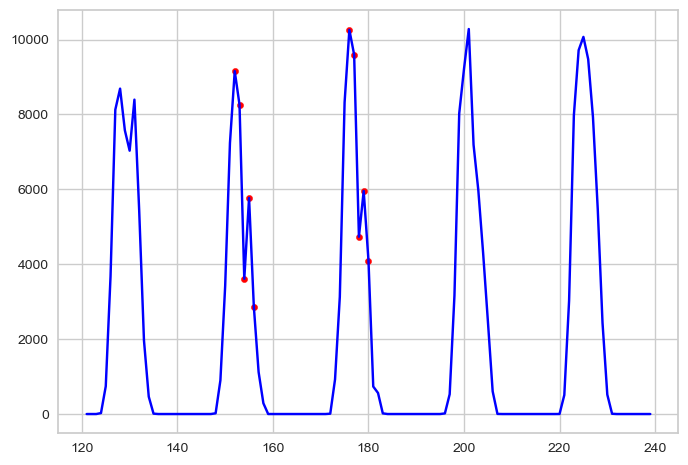

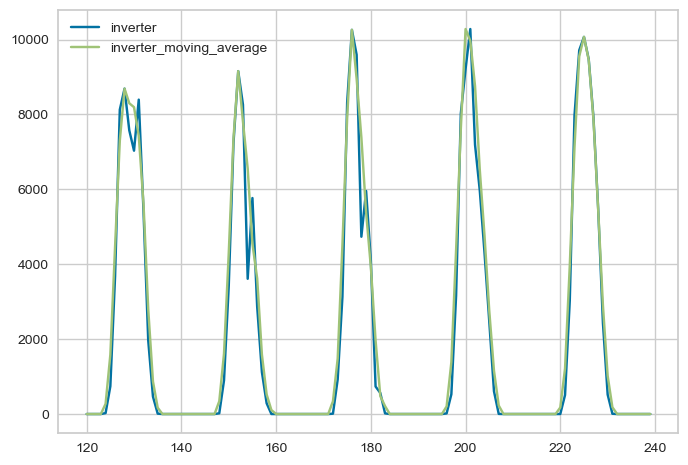

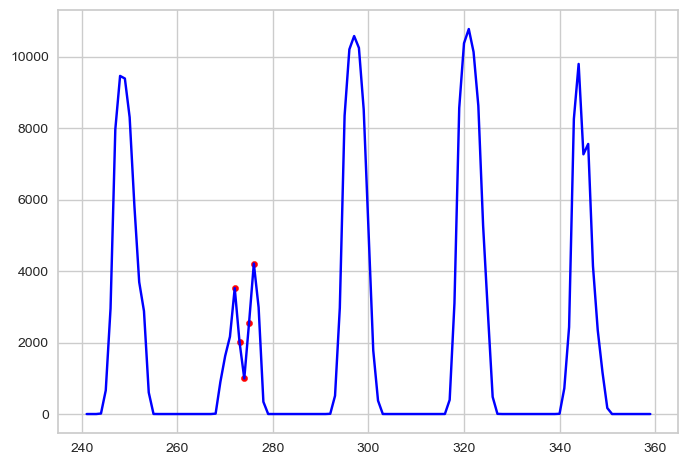

...

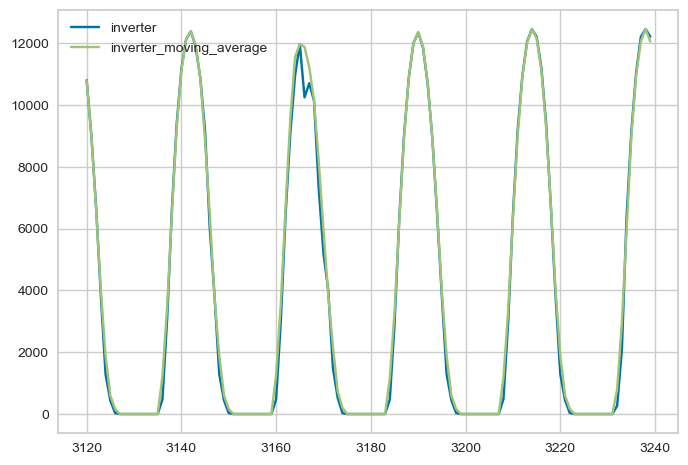

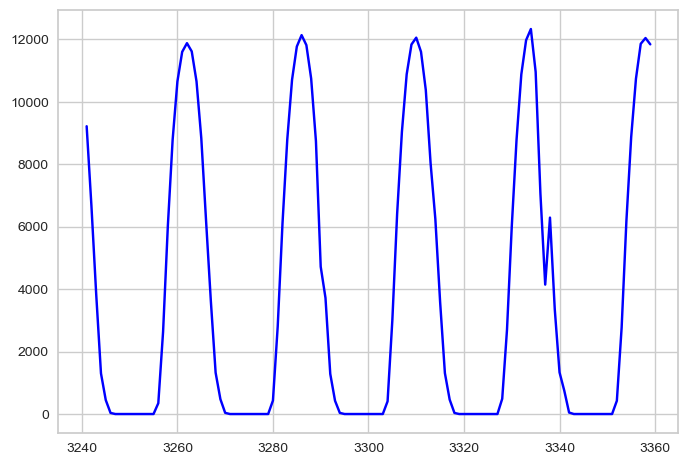

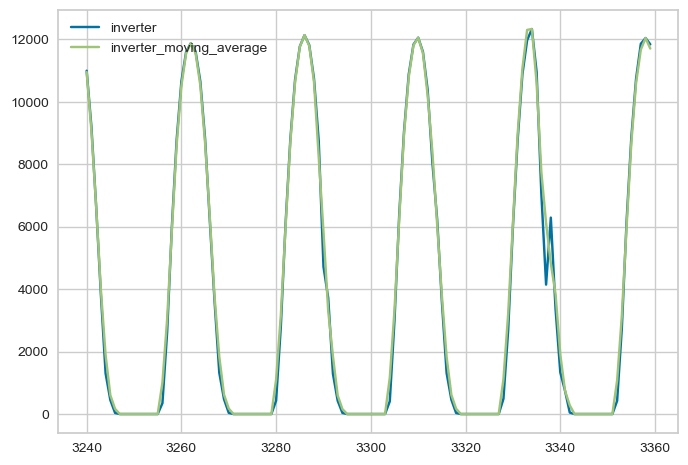

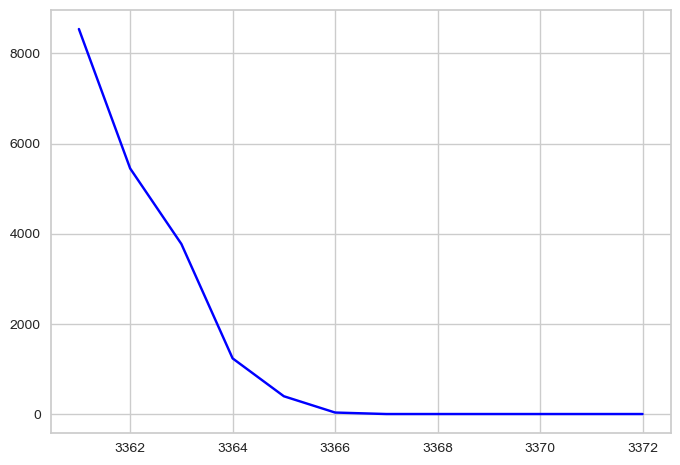

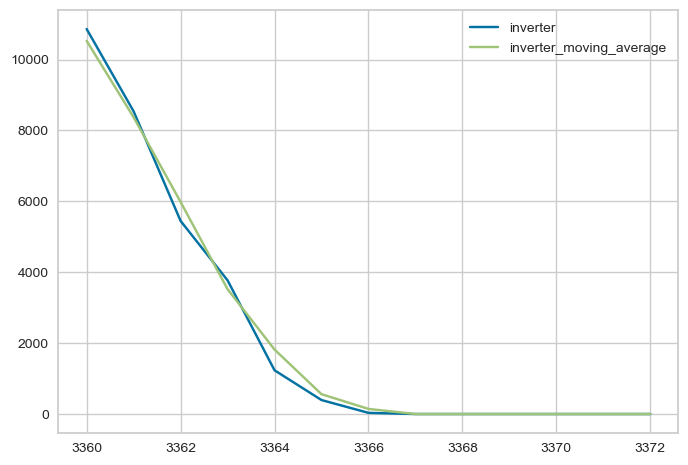

In [14]:
import matplotlib.pyplot as plt

for i in range(0,int(3373/120)+1) :
    x = i*120
    y = (i+1)*120

    plt.plot(dfi.index[(dfi.index>x) & (dfi.index<y)], dfi.inverter[(dfi.index>x) & (dfi.index<y)], color="blue", markersize=4)
    plt.scatter(fluctuations.index[(fluctuations.index>x) & (fluctuations.index<y)], fluctuations.inverter[(fluctuations.index>x) & (fluctuations.index<y)], color="red", s=20)

    plt.show()
    
    dfi[['inverter','inverter_moving_average']][x:y].plot()
    
    plt.show()

In [15]:
dfi.columns

Index(['datetime', 'inverter', 'panel_size', 'temperature_2m',
       'relative_humidity_2m', 'apparent_temperature', 'precipitation', 'rain',
       'cloud_cover', 'cloud_cover_low', 'cloud_cover_mid', 'cloud_cover_high',
       'wind_speed_10m', 'wind_speed_100m', 'wind_gusts_10m', 'is_day',
       'sunshine_duration', 'shortwave_radiation', 'direct_radiation',
       'diffuse_radiation', 'direct_normal_irradiance',
       'terrestrial_radiation', 'shortwave_radiation_instant',
       'direct_radiation_instant', 'diffuse_radiation_instant',
       'direct_normal_irradiance_instant', 'terrestrial_radiation_instant',
       'azimuth', 'zenith', 'month', 'hour', 'energy',
       'inverter_moving_average', 'inverter_max',
       'inverter_moving_average_max', 'ratio', 'difference', 'difference_max',
       'difference__maxx', 'fluctuation', 'fluct-1', 'fluct-2', 'fluct+1',
       'fluct+2'],
      dtype='object')

In [16]:
dfi = dfi.drop(['energy',
       'inverter_moving_average', 'inverter_max',
       'inverter_moving_average_max', 'ratio', 'difference', 'difference_max',
       'difference__maxx', 'fluct-1', 'fluct-2', 'fluct+1',
       'fluct+2','panel_size','inverter'],axis=1)

dfi['fluctuation'] = dfi['fluctuation'].astype(int)

In [17]:
dfi.columns

Index(['datetime', 'temperature_2m', 'relative_humidity_2m',
       'apparent_temperature', 'precipitation', 'rain', 'cloud_cover',
       'cloud_cover_low', 'cloud_cover_mid', 'cloud_cover_high',
       'wind_speed_10m', 'wind_speed_100m', 'wind_gusts_10m', 'is_day',
       'sunshine_duration', 'shortwave_radiation', 'direct_radiation',
       'diffuse_radiation', 'direct_normal_irradiance',
       'terrestrial_radiation', 'shortwave_radiation_instant',
       'direct_radiation_instant', 'diffuse_radiation_instant',
       'direct_normal_irradiance_instant', 'terrestrial_radiation_instant',
       'azimuth', 'zenith', 'month', 'hour', 'fluctuation'],
      dtype='object')

In [18]:
data_train, data_test = train_test_split(dfi, test_size=0.2, random_state=1)
data_test = data_test.sort_values('datetime')

data_train = data_train.drop('datetime',axis=1)
data_test = data_test.drop('datetime',axis=1)

### pycaret

In [19]:
s = setup(data = data_train, target = 'fluctuation', session_id = 1, fold = 5)

,Description,Value
0,Session id,1
1,Target,fluctuation
2,Target type,Binary
3,Original data shape,"(2698, 29)"
4,Transformed data shape,"(2698, 29)"
5,Transformed train set shape,"(1888, 29)"
6,Transformed test set shape,"(810, 29)"
7,Numeric features,28
8,Preprocess,True
9,Imputation type,simple


In [20]:
best3 = s.compare_models(n_select = 3, sort='F1') #include = ['et', 'rf', 'lightgbm', 'xgboost', 'lda', 'ridge', 'dt', 'knn', 'gbc', 'ada', 'catboost', 'lr']

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
dt,Decision Tree Classifier,0.9264,0.6487,0.3376,0.3236,0.3294,0.2906,0.2912,0.0700
lightgbm,Light Gradient Boosting Machine,0.9465,0.9211,0.2386,0.5150,0.3200,0.2962,0.3228,0.8460
lda,Linear Discriminant Analysis,0.9343,0.8990,0.2667,0.3837,0.3101,0.2766,0.2841,0.0500
xgboost,Extreme Gradient Boosting,0.9460,0.9119,0.2286,0.4887,0.3066,0.2830,0.3072,0.2880
ada,Ada Boost Classifier,0.9402,0.9092,0.2376,0.4641,0.3043,0.2753,0.2974,0.3840
gbc,Gradient Boosting Classifier,0.9439,0.9050,0.2390,0.4240,0.2983,0.2730,0.2882,1.2340
nb,Naive Bayes,0.7437,0.8683,0.8819,0.1607,0.2715,0.1989,0.3059,2.1000
rf,Random Forest Classifier,0.9492,0.9227,0.1895,0.5173,0.2702,0.2524,0.2884,0.4620
et,Extra Trees Classifier,0.9476,0.9241,0.1895,0.4929,0.2650,0.2457,0.2783,0.3080
lr,Logistic Regression,0.9481,0.9150,0.1590,0.5079,0.2403,0.2225,0.2635,4.1800


### pycaret - SMOTEENN

In [21]:
from imblearn.combine import SMOTEENN

sme = SMOTEENN(sampling_strategy='all', random_state=1, n_jobs=-1)

In [22]:
X = data_train.drop('fluctuation',axis=1)
y = data_train[['fluctuation']]

In [23]:
X_res, y_res = sme.fit_resample(X, y)

<Axes: xlabel='fluctuation'>

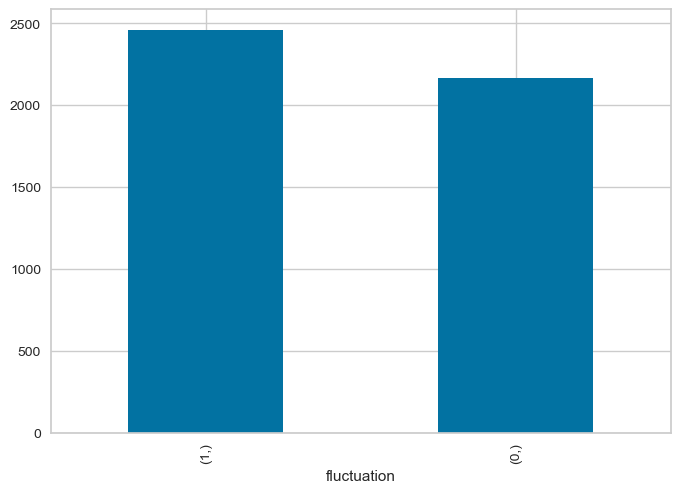

In [24]:
y_res.value_counts().plot.bar()

In [25]:
data_train = X_res.copy()
data_train['fluctuation'] = y_res

In [26]:
s = setup(data = data_train, target = 'fluctuation', session_id = 1, fold = 10)

,Description,Value
0,Session id,1
1,Target,fluctuation
2,Target type,Binary
3,Original data shape,"(4630, 29)"
4,Transformed data shape,"(4630, 29)"
5,Transformed train set shape,"(3241, 29)"
6,Transformed test set shape,"(1389, 29)"
7,Numeric features,28
8,Preprocess,True
9,Imputation type,simple


In [27]:
best3 = s.compare_models(n_select = 3, sort='F1') 

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
lightgbm,Light Gradient Boosting Machine,0.9889,0.9986,0.9948,0.9846,0.9896,0.9777,0.9779,1.0010
et,Extra Trees Classifier,0.9883,0.9997,0.9954,0.9829,0.9891,0.9764,0.9766,0.3910
xgboost,Extreme Gradient Boosting,0.9864,0.9984,0.9931,0.9818,0.9873,0.9727,0.9730,0.3110
rf,Random Forest Classifier,0.9837,0.9990,0.9907,0.9789,0.9847,0.9671,0.9674,1.1510
gbc,Gradient Boosting Classifier,0.9803,0.9973,0.9867,0.9766,0.9815,0.9603,0.9606,2.8320
knn,K Neighbors Classifier,0.9790,0.9953,0.9936,0.9679,0.9806,0.9578,0.9583,0.2080
dt,Decision Tree Classifier,0.9793,0.9791,0.9832,0.9781,0.9806,0.9585,0.9586,0.1120
ada,Ada Boost Classifier,0.9762,0.9954,0.9867,0.9694,0.9779,0.9522,0.9527,0.6950
lr,Logistic Regression,0.9596,0.9868,0.9820,0.9444,0.9628,0.9186,0.9196,0.4240
ridge,Ridge Classifier,0.9244,0.0000,0.9890,0.8837,0.9332,0.8469,0.8545,0.0430


In [28]:
predict_model(best3[0],data_test)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Light Gradient Boosting Machine,0.8889,0.9272,0.8684,0.3204,0.4681,0.4204,0.4862


,temperature_2m,relative_humidity_2m,apparent_temperature,precipitation,rain,cloud_cover,cloud_cover_low,cloud_cover_mid,cloud_cover_high,wind_speed_10m,...,diffuse_radiation_instant,direct_normal_irradiance_instant,terrestrial_radiation_instant,azimuth,zenith,month,hour,fluctuation,prediction_label,prediction_score
3,16.108000,89.370384,16.999006,0.0,0.0,5.700000,0.0,0.0,19.0,3.706427,...,0.000000,0.000000,0.000000,98.224670,104.536469,11,3,0,0,1.0000
4,15.558001,87.033760,16.109491,0.0,0.0,0.000000,0.0,0.0,0.0,3.706427,...,0.000000,0.000000,0.000000,106.508156,92.468445,11,4,0,0,1.0000
6,21.458000,55.240314,21.177088,0.0,0.0,0.000000,0.0,0.0,0.0,6.409617,...,90.817406,482.204742,461.024963,125.681030,70.558144,11,6,0,0,0.9999
7,23.858000,53.366432,24.076742,0.0,0.0,3.000000,3.0,0.0,1.0,6.924738,...,105.385185,655.079834,663.350281,138.007629,61.436432,11,7,0,1,0.6991
10,28.257999,35.032356,28.253460,0.0,0.0,32.700001,1.0,3.0,100.0,5.116561,...,120.144188,754.419495,879.966187,189.398972,50.678322,11,10,0,1,0.9986
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3347,24.808001,84.455307,28.627396,0.0,0.0,0.000000,0.0,0.0,0.0,7.594207,...,0.000000,0.000000,0.000000,2.672956,121.631645,6,22,0,0,1.0000
3351,24.058001,90.237267,28.688232,0.0,0.0,4.500000,5.0,0.0,0.0,3.396233,...,0.000000,0.000000,0.000000,55.226421,96.913406,6,2,0,0,1.0000
3357,33.708000,29.083176,34.158760,0.0,0.0,0.000000,0.0,0.0,0.0,13.441071,...,142.423309,796.412048,1181.411499,109.222427,26.760262,6,8,0,0,1.0000
3369,27.908001,63.170002,29.901440,0.0,0.0,0.000000,0.0,0.0,0.0,13.679999,...,0.000000,0.000000,0.000000,331.687134,116.142097,6,20,0,0,1.0000


In [29]:
predict_model(best3[1],data_test)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Extra Trees Classifier,0.8756,0.9269,0.8158,0.2870,0.4247,0.3724,0.4369


,temperature_2m,relative_humidity_2m,apparent_temperature,precipitation,rain,cloud_cover,cloud_cover_low,cloud_cover_mid,cloud_cover_high,wind_speed_10m,...,diffuse_radiation_instant,direct_normal_irradiance_instant,terrestrial_radiation_instant,azimuth,zenith,month,hour,fluctuation,prediction_label,prediction_score
3,16.108000,89.370384,16.999006,0.0,0.0,5.700000,0.0,0.0,19.0,3.706427,...,0.000000,0.000000,0.000000,98.224670,104.536469,11,3,0,0,1.00
4,15.558001,87.033760,16.109491,0.0,0.0,0.000000,0.0,0.0,0.0,3.706427,...,0.000000,0.000000,0.000000,106.508156,92.468445,11,4,0,0,1.00
6,21.458000,55.240314,21.177088,0.0,0.0,0.000000,0.0,0.0,0.0,6.409617,...,90.817406,482.204742,461.024963,125.681030,70.558144,11,6,0,0,0.90
7,23.858000,53.366432,24.076742,0.0,0.0,3.000000,3.0,0.0,1.0,6.924738,...,105.385185,655.079834,663.350281,138.007629,61.436432,11,7,0,0,0.72
10,28.257999,35.032356,28.253460,0.0,0.0,32.700001,1.0,3.0,100.0,5.116561,...,120.144188,754.419495,879.966187,189.398972,50.678322,11,10,0,0,0.54
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3347,24.808001,84.455307,28.627396,0.0,0.0,0.000000,0.0,0.0,0.0,7.594207,...,0.000000,0.000000,0.000000,2.672956,121.631645,6,22,0,0,1.00
3351,24.058001,90.237267,28.688232,0.0,0.0,4.500000,5.0,0.0,0.0,3.396233,...,0.000000,0.000000,0.000000,55.226421,96.913406,6,2,0,0,1.00
3357,33.708000,29.083176,34.158760,0.0,0.0,0.000000,0.0,0.0,0.0,13.441071,...,142.423309,796.412048,1181.411499,109.222427,26.760262,6,8,0,0,1.00
3369,27.908001,63.170002,29.901440,0.0,0.0,0.000000,0.0,0.0,0.0,13.679999,...,0.000000,0.000000,0.000000,331.687134,116.142097,6,20,0,0,1.00


In [30]:
predict_model(best3[2],data_test)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Extreme Gradient Boosting,0.8874,0.9209,0.8684,0.3173,0.4648,0.4167,0.4833


,temperature_2m,relative_humidity_2m,apparent_temperature,precipitation,rain,cloud_cover,cloud_cover_low,cloud_cover_mid,cloud_cover_high,wind_speed_10m,...,diffuse_radiation_instant,direct_normal_irradiance_instant,terrestrial_radiation_instant,azimuth,zenith,month,hour,fluctuation,prediction_label,prediction_score
3,16.108000,89.370384,16.999006,0.0,0.0,5.700000,0.0,0.0,19.0,3.706427,...,0.000000,0.000000,0.000000,98.224670,104.536469,11,3,0,0,0.9999
4,15.558001,87.033760,16.109491,0.0,0.0,0.000000,0.0,0.0,0.0,3.706427,...,0.000000,0.000000,0.000000,106.508156,92.468445,11,4,0,0,1.0000
6,21.458000,55.240314,21.177088,0.0,0.0,0.000000,0.0,0.0,0.0,6.409617,...,90.817406,482.204742,461.024963,125.681030,70.558144,11,6,0,0,0.9998
7,23.858000,53.366432,24.076742,0.0,0.0,3.000000,3.0,0.0,1.0,6.924738,...,105.385185,655.079834,663.350281,138.007629,61.436432,11,7,0,0,0.9188
10,28.257999,35.032356,28.253460,0.0,0.0,32.700001,1.0,3.0,100.0,5.116561,...,120.144188,754.419495,879.966187,189.398972,50.678322,11,10,0,1,0.9949
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3347,24.808001,84.455307,28.627396,0.0,0.0,0.000000,0.0,0.0,0.0,7.594207,...,0.000000,0.000000,0.000000,2.672956,121.631645,6,22,0,0,1.0000
3351,24.058001,90.237267,28.688232,0.0,0.0,4.500000,5.0,0.0,0.0,3.396233,...,0.000000,0.000000,0.000000,55.226421,96.913406,6,2,0,0,0.9999
3357,33.708000,29.083176,34.158760,0.0,0.0,0.000000,0.0,0.0,0.0,13.441071,...,142.423309,796.412048,1181.411499,109.222427,26.760262,6,8,0,0,1.0000
3369,27.908001,63.170002,29.901440,0.0,0.0,0.000000,0.0,0.0,0.0,13.679999,...,0.000000,0.000000,0.000000,331.687134,116.142097,6,20,0,0,1.0000


### ExtraTreesClassifier

In [56]:
from sklearn.ensemble import ExtraTreesClassifier

from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score

from sklearn import metrics
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix

In [57]:
dfi = df[df['id']=='inverter1'].copy()
dfi = dfi.drop('id',axis=1)

dfi = dfi.set_index('datetime')
dfi['inverter_moving_average'] = dfi['inverter'].rolling(window=pd.Timedelta(hours=3),center=True).mean()
dfi['inverter_max'] = dfi['inverter'].rolling(window=pd.Timedelta(hours=24),center=True).max()
dfi['inverter_moving_average_max'] = dfi['inverter_moving_average'].rolling(window=pd.Timedelta(hours=24),center=True).max()

dfi['ratio'] = dfi['inverter_max']/dfi['inverter_moving_average_max']
dfi['inverter_moving_average'] = dfi['inverter_moving_average']*dfi['ratio']
dfi['inverter_moving_average'] = dfi.apply(lambda x: 0 if x['inverter']==0 else x['inverter_moving_average'],axis=1)

dfi['difference'] = abs(dfi['inverter_moving_average']-dfi['inverter'])
dfi['difference_max'] = dfi['difference'].rolling(window=pd.Timedelta(hours=12),center=True).max()
dfi['difference__maxx'] = dfi.apply(lambda x: x['difference'] if x['difference']==x['difference_max'] else 0, axis=1)

dfi['fluctuation'] = dfi['difference__maxx']>(dfi['inverter_max']*1/4)
dfi = dfi.reset_index()

dfi['fluct-1'] = dfi['fluctuation'].shift(-1)
dfi['fluct-2'] = dfi['fluctuation'].shift(-2)
dfi['fluct+1'] = dfi['fluctuation'].shift(1)
dfi['fluct+2'] = dfi['fluctuation'].shift(2)

dfi['fluctuation'] = dfi.apply(lambda x: x['fluct-1'] or x['fluct-2'] or x['fluctuation'] or x['fluct+1'] or x['fluct+2'],axis=1)
dfi['fluctuation'] = dfi['fluctuation'].fillna(False)

dfi = dfi.drop(['energy',
       'inverter_moving_average', 'inverter_max',
       'inverter_moving_average_max', 'ratio', 'difference', 'difference_max',
       'difference__maxx', 'fluct-1', 'fluct-2', 'fluct+1',
       'fluct+2','panel_size','inverter'],axis=1)

dfi['fluctuation'] = dfi['fluctuation'].astype(int)

data_train, data_test = train_test_split(dfi, test_size=0.2, random_state=1)
data_test = data_test.sort_values('datetime')

data_train = data_train.drop('datetime',axis=1)
data_test = data_test.drop('datetime',axis=1)

X_train = data_train.drop('fluctuation',axis=1)
y_train = data_train[['fluctuation']]

X_test = data_test.drop('fluctuation',axis=1)
y_test = data_test[['fluctuation']]

In [44]:
et = ExtraTreesClassifier(random_state=1, n_jobs=-1)

cv = KFold(n_splits=5, shuffle=True, random_state=1)

scores = cross_val_score(et, X_train, y_train, cv=cv, scoring = 'f1')

print(scores)
print(scores.mean())

[0.27906977 0.42857143 0.4        0.27777778 0.37209302]
0.35150239940937617


In [48]:
et = ExtraTreesClassifier(random_state=1, n_jobs=-1)

et.fit(X_train,y_train)

y_pred = et.predict(X_test)

y_pred = pd.DataFrame({'pred':y_pred,'true':y_test['fluctuation']})

,pred,true
3,0,0
4,0,0
6,0,0
7,0,0
10,0,0
...,...,...
3347,0,0
3351,0,0
3357,0,0
3369,0,0


In [51]:
print(classification_report(y_pred['true'],y_pred['pred']))

              precision    recall  f1-score   support

           0       0.96      1.00      0.98       637
           1       0.82      0.24      0.37        38

    accuracy                           0.95       675
   macro avg       0.89      0.62      0.67       675
weighted avg       0.95      0.95      0.94       675



In [53]:
confusion_matrix(y_pred['true'],y_pred['pred'])

array([[635,   2],
       [ 29,   9]], dtype=int64)

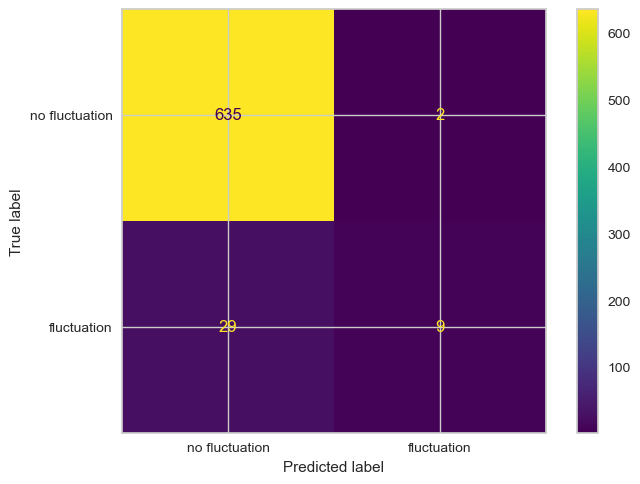

In [55]:
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix(y_pred['true'],y_pred['pred']), display_labels = ['no fluctuation','fluctuation'])
cm_display.plot()
plt.show()

In [63]:
et = ExtraTreesClassifier(class_weight = 'balanced_subsample', random_state=1, n_jobs=-1)

cv = KFold(n_splits=5, shuffle=True, random_state=1)

scores = cross_val_score(et, X_train, y_train, cv=cv, scoring = 'f1')

print(scores)
print(scores.mean())

[0.3255814  0.42857143 0.44444444 0.18181818 0.34146341]
0.3443757729634077


In [64]:
et = ExtraTreesClassifier(class_weight = 'balanced_subsample', random_state=1, n_jobs=-1)

et.fit(X_train,y_train)

y_pred = et.predict(X_test)

y_pred = pd.DataFrame({'pred':y_pred,'true':y_test['fluctuation']})

In [65]:
print(classification_report(y_pred['true'],y_pred['pred']))

              precision    recall  f1-score   support

           0       0.95      1.00      0.97       637
           1       0.78      0.18      0.30        38

    accuracy                           0.95       675
   macro avg       0.87      0.59      0.64       675
weighted avg       0.94      0.95      0.94       675



In [66]:
confusion_matrix(y_pred['true'],y_pred['pred'])

array([[635,   2],
       [ 31,   7]], dtype=int64)

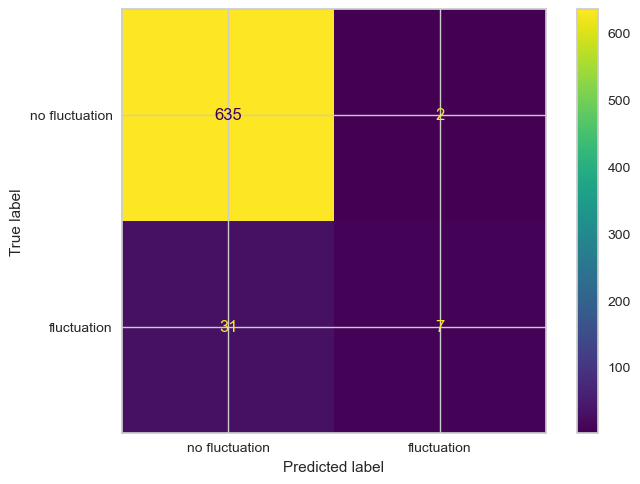

In [67]:
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix(y_pred['true'],y_pred['pred']), display_labels = ['no fluctuation','fluctuation'])
cm_display.plot()
plt.show()

### LGBMClassifier

In [76]:
from lightgbm import LGBMClassifier

In [89]:
lgbm = LGBMClassifier(random_state=1, n_jobs=-1)

cv = KFold(n_splits=5, shuffle=True, random_state=1)

scores = cross_val_score(lgbm, X_train, y_train, cv=cv, scoring = 'f1')

print(scores)
print(scores.mean())

[LightGBM] [Info] Number of positive: 112, number of negative: 2046
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001673 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4987
[LightGBM] [Info] Number of data points in the train set: 2158, number of used features: 28
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.051900 -> initscore=-2.905143
[LightGBM] [Info] Start training from score -2.905143
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 126, number of negative: 2032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002469 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4998
[LightGBM] [Info] Number of data points in the train set: 2158, number of used features: 28
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.058387 -> initscore=-2.780494

In [90]:
lgbm = LGBMClassifier(random_state=1, n_jobs=-1)

lgbm.fit(X_train,y_train)

y_pred = lgbm.predict(X_test)

y_pred = pd.DataFrame({'pred':y_pred,'true':y_test['fluctuation']})

[LightGBM] [Info] Number of positive: 145, number of negative: 2553
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002786 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5083
[LightGBM] [Info] Number of data points in the train set: 2698, number of used features: 28
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.053744 -> initscore=-2.868291
[LightGBM] [Info] Start training from score -2.868291


In [91]:
print(classification_report(y_pred['true'],y_pred['pred']))

              precision    recall  f1-score   support

           0       0.96      0.99      0.98       637
           1       0.75      0.32      0.44        38

    accuracy                           0.96       675
   macro avg       0.86      0.65      0.71       675
weighted avg       0.95      0.96      0.95       675



In [92]:
confusion_matrix(y_pred['true'],y_pred['pred'])

array([[633,   4],
       [ 26,  12]], dtype=int64)

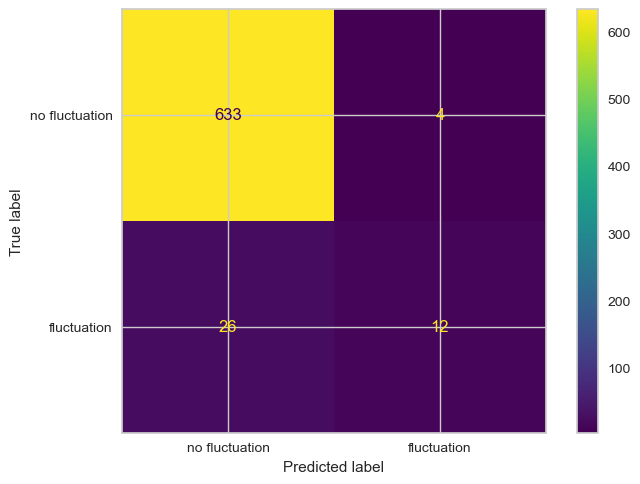

In [93]:
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix(y_pred['true'],y_pred['pred']), display_labels = ['no fluctuation','fluctuation'])
cm_display.plot()
plt.show()

In [94]:
lgbm = LGBMClassifier(class_weight='balanced', random_state=1, n_jobs=-1)

cv = KFold(n_splits=5, shuffle=True, random_state=1)

scores = cross_val_score(lgbm, X_train, y_train, cv=cv, scoring = 'f1')

print(scores)
print(scores.mean())

[LightGBM] [Info] Number of positive: 112, number of negative: 2046
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001672 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4987
[LightGBM] [Info] Number of data points in the train set: 2158, number of used features: 28
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Info] Start training from score 0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 126, number of negative: 2032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001485 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4998
[LightGBM] [Info] Number of data points in the train set: 2158, number of used features: 28
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=-0.000000
[

In [95]:
lgbm = LGBMClassifier(class_weight='balanced', random_state=1, n_jobs=-1)

lgbm.fit(X_train,y_train)

y_pred = lgbm.predict(X_test)

y_pred = pd.DataFrame({'pred':y_pred,'true':y_test['fluctuation']})

[LightGBM] [Info] Number of positive: 145, number of negative: 2553
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001672 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5083
[LightGBM] [Info] Number of data points in the train set: 2698, number of used features: 28
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Info] Start training from score 0.000000


In [96]:
print(classification_report(y_pred['true'],y_pred['pred']))

              precision    recall  f1-score   support

           0       0.97      0.97      0.97       637
           1       0.51      0.50      0.51        38

    accuracy                           0.95       675
   macro avg       0.74      0.74      0.74       675
weighted avg       0.94      0.95      0.94       675



In [97]:
confusion_matrix(y_pred['true'],y_pred['pred'])

array([[619,  18],
       [ 19,  19]], dtype=int64)

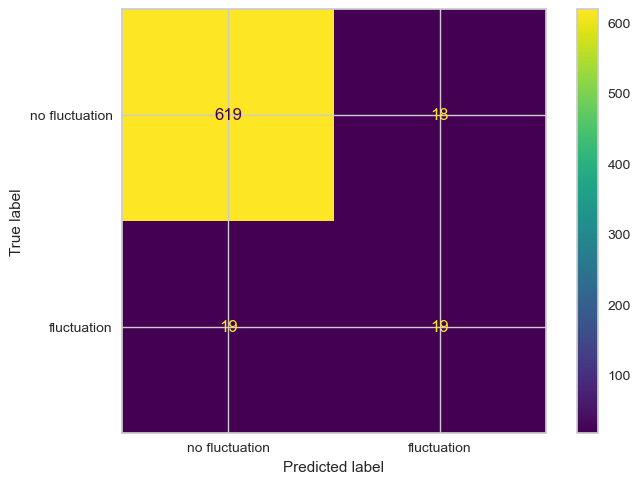

In [98]:
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix(y_pred['true'],y_pred['pred']), display_labels = ['no fluctuation','fluctuation'])
cm_display.plot()
plt.show()

### RnadomForestClassifier

In [99]:
from sklearn.ensemble import RandomForestClassifier

In [100]:
rf = RandomForestClassifier(random_state=1, n_jobs=-1)

cv = KFold(n_splits=5, shuffle=True, random_state=1)

scores = cross_val_score(rf, X_train, y_train, cv=cv, scoring = 'f1')

print(scores)
print(scores.mean())

[0.36363636 0.35714286 0.4        0.17142857 0.3902439 ]
0.33649033892936336


In [101]:
rf = RandomForestClassifier(random_state=1, n_jobs=-1)

rf.fit(X_train,y_train)

y_pred = rf.predict(X_test)

y_pred = pd.DataFrame({'pred':y_pred,'true':y_test['fluctuation']})

In [102]:
print(classification_report(y_pred['true'],y_pred['pred']))

              precision    recall  f1-score   support

           0       0.95      1.00      0.98       637
           1       0.88      0.18      0.30        38

    accuracy                           0.95       675
   macro avg       0.91      0.59      0.64       675
weighted avg       0.95      0.95      0.94       675



In [103]:
confusion_matrix(y_pred['true'],y_pred['pred'])

array([[636,   1],
       [ 31,   7]], dtype=int64)

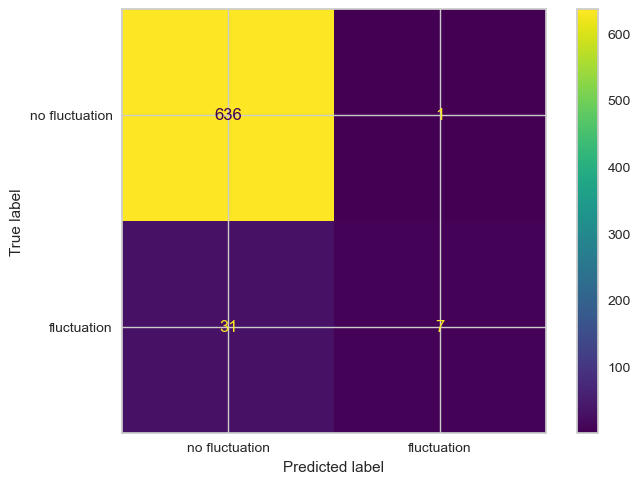

In [104]:
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix(y_pred['true'],y_pred['pred']), display_labels = ['no fluctuation','fluctuation'])
cm_display.plot()
plt.show()

In [105]:
rf = RandomForestClassifier(class_weight = 'balanced', random_state=1, n_jobs=-1)

cv = KFold(n_splits=5, shuffle=True, random_state=1)

scores = cross_val_score(rf, X_train, y_train, cv=cv, scoring = 'f1')

print(scores)
print(scores.mean())

[0.34782609 0.2962963  0.42553191 0.25       0.31578947]
0.3270887543661291


In [106]:
rf = RandomForestClassifier(class_weight = 'balanced', random_state=1, n_jobs=-1)

rf.fit(X_train,y_train)

y_pred = rf.predict(X_test)

y_pred = pd.DataFrame({'pred':y_pred,'true':y_test['fluctuation']})

In [107]:
print(classification_report(y_pred['true'],y_pred['pred']))

              precision    recall  f1-score   support

           0       0.95      1.00      0.97       637
           1       1.00      0.13      0.23        38

    accuracy                           0.95       675
   macro avg       0.98      0.57      0.60       675
weighted avg       0.95      0.95      0.93       675



In [108]:
confusion_matrix(y_pred['true'],y_pred['pred'])

array([[637,   0],
       [ 33,   5]], dtype=int64)

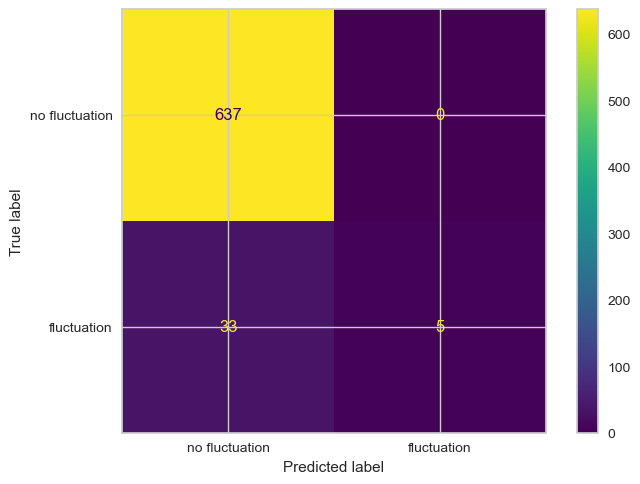

In [109]:
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix(y_pred['true'],y_pred['pred']), display_labels = ['no fluctuation','fluctuation'])
cm_display.plot()
plt.show()

## INVERTER2

In [110]:
dfi = df[df['id']=='inverter2'].copy()
dfi = dfi.drop('id',axis=1)

In [111]:
dfi = dfi.set_index('datetime')
dfi['inverter_moving_average'] = dfi['inverter'].rolling(window=pd.Timedelta(hours=3),center=True).mean()
dfi['inverter_max'] = dfi['inverter'].rolling(window=pd.Timedelta(hours=24),center=True).max()
dfi['inverter_moving_average_max'] = dfi['inverter_moving_average'].rolling(window=pd.Timedelta(hours=24),center=True).max()

dfi['ratio'] = dfi['inverter_max']/dfi['inverter_moving_average_max']
dfi['inverter_moving_average'] = dfi['inverter_moving_average']*dfi['ratio']
dfi['inverter_moving_average'] = dfi.apply(lambda x: 0 if x['inverter']==0 else x['inverter_moving_average'],axis=1)

dfi['difference'] = abs(dfi['inverter_moving_average']-dfi['inverter'])
dfi['difference_max'] = dfi['difference'].rolling(window=pd.Timedelta(hours=12),center=True).max()
dfi['difference__maxx'] = dfi.apply(lambda x: x['difference'] if x['difference']==x['difference_max'] else 0, axis=1)

dfi['fluctuation'] = dfi['difference__maxx']>(dfi['inverter_max']*1/4)
dfi = dfi.reset_index()

fluctuations = dfi[dfi['fluctuation']==1]

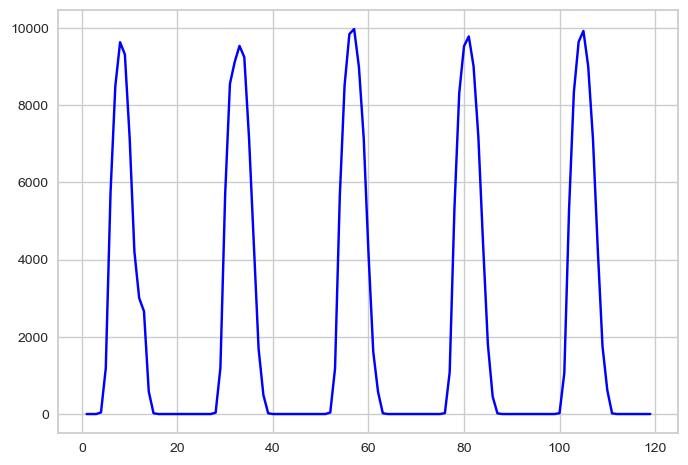

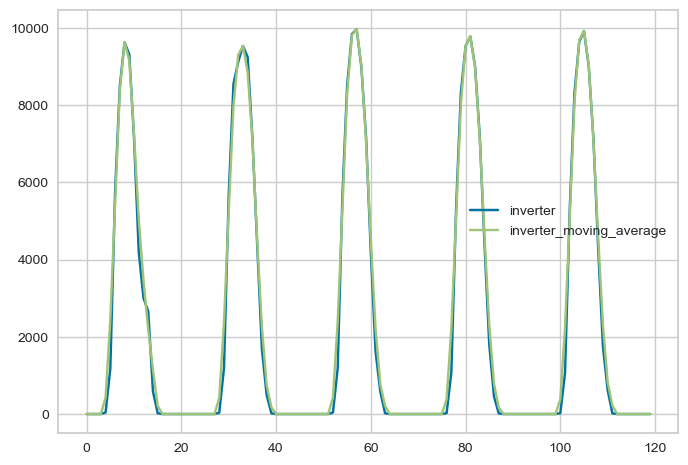

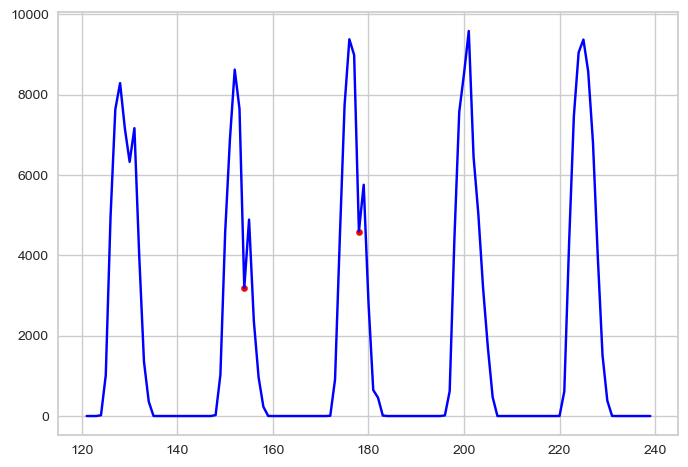

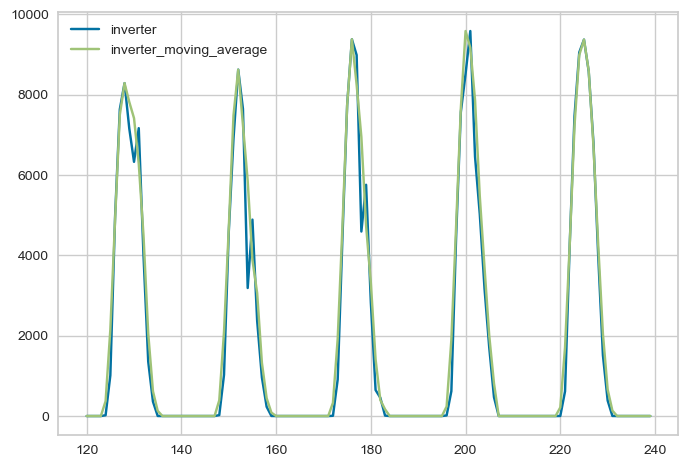

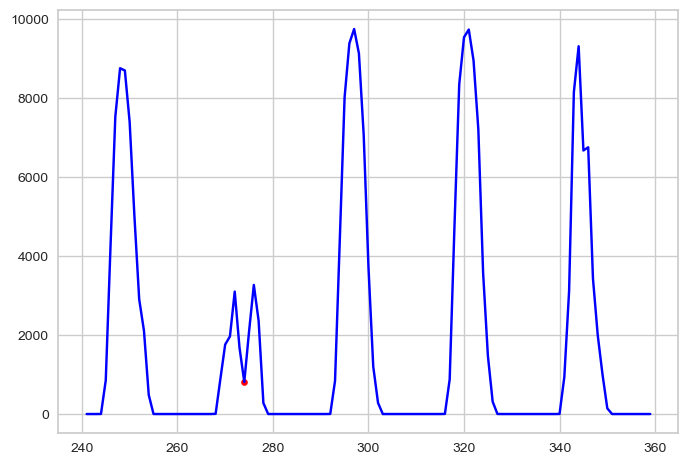

...

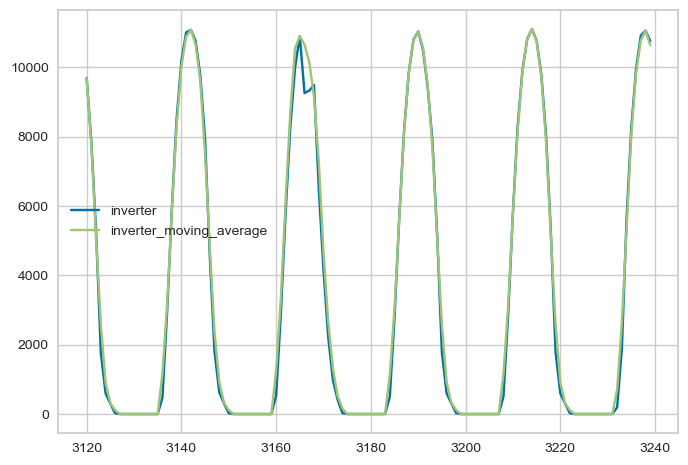

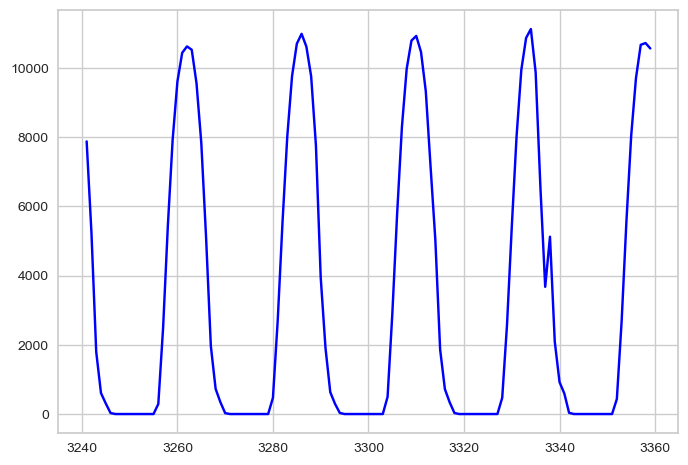

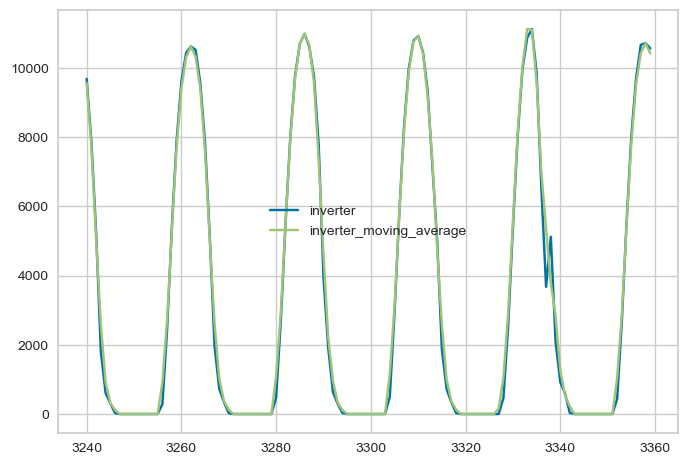

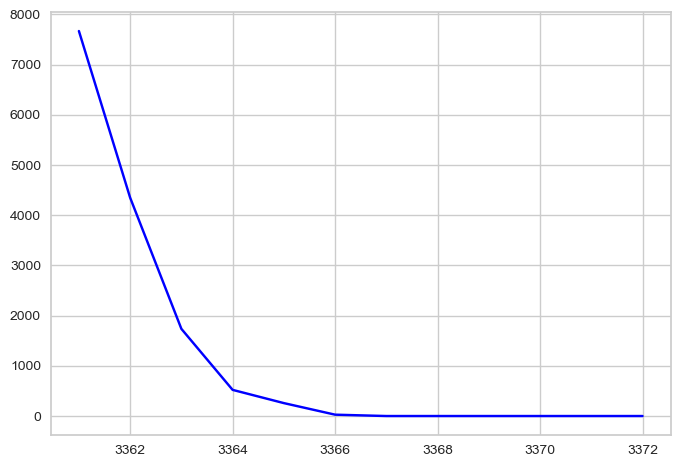

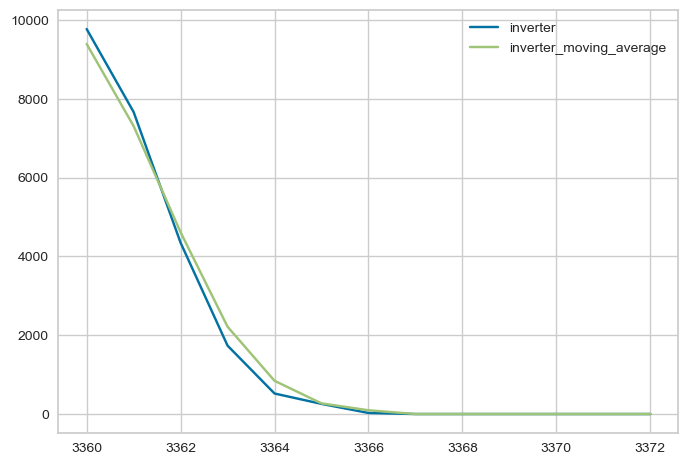

In [112]:
import matplotlib.pyplot as plt

for i in range(0,int(3373/120)+1) :
    x = i*120
    y = (i+1)*120

    plt.plot(dfi.index[(dfi.index>x) & (dfi.index<y)], dfi.inverter[(dfi.index>x) & (dfi.index<y)], color="blue", markersize=4)
    plt.scatter(fluctuations.index[(fluctuations.index>x) & (fluctuations.index<y)], fluctuations.inverter[(fluctuations.index>x) & (fluctuations.index<y)], color="red", s=20)

    plt.show()
    
    dfi[['inverter','inverter_moving_average']][x:y].plot()
    
    plt.show()

In [113]:
dfi.fluctuation.sum()

37

In [114]:
dfi['fluct-1'] = dfi['fluctuation'].shift(-1)
dfi['fluct-2'] = dfi['fluctuation'].shift(-2)
dfi['fluct+1'] = dfi['fluctuation'].shift(1)
dfi['fluct+2'] = dfi['fluctuation'].shift(2)

dfi['fluctuation'] = dfi.apply(lambda x: x['fluct-1'] or x['fluct-2'] or x['fluctuation'] or x['fluct+1'] or x['fluct+2'],axis=1)
dfi['fluctuation'] = dfi['fluctuation'].fillna(False)

In [115]:
dfi.fluctuation.sum()

183

In [116]:
fluctuations = dfi[dfi['fluctuation']==1]

<Axes: xlabel='fluctuation'>

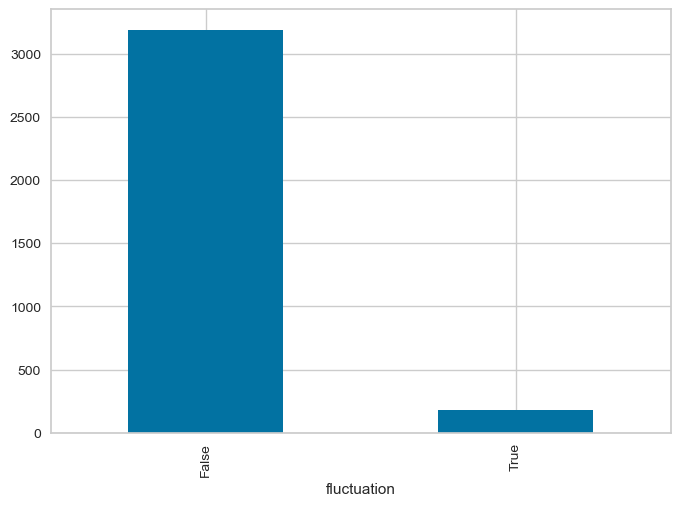

In [117]:
dfi['fluctuation'].value_counts().plot.bar()

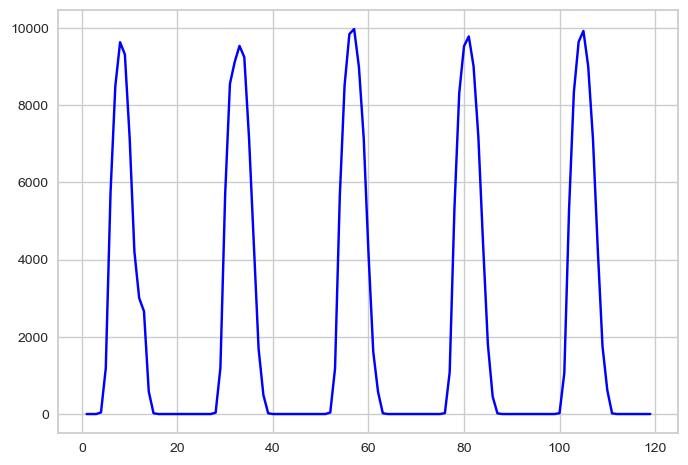

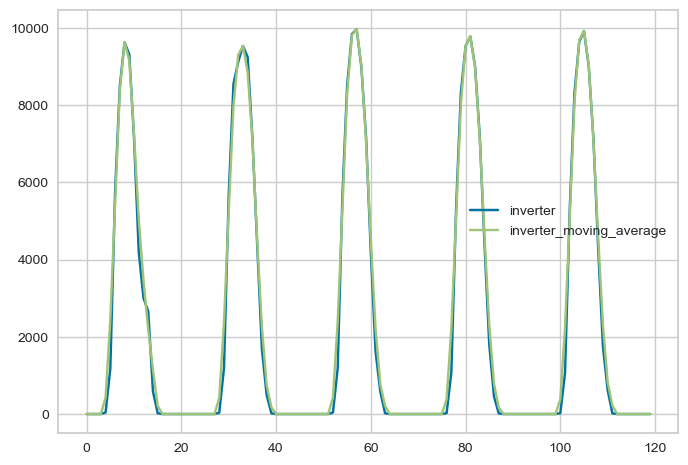

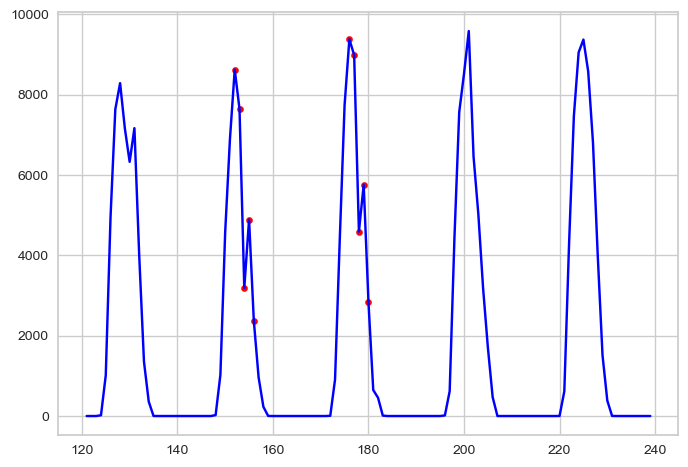

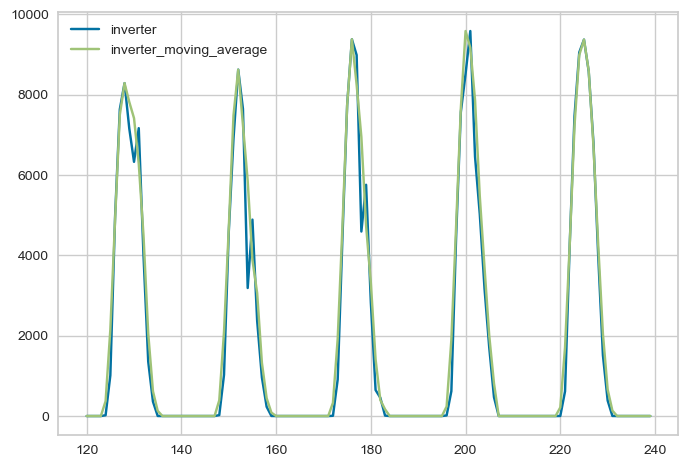

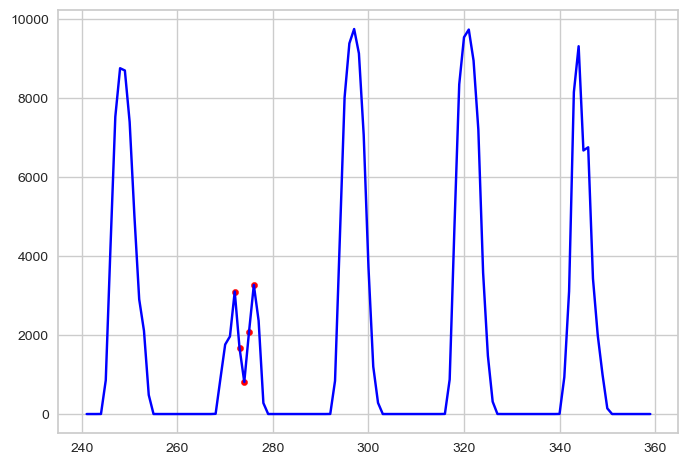

...

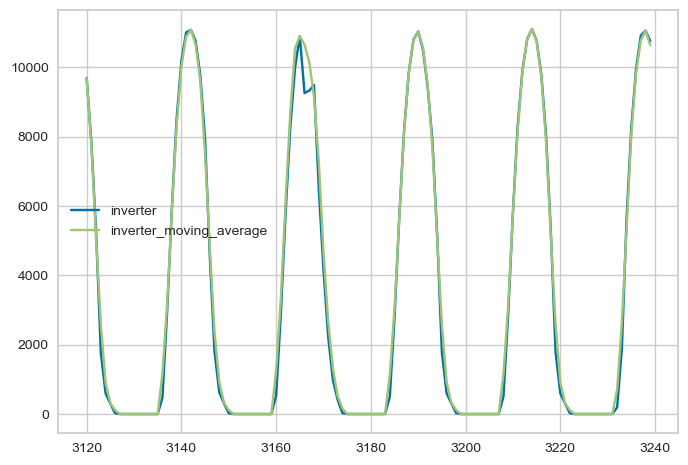

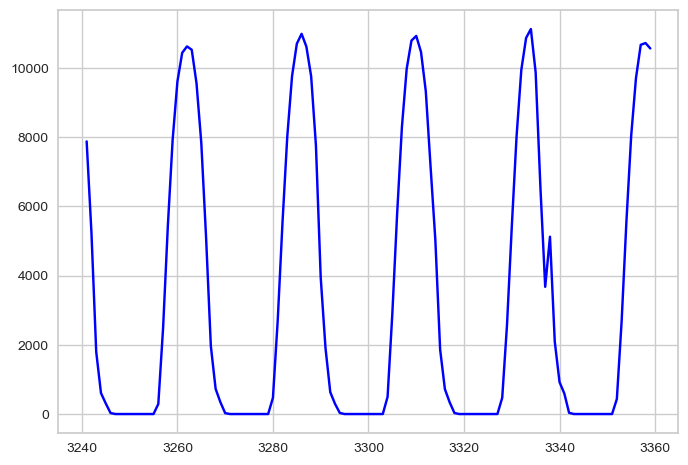

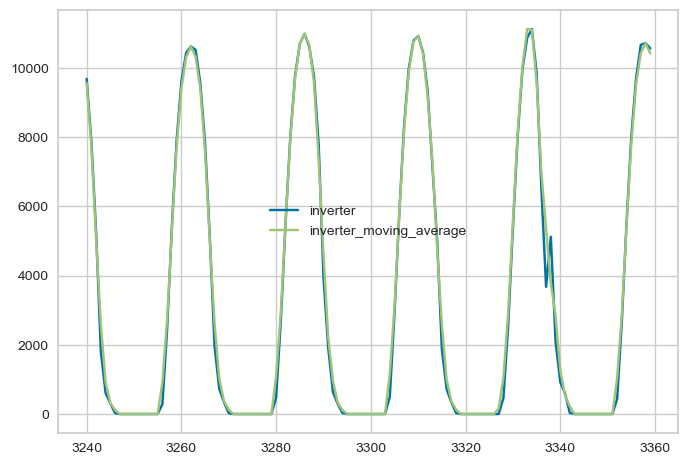

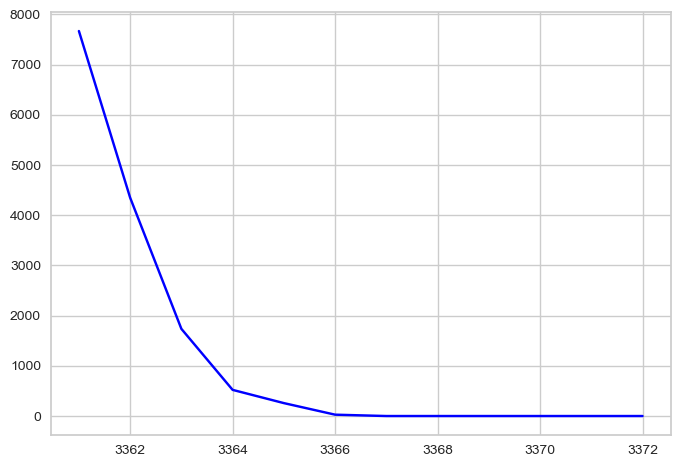

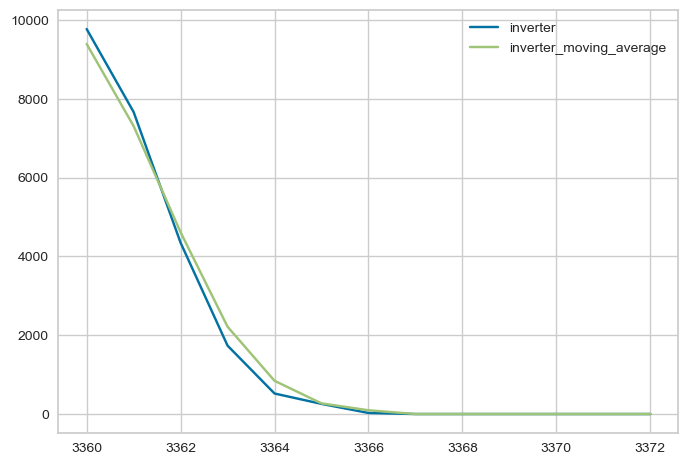

In [118]:
import matplotlib.pyplot as plt

for i in range(0,int(3373/120)+1) :
    x = i*120
    y = (i+1)*120

    plt.plot(dfi.index[(dfi.index>x) & (dfi.index<y)], dfi.inverter[(dfi.index>x) & (dfi.index<y)], color="blue", markersize=4)
    plt.scatter(fluctuations.index[(fluctuations.index>x) & (fluctuations.index<y)], fluctuations.inverter[(fluctuations.index>x) & (fluctuations.index<y)], color="red", s=20)

    plt.show()
    
    dfi[['inverter','inverter_moving_average']][x:y].plot()
    
    plt.show()

In [119]:
dfi.columns

Index(['datetime', 'inverter', 'panel_size', 'temperature_2m',
       'relative_humidity_2m', 'apparent_temperature', 'precipitation', 'rain',
       'cloud_cover', 'cloud_cover_low', 'cloud_cover_mid', 'cloud_cover_high',
       'wind_speed_10m', 'wind_speed_100m', 'wind_gusts_10m', 'is_day',
       'sunshine_duration', 'shortwave_radiation', 'direct_radiation',
       'diffuse_radiation', 'direct_normal_irradiance',
       'terrestrial_radiation', 'shortwave_radiation_instant',
       'direct_radiation_instant', 'diffuse_radiation_instant',
       'direct_normal_irradiance_instant', 'terrestrial_radiation_instant',
       'azimuth', 'zenith', 'month', 'hour', 'energy',
       'inverter_moving_average', 'inverter_max',
       'inverter_moving_average_max', 'ratio', 'difference', 'difference_max',
       'difference__maxx', 'fluctuation', 'fluct-1', 'fluct-2', 'fluct+1',
       'fluct+2'],
      dtype='object')

In [120]:
dfi = dfi.drop(['energy',
       'inverter_moving_average', 'inverter_max',
       'inverter_moving_average_max', 'ratio', 'difference', 'difference_max',
       'difference__maxx', 'fluct-1', 'fluct-2', 'fluct+1',
       'fluct+2','panel_size','inverter'],axis=1)

dfi['fluctuation'] = dfi['fluctuation'].astype(int)

In [121]:
dfi.columns

Index(['datetime', 'temperature_2m', 'relative_humidity_2m',
       'apparent_temperature', 'precipitation', 'rain', 'cloud_cover',
       'cloud_cover_low', 'cloud_cover_mid', 'cloud_cover_high',
       'wind_speed_10m', 'wind_speed_100m', 'wind_gusts_10m', 'is_day',
       'sunshine_duration', 'shortwave_radiation', 'direct_radiation',
       'diffuse_radiation', 'direct_normal_irradiance',
       'terrestrial_radiation', 'shortwave_radiation_instant',
       'direct_radiation_instant', 'diffuse_radiation_instant',
       'direct_normal_irradiance_instant', 'terrestrial_radiation_instant',
       'azimuth', 'zenith', 'month', 'hour', 'fluctuation'],
      dtype='object')

In [122]:
data_train, data_test = train_test_split(dfi, test_size=0.2, random_state=1)
data_test = data_test.sort_values('datetime')

data_train = data_train.drop('datetime',axis=1)
data_test = data_test.drop('datetime',axis=1)

### pycaret

In [123]:
s = setup(data = data_train, target = 'fluctuation', session_id = 1, fold = 5)

,Description,Value
0,Session id,1
1,Target,fluctuation
2,Target type,Binary
3,Original data shape,"(2698, 29)"
4,Transformed data shape,"(2698, 29)"
5,Transformed train set shape,"(1888, 29)"
6,Transformed test set shape,"(810, 29)"
7,Numeric features,28
8,Preprocess,True
9,Imputation type,simple


In [124]:
best3 = s.compare_models(n_select = 3, sort='F1') #include = ['et', 'rf', 'lightgbm', 'xgboost', 'lda', 'ridge', 'dt', 'knn', 'gbc', 'ada', 'catboost', 'lr']

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
lightgbm,Light Gradient Boosting Machine,0.9497,0.9325,0.2748,0.5999,0.3722,0.3496,0.3811,0.4800
xgboost,Extreme Gradient Boosting,0.9476,0.9355,0.2748,0.5615,0.3578,0.3341,0.3629,0.1780
lda,Linear Discriminant Analysis,0.9354,0.8978,0.3133,0.3777,0.3393,0.3061,0.3091,0.0260
gbc,Gradient Boosting Classifier,0.9481,0.9208,0.2267,0.5424,0.3169,0.2952,0.3269,0.6300
dt,Decision Tree Classifier,0.9237,0.6308,0.3024,0.3192,0.3018,0.2621,0.2666,0.0320
ada,Ada Boost Classifier,0.9375,0.8911,0.2448,0.3845,0.2977,0.2668,0.2749,0.2020
et,Extra Trees Classifier,0.9470,0.9307,0.1962,0.6233,0.2847,0.2640,0.3179,0.1620
rf,Random Forest Classifier,0.9497,0.9299,0.1867,0.7000,0.2835,0.2659,0.3346,0.3180
nb,Naive Bayes,0.7505,0.8672,0.8824,0.1654,0.2782,0.2059,0.3127,2.0220
knn,K Neighbors Classifier,0.9428,0.7622,0.1567,0.4989,0.2297,0.2068,0.2484,2.9300


### pycaret - SMOTEENN

In [125]:
from imblearn.combine import SMOTEENN

sme = SMOTEENN(sampling_strategy='all', random_state=1, n_jobs=-1)

In [126]:
X = data_train.drop('fluctuation',axis=1)
y = data_train[['fluctuation']]

In [127]:
X_res, y_res = sme.fit_resample(X, y)

<Axes: xlabel='fluctuation'>

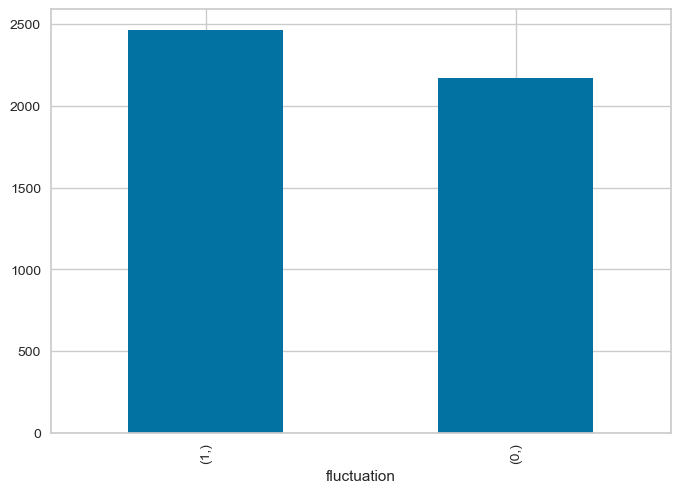

In [128]:
y_res.value_counts().plot.bar()

In [129]:
data_train = X_res.copy()
data_train['fluctuation'] = y_res

In [130]:
s = setup(data = data_train, target = 'fluctuation', session_id = 1, fold = 10)

,Description,Value
0,Session id,1
1,Target,fluctuation
2,Target type,Binary
3,Original data shape,"(4637, 29)"
4,Transformed data shape,"(4637, 29)"
5,Transformed train set shape,"(3245, 29)"
6,Transformed test set shape,"(1392, 29)"
7,Numeric features,28
8,Preprocess,True
9,Imputation type,simple


In [131]:
best3 = s.compare_models(n_select = 3, sort='F1') 

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
et,Extra Trees Classifier,0.9852,0.9996,0.9971,0.9757,0.9863,0.9702,0.9706,0.2190
lightgbm,Light Gradient Boosting Machine,0.9852,0.9984,0.9960,0.9769,0.9863,0.9702,0.9706,0.5740
xgboost,Extreme Gradient Boosting,0.9827,0.9980,0.9942,0.9741,0.9840,0.9653,0.9656,0.2000
rf,Random Forest Classifier,0.9803,0.9984,0.9890,0.9745,0.9816,0.9603,0.9605,0.6630
knn,K Neighbors Classifier,0.9766,0.9953,0.9954,0.9621,0.9784,0.9528,0.9536,0.1320
gbc,Gradient Boosting Classifier,0.9732,0.9955,0.9855,0.9651,0.9751,0.9461,0.9465,1.6130
dt,Decision Tree Classifier,0.9726,0.9721,0.9792,0.9698,0.9744,0.9449,0.9451,0.0760
ada,Ada Boost Classifier,0.9673,0.9937,0.9820,0.9579,0.9697,0.9343,0.9348,0.3440
lr,Logistic Regression,0.9473,0.9790,0.9780,0.9274,0.9519,0.8937,0.8956,0.1980
ridge,Ridge Classifier,0.9149,0.0000,0.9803,0.8753,0.9247,0.8277,0.8350,0.0240


In [132]:
predict_model(best3[0],data_test)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Extra Trees Classifier,0.8681,0.8999,0.7568,0.2593,0.3862,0.3316,0.3920


,temperature_2m,relative_humidity_2m,apparent_temperature,precipitation,rain,cloud_cover,cloud_cover_low,cloud_cover_mid,cloud_cover_high,wind_speed_10m,...,diffuse_radiation_instant,direct_normal_irradiance_instant,terrestrial_radiation_instant,azimuth,zenith,month,hour,fluctuation,prediction_label,prediction_score
3,16.108000,89.370384,16.999006,0.0,0.0,5.700000,0.0,0.0,19.0,3.706427,...,0.000000,0.000000,0.000000,98.224670,104.536469,11,3,0,0,1.00
4,15.558001,87.033760,16.109491,0.0,0.0,0.000000,0.0,0.0,0.0,3.706427,...,0.000000,0.000000,0.000000,106.508156,92.468445,11,4,0,0,1.00
6,21.458000,55.240314,21.177088,0.0,0.0,0.000000,0.0,0.0,0.0,6.409617,...,90.817406,482.204742,461.024963,125.681030,70.558144,11,6,0,0,0.86
7,23.858000,53.366432,24.076742,0.0,0.0,3.000000,3.0,0.0,1.0,6.924738,...,105.385185,655.079834,663.350281,138.007629,61.436432,11,7,0,0,0.68
10,28.257999,35.032356,28.253460,0.0,0.0,32.700001,1.0,3.0,100.0,5.116561,...,120.144188,754.419495,879.966187,189.398972,50.678322,11,10,0,0,0.56
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3347,24.808001,84.455307,28.627396,0.0,0.0,0.000000,0.0,0.0,0.0,7.594207,...,0.000000,0.000000,0.000000,2.672956,121.631645,6,22,0,0,1.00
3351,24.058001,90.237267,28.688232,0.0,0.0,4.500000,5.0,0.0,0.0,3.396233,...,0.000000,0.000000,0.000000,55.226421,96.913406,6,2,0,0,1.00
3357,33.708000,29.083176,34.158760,0.0,0.0,0.000000,0.0,0.0,0.0,13.441071,...,142.423309,796.412048,1181.411499,109.222427,26.760262,6,8,0,0,0.96
3369,27.908001,63.170002,29.901440,0.0,0.0,0.000000,0.0,0.0,0.0,13.679999,...,0.000000,0.000000,0.000000,331.687134,116.142097,6,20,0,0,1.00


In [133]:
predict_model(best3[1],data_test)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Light Gradient Boosting Machine,0.8667,0.8997,0.6757,0.2427,0.3571,0.3007,0.3503


,temperature_2m,relative_humidity_2m,apparent_temperature,precipitation,rain,cloud_cover,cloud_cover_low,cloud_cover_mid,cloud_cover_high,wind_speed_10m,...,diffuse_radiation_instant,direct_normal_irradiance_instant,terrestrial_radiation_instant,azimuth,zenith,month,hour,fluctuation,prediction_label,prediction_score
3,16.108000,89.370384,16.999006,0.0,0.0,5.700000,0.0,0.0,19.0,3.706427,...,0.000000,0.000000,0.000000,98.224670,104.536469,11,3,0,0,1.0000
4,15.558001,87.033760,16.109491,0.0,0.0,0.000000,0.0,0.0,0.0,3.706427,...,0.000000,0.000000,0.000000,106.508156,92.468445,11,4,0,0,1.0000
6,21.458000,55.240314,21.177088,0.0,0.0,0.000000,0.0,0.0,0.0,6.409617,...,90.817406,482.204742,461.024963,125.681030,70.558144,11,6,0,0,0.9996
7,23.858000,53.366432,24.076742,0.0,0.0,3.000000,3.0,0.0,1.0,6.924738,...,105.385185,655.079834,663.350281,138.007629,61.436432,11,7,0,0,0.6819
10,28.257999,35.032356,28.253460,0.0,0.0,32.700001,1.0,3.0,100.0,5.116561,...,120.144188,754.419495,879.966187,189.398972,50.678322,11,10,0,1,0.9871
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3347,24.808001,84.455307,28.627396,0.0,0.0,0.000000,0.0,0.0,0.0,7.594207,...,0.000000,0.000000,0.000000,2.672956,121.631645,6,22,0,0,1.0000
3351,24.058001,90.237267,28.688232,0.0,0.0,4.500000,5.0,0.0,0.0,3.396233,...,0.000000,0.000000,0.000000,55.226421,96.913406,6,2,0,0,1.0000
3357,33.708000,29.083176,34.158760,0.0,0.0,0.000000,0.0,0.0,0.0,13.441071,...,142.423309,796.412048,1181.411499,109.222427,26.760262,6,8,0,0,0.9999
3369,27.908001,63.170002,29.901440,0.0,0.0,0.000000,0.0,0.0,0.0,13.679999,...,0.000000,0.000000,0.000000,331.687134,116.142097,6,20,0,0,1.0000


In [134]:
predict_model(best3[2],data_test)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Extreme Gradient Boosting,0.8711,0.8974,0.6757,0.2500,0.3650,0.3097,0.3576


,temperature_2m,relative_humidity_2m,apparent_temperature,precipitation,rain,cloud_cover,cloud_cover_low,cloud_cover_mid,cloud_cover_high,wind_speed_10m,...,diffuse_radiation_instant,direct_normal_irradiance_instant,terrestrial_radiation_instant,azimuth,zenith,month,hour,fluctuation,prediction_label,prediction_score
3,16.108000,89.370384,16.999006,0.0,0.0,5.700000,0.0,0.0,19.0,3.706427,...,0.000000,0.000000,0.000000,98.224670,104.536469,11,3,0,0,1.0000
4,15.558001,87.033760,16.109491,0.0,0.0,0.000000,0.0,0.0,0.0,3.706427,...,0.000000,0.000000,0.000000,106.508156,92.468445,11,4,0,0,1.0000
6,21.458000,55.240314,21.177088,0.0,0.0,0.000000,0.0,0.0,0.0,6.409617,...,90.817406,482.204742,461.024963,125.681030,70.558144,11,6,0,0,0.9992
7,23.858000,53.366432,24.076742,0.0,0.0,3.000000,3.0,0.0,1.0,6.924738,...,105.385185,655.079834,663.350281,138.007629,61.436432,11,7,0,0,0.5501
10,28.257999,35.032356,28.253460,0.0,0.0,32.700001,1.0,3.0,100.0,5.116561,...,120.144188,754.419495,879.966187,189.398972,50.678322,11,10,0,1,0.9952
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3347,24.808001,84.455307,28.627396,0.0,0.0,0.000000,0.0,0.0,0.0,7.594207,...,0.000000,0.000000,0.000000,2.672956,121.631645,6,22,0,0,1.0000
3351,24.058001,90.237267,28.688232,0.0,0.0,4.500000,5.0,0.0,0.0,3.396233,...,0.000000,0.000000,0.000000,55.226421,96.913406,6,2,0,0,0.9998
3357,33.708000,29.083176,34.158760,0.0,0.0,0.000000,0.0,0.0,0.0,13.441071,...,142.423309,796.412048,1181.411499,109.222427,26.760262,6,8,0,0,0.9999
3369,27.908001,63.170002,29.901440,0.0,0.0,0.000000,0.0,0.0,0.0,13.679999,...,0.000000,0.000000,0.000000,331.687134,116.142097,6,20,0,0,1.0000


### ExtraTreesClassifier

In [135]:
from sklearn.ensemble import ExtraTreesClassifier

from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score

from sklearn import metrics
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix

In [136]:
dfi = df[df['id']=='inverter2'].copy()
dfi = dfi.drop('id',axis=1)

dfi = dfi.set_index('datetime')
dfi['inverter_moving_average'] = dfi['inverter'].rolling(window=pd.Timedelta(hours=3),center=True).mean()
dfi['inverter_max'] = dfi['inverter'].rolling(window=pd.Timedelta(hours=24),center=True).max()
dfi['inverter_moving_average_max'] = dfi['inverter_moving_average'].rolling(window=pd.Timedelta(hours=24),center=True).max()

dfi['ratio'] = dfi['inverter_max']/dfi['inverter_moving_average_max']
dfi['inverter_moving_average'] = dfi['inverter_moving_average']*dfi['ratio']
dfi['inverter_moving_average'] = dfi.apply(lambda x: 0 if x['inverter']==0 else x['inverter_moving_average'],axis=1)

dfi['difference'] = abs(dfi['inverter_moving_average']-dfi['inverter'])
dfi['difference_max'] = dfi['difference'].rolling(window=pd.Timedelta(hours=12),center=True).max()
dfi['difference__maxx'] = dfi.apply(lambda x: x['difference'] if x['difference']==x['difference_max'] else 0, axis=1)

dfi['fluctuation'] = dfi['difference__maxx']>(dfi['inverter_max']*1/4)
dfi = dfi.reset_index()

dfi['fluct-1'] = dfi['fluctuation'].shift(-1)
dfi['fluct-2'] = dfi['fluctuation'].shift(-2)
dfi['fluct+1'] = dfi['fluctuation'].shift(1)
dfi['fluct+2'] = dfi['fluctuation'].shift(2)

dfi['fluctuation'] = dfi.apply(lambda x: x['fluct-1'] or x['fluct-2'] or x['fluctuation'] or x['fluct+1'] or x['fluct+2'],axis=1)
dfi['fluctuation'] = dfi['fluctuation'].fillna(False)

dfi = dfi.drop(['energy',
       'inverter_moving_average', 'inverter_max',
       'inverter_moving_average_max', 'ratio', 'difference', 'difference_max',
       'difference__maxx', 'fluct-1', 'fluct-2', 'fluct+1',
       'fluct+2','panel_size','inverter'],axis=1)

dfi['fluctuation'] = dfi['fluctuation'].astype(int)

data_train, data_test = train_test_split(dfi, test_size=0.2, random_state=1)
data_test = data_test.sort_values('datetime')

data_train = data_train.drop('datetime',axis=1)
data_test = data_test.drop('datetime',axis=1)

X_train = data_train.drop('fluctuation',axis=1)
y_train = data_train[['fluctuation']]

X_test = data_test.drop('fluctuation',axis=1)
y_test = data_test[['fluctuation']]

In [137]:
et = ExtraTreesClassifier(random_state=1, n_jobs=-1)

cv = KFold(n_splits=5, shuffle=True, random_state=1)

scores = cross_val_score(et, X_train, y_train, cv=cv, scoring = 'f1')

print(scores)
print(scores.mean())

[0.26666667 0.46666667 0.40816327 0.27027027 0.32432432]
0.34721823864681006


In [138]:
et = ExtraTreesClassifier(random_state=1, n_jobs=-1)

et.fit(X_train,y_train)

y_pred = et.predict(X_test)

y_pred = pd.DataFrame({'pred':y_pred,'true':y_test['fluctuation']})

In [139]:
print(classification_report(y_pred['true'],y_pred['pred']))

              precision    recall  f1-score   support

           0       0.95      1.00      0.97       638
           1       0.57      0.11      0.18        37

    accuracy                           0.95       675
   macro avg       0.76      0.55      0.58       675
weighted avg       0.93      0.95      0.93       675



In [140]:
confusion_matrix(y_pred['true'],y_pred['pred'])

array([[635,   3],
       [ 33,   4]], dtype=int64)

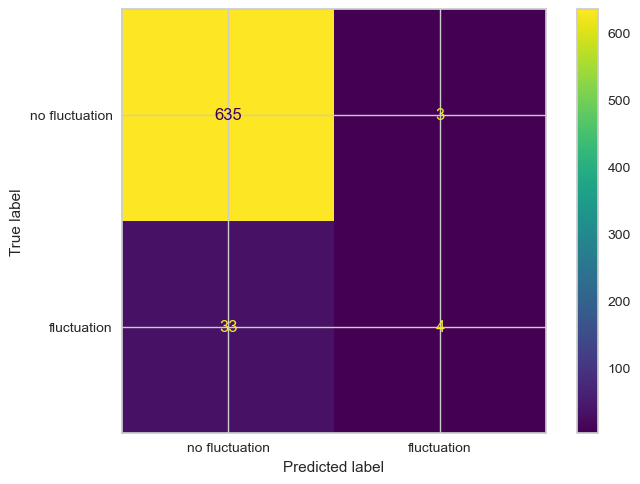

In [141]:
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix(y_pred['true'],y_pred['pred']), display_labels = ['no fluctuation','fluctuation'])
cm_display.plot()
plt.show()

In [142]:
et = ExtraTreesClassifier(class_weight = 'balanced_subsample', random_state=1, n_jobs=-1)

cv = KFold(n_splits=5, shuffle=True, random_state=1)

scores = cross_val_score(et, X_train, y_train, cv=cv, scoring = 'f1')

print(scores)
print(scores.mean())

[0.23809524 0.4137931  0.26666667 0.24242424 0.25      ]
0.2821958501268846


In [143]:
et = ExtraTreesClassifier(class_weight = 'balanced_subsample', random_state=1, n_jobs=-1)

et.fit(X_train,y_train)

y_pred = et.predict(X_test)

y_pred = pd.DataFrame({'pred':y_pred,'true':y_test['fluctuation']})

In [144]:
print(classification_report(y_pred['true'],y_pred['pred']))

              precision    recall  f1-score   support

           0       0.95      1.00      0.97       638
           1       0.50      0.08      0.14        37

    accuracy                           0.95       675
   macro avg       0.72      0.54      0.56       675
weighted avg       0.92      0.95      0.93       675



In [145]:
confusion_matrix(y_pred['true'],y_pred['pred'])

array([[635,   3],
       [ 34,   3]], dtype=int64)

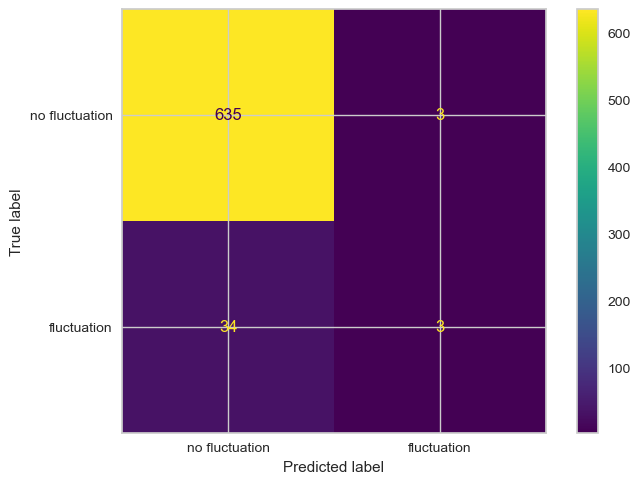

In [146]:
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix(y_pred['true'],y_pred['pred']), display_labels = ['no fluctuation','fluctuation'])
cm_display.plot()
plt.show()

### LGBMClassifier

In [147]:
from lightgbm import LGBMClassifier

In [148]:
lgbm = LGBMClassifier(random_state=1, n_jobs=-1)

cv = KFold(n_splits=5, shuffle=True, random_state=1)

scores = cross_val_score(lgbm, X_train, y_train, cv=cv, scoring = 'f1')

print(scores)
print(scores.mean())

[LightGBM] [Info] Number of positive: 109, number of negative: 2049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000788 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4987
[LightGBM] [Info] Number of data points in the train set: 2158, number of used features: 28
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.050510 -> initscore=-2.933759
[LightGBM] [Info] Start training from score -2.933759
[LightGBM] [Info] Number of positive: 126, number of negative: 2032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000546 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4998
[LightGBM] [Info] Number of data points in the train set: 2158, number of used features: 28
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.058387 -> initscore=-2.780494
[LightGBM] [Info] Start training from score -2.780494
[LightGBM] [Info] Nu

In [149]:
lgbm = LGBMClassifier(random_state=1, n_jobs=-1)

lgbm.fit(X_train,y_train)

y_pred = lgbm.predict(X_test)

y_pred = pd.DataFrame({'pred':y_pred,'true':y_test['fluctuation']})

[LightGBM] [Info] Number of positive: 146, number of negative: 2552
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001181 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5083
[LightGBM] [Info] Number of data points in the train set: 2698, number of used features: 28
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.054114 -> initscore=-2.861026
[LightGBM] [Info] Start training from score -2.861026


In [150]:
print(classification_report(y_pred['true'],y_pred['pred']))

              precision    recall  f1-score   support

           0       0.96      0.99      0.98       638
           1       0.73      0.30      0.42        37

    accuracy                           0.96       675
   macro avg       0.85      0.65      0.70       675
weighted avg       0.95      0.96      0.95       675



In [151]:
confusion_matrix(y_pred['true'],y_pred['pred'])

array([[634,   4],
       [ 26,  11]], dtype=int64)

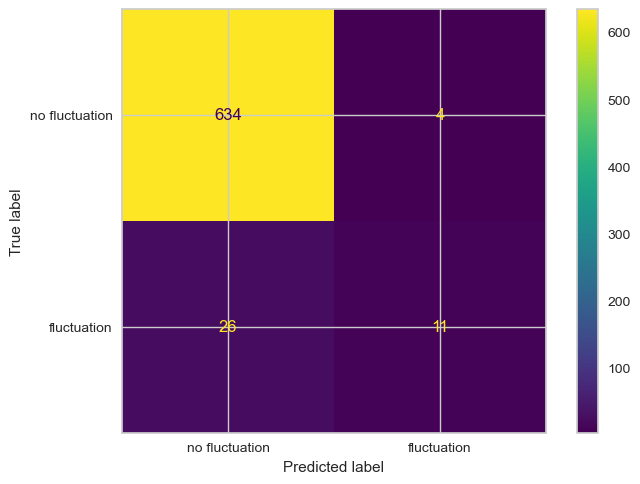

In [152]:
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix(y_pred['true'],y_pred['pred']), display_labels = ['no fluctuation','fluctuation'])
cm_display.plot()
plt.show()

In [153]:
lgbm = LGBMClassifier(class_weight='balanced', random_state=1, n_jobs=-1)

cv = KFold(n_splits=5, shuffle=True, random_state=1)

scores = cross_val_score(lgbm, X_train, y_train, cv=cv, scoring = 'f1')

print(scores)
print(scores.mean())

[LightGBM] [Info] Number of positive: 109, number of negative: 2049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000944 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4987
[LightGBM] [Info] Number of data points in the train set: 2158, number of used features: 28
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=-0.000000
[LightGBM] [Info] Start training from score -0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 126, number of negative: 2032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001706 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4998
[LightGBM] [Info] Number of data points in the train set: 2158, number of used features: 28
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=-0.000000

In [154]:
lgbm = LGBMClassifier(class_weight='balanced', random_state=1, n_jobs=-1)

lgbm.fit(X_train,y_train)

y_pred = lgbm.predict(X_test)

y_pred = pd.DataFrame({'pred':y_pred,'true':y_test['fluctuation']})

[LightGBM] [Info] Number of positive: 146, number of negative: 2552
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001453 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5083
[LightGBM] [Info] Number of data points in the train set: 2698, number of used features: 28
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=-0.000000
[LightGBM] [Info] Start training from score -0.000000


In [155]:
print(classification_report(y_pred['true'],y_pred['pred']))

              precision    recall  f1-score   support

           0       0.97      0.97      0.97       638
           1       0.50      0.43      0.46        37

    accuracy                           0.95       675
   macro avg       0.73      0.70      0.72       675
weighted avg       0.94      0.95      0.94       675



In [156]:
confusion_matrix(y_pred['true'],y_pred['pred'])

array([[622,  16],
       [ 21,  16]], dtype=int64)

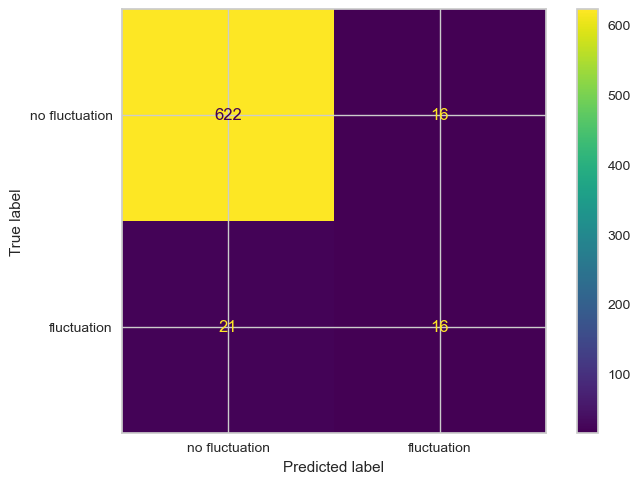

In [157]:
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix(y_pred['true'],y_pred['pred']), display_labels = ['no fluctuation','fluctuation'])
cm_display.plot()
plt.show()

### RnadomForestClassifier

In [158]:
from sklearn.ensemble import RandomForestClassifier

In [159]:
rf = RandomForestClassifier(random_state=1, n_jobs=-1)

cv = KFold(n_splits=5, shuffle=True, random_state=1)

scores = cross_val_score(rf, X_train, y_train, cv=cv, scoring = 'f1')

print(scores)
print(scores.mean())

[0.30434783 0.42857143 0.36734694 0.1875     0.34285714]
0.3261246672582076


In [160]:
rf = RandomForestClassifier(random_state=1, n_jobs=-1)

rf.fit(X_train,y_train)

y_pred = rf.predict(X_test)

y_pred = pd.DataFrame({'pred':y_pred,'true':y_test['fluctuation']})

In [161]:
print(classification_report(y_pred['true'],y_pred['pred']))

              precision    recall  f1-score   support

           0       0.95      1.00      0.97       638
           1       0.83      0.14      0.23        37

    accuracy                           0.95       675
   macro avg       0.89      0.57      0.60       675
weighted avg       0.95      0.95      0.93       675



In [162]:
confusion_matrix(y_pred['true'],y_pred['pred'])

array([[637,   1],
       [ 32,   5]], dtype=int64)

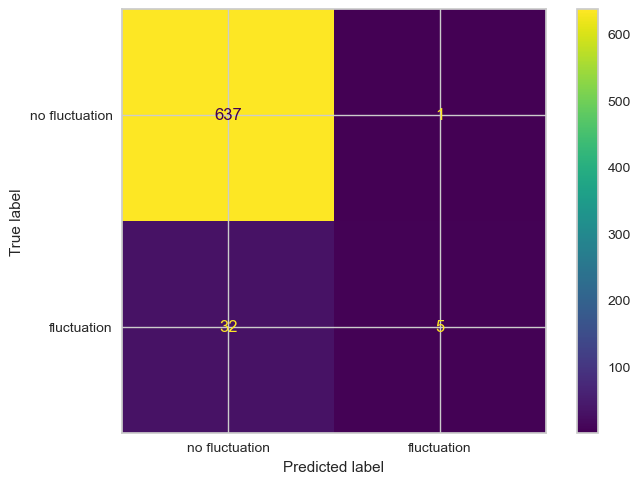

In [163]:
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix(y_pred['true'],y_pred['pred']), display_labels = ['no fluctuation','fluctuation'])
cm_display.plot()
plt.show()

In [164]:
rf = RandomForestClassifier(class_weight = 'balanced', random_state=1, n_jobs=-1)

cv = KFold(n_splits=5, shuffle=True, random_state=1)

scores = cross_val_score(rf, X_train, y_train, cv=cv, scoring = 'f1')

print(scores)
print(scores.mean())

[0.25531915 0.38461538 0.26666667 0.24242424 0.25      ]
0.2798050885284928


In [165]:
rf = RandomForestClassifier(class_weight = 'balanced', random_state=1, n_jobs=-1)

rf.fit(X_train,y_train)

y_pred = rf.predict(X_test)

y_pred = pd.DataFrame({'pred':y_pred,'true':y_test['fluctuation']})

In [166]:
print(classification_report(y_pred['true'],y_pred['pred']))

              precision    recall  f1-score   support

           0       0.95      1.00      0.97       638
           1       0.67      0.11      0.19        37

    accuracy                           0.95       675
   macro avg       0.81      0.55      0.58       675
weighted avg       0.94      0.95      0.93       675



In [167]:
confusion_matrix(y_pred['true'],y_pred['pred'])

array([[636,   2],
       [ 33,   4]], dtype=int64)

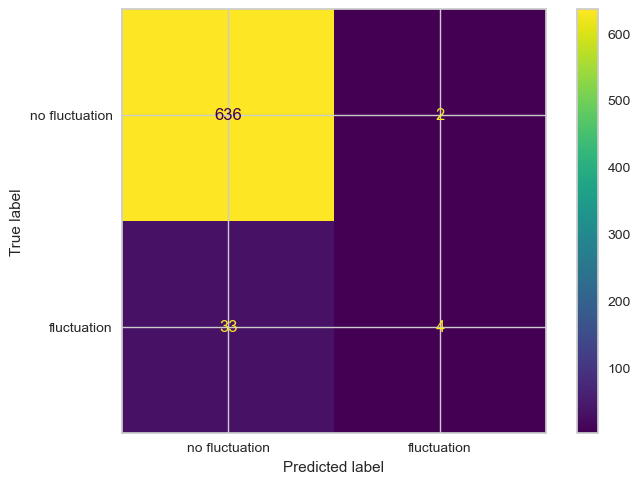

In [168]:
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix(y_pred['true'],y_pred['pred']), display_labels = ['no fluctuation','fluctuation'])
cm_display.plot()
plt.show()

## INVERTER3

In [169]:
dfi = df[df['id']=='inverter3'].copy()
dfi = dfi.drop('id',axis=1)

In [170]:
dfi = dfi.set_index('datetime')
dfi['inverter_moving_average'] = dfi['inverter'].rolling(window=pd.Timedelta(hours=3),center=True).mean()
dfi['inverter_max'] = dfi['inverter'].rolling(window=pd.Timedelta(hours=24),center=True).max()
dfi['inverter_moving_average_max'] = dfi['inverter_moving_average'].rolling(window=pd.Timedelta(hours=24),center=True).max()

dfi['ratio'] = dfi['inverter_max']/dfi['inverter_moving_average_max']
dfi['inverter_moving_average'] = dfi['inverter_moving_average']*dfi['ratio']
dfi['inverter_moving_average'] = dfi.apply(lambda x: 0 if x['inverter']==0 else x['inverter_moving_average'],axis=1)

dfi['difference'] = abs(dfi['inverter_moving_average']-dfi['inverter'])
dfi['difference_max'] = dfi['difference'].rolling(window=pd.Timedelta(hours=12),center=True).max()
dfi['difference__maxx'] = dfi.apply(lambda x: x['difference'] if x['difference']==x['difference_max'] else 0, axis=1)

dfi['fluctuation'] = dfi['difference__maxx']>(dfi['inverter_max']*1/4)
dfi = dfi.reset_index()

fluctuations = dfi[dfi['fluctuation']==1]

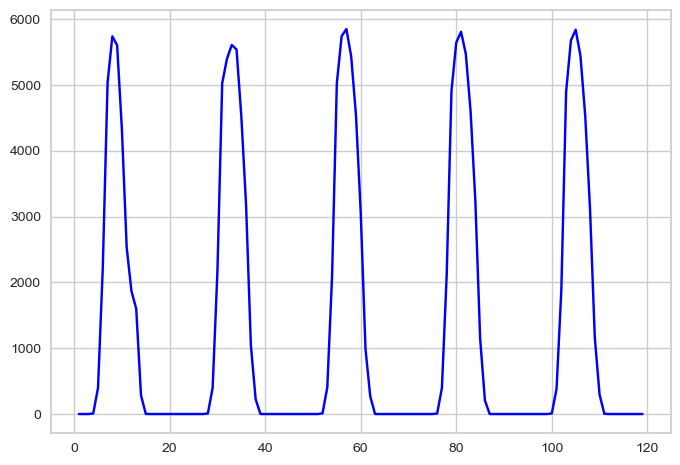

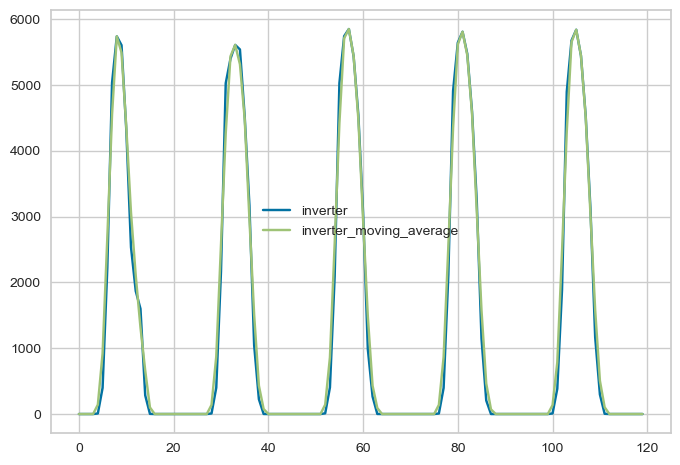

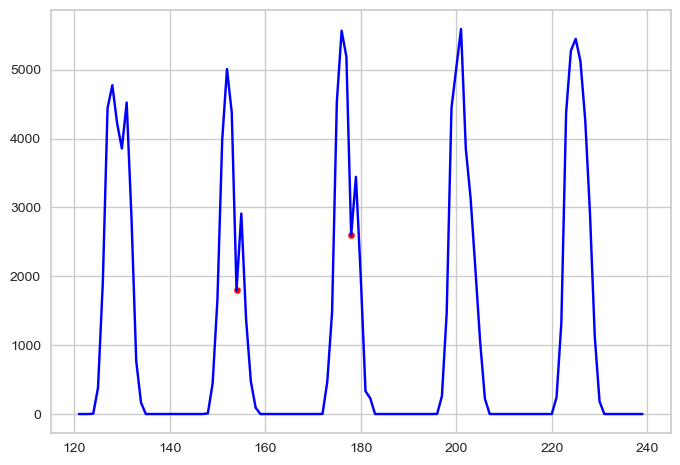

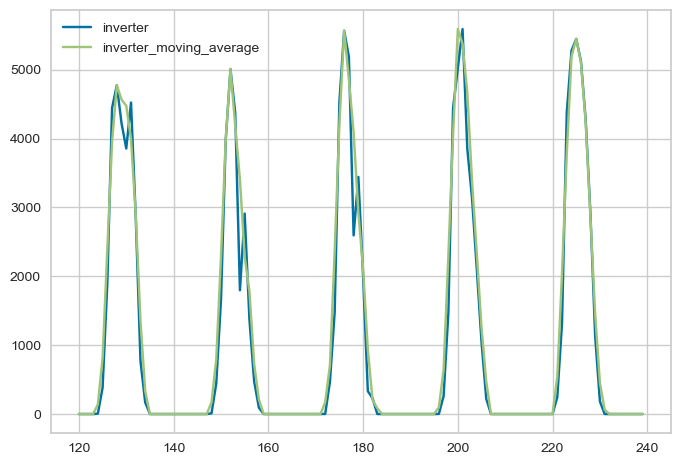

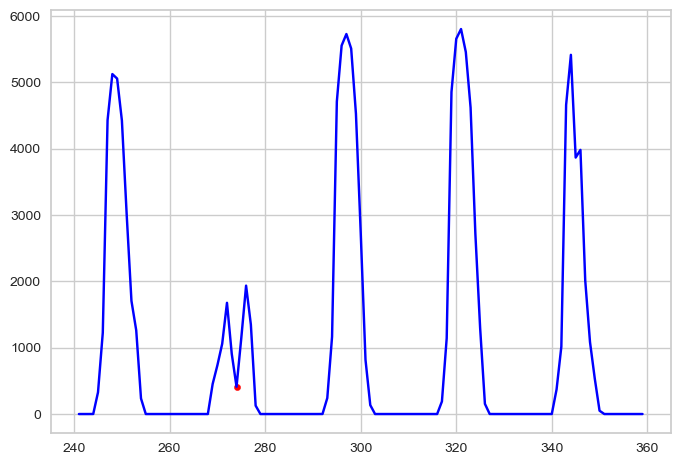

...

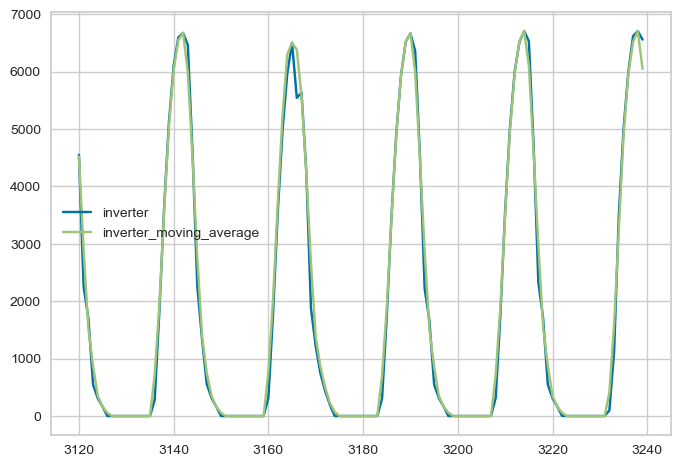

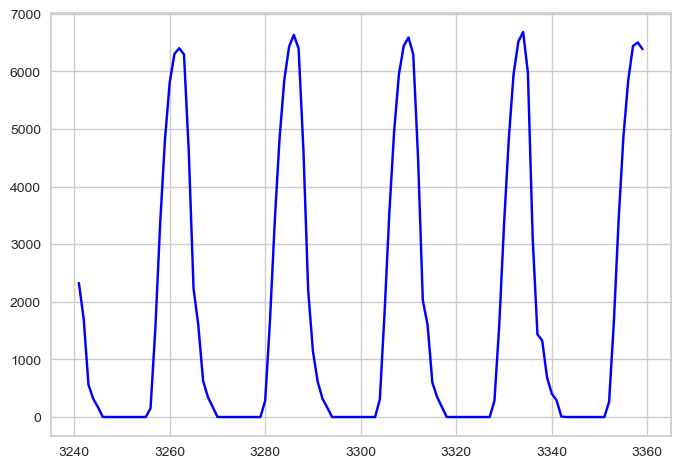

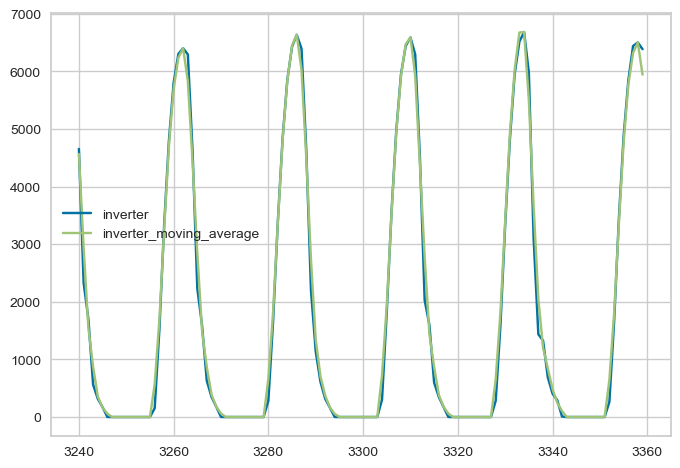

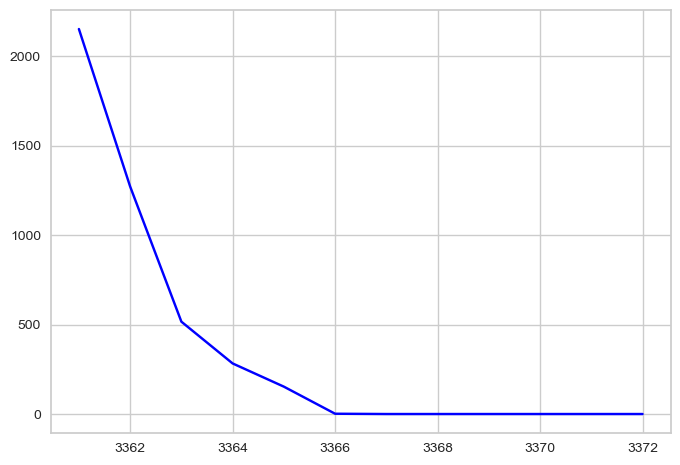

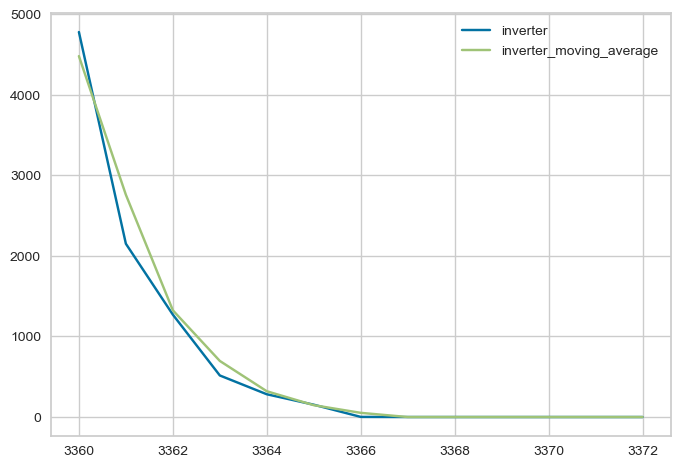

In [171]:
import matplotlib.pyplot as plt

for i in range(0,int(3373/120)+1) :
    x = i*120
    y = (i+1)*120

    plt.plot(dfi.index[(dfi.index>x) & (dfi.index<y)], dfi.inverter[(dfi.index>x) & (dfi.index<y)], color="blue", markersize=4)
    plt.scatter(fluctuations.index[(fluctuations.index>x) & (fluctuations.index<y)], fluctuations.inverter[(fluctuations.index>x) & (fluctuations.index<y)], color="red", s=20)

    plt.show()
    
    dfi[['inverter','inverter_moving_average']][x:y].plot()
    
    plt.show()

In [172]:
dfi.fluctuation.sum()

38

In [173]:
dfi['fluct-1'] = dfi['fluctuation'].shift(-1)
dfi['fluct-2'] = dfi['fluctuation'].shift(-2)
dfi['fluct+1'] = dfi['fluctuation'].shift(1)
dfi['fluct+2'] = dfi['fluctuation'].shift(2)

dfi['fluctuation'] = dfi.apply(lambda x: x['fluct-1'] or x['fluct-2'] or x['fluctuation'] or x['fluct+1'] or x['fluct+2'],axis=1)
dfi['fluctuation'] = dfi['fluctuation'].fillna(False)

In [174]:
dfi.fluctuation.sum()

188

In [175]:
fluctuations = dfi[dfi['fluctuation']==1]

<Axes: xlabel='fluctuation'>

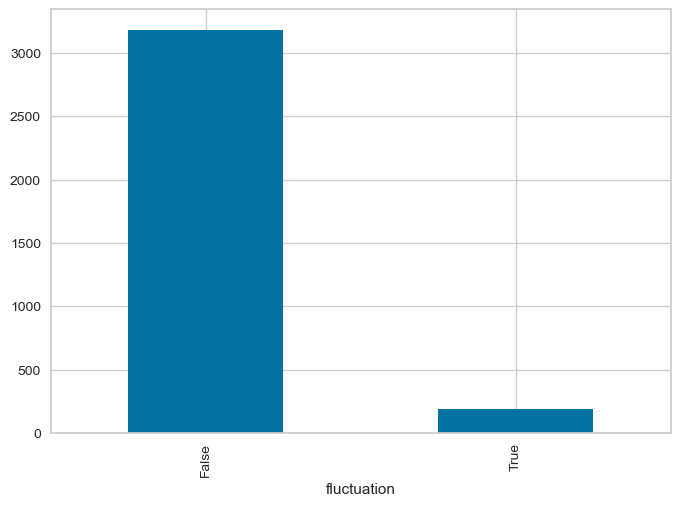

In [176]:
dfi['fluctuation'].value_counts().plot.bar()

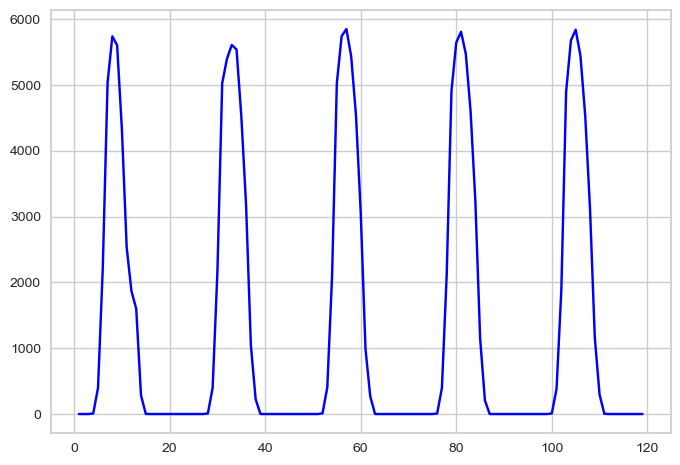

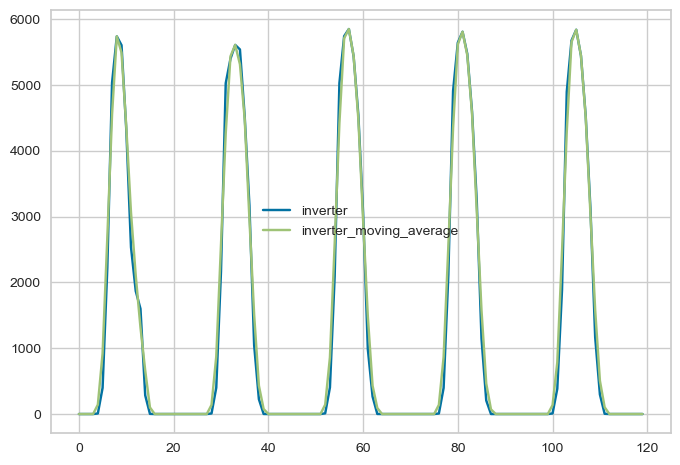

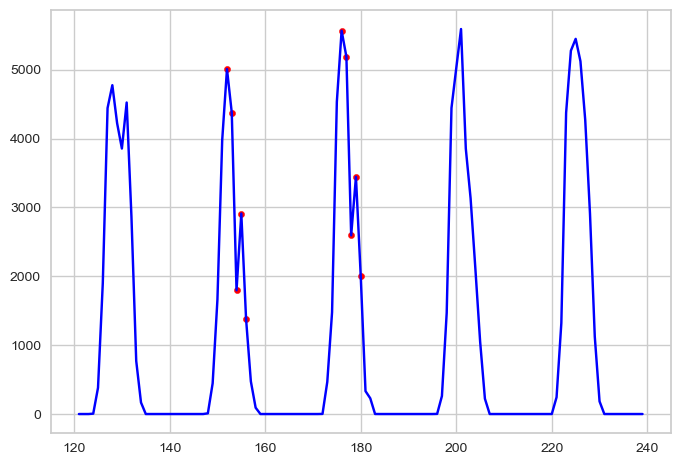

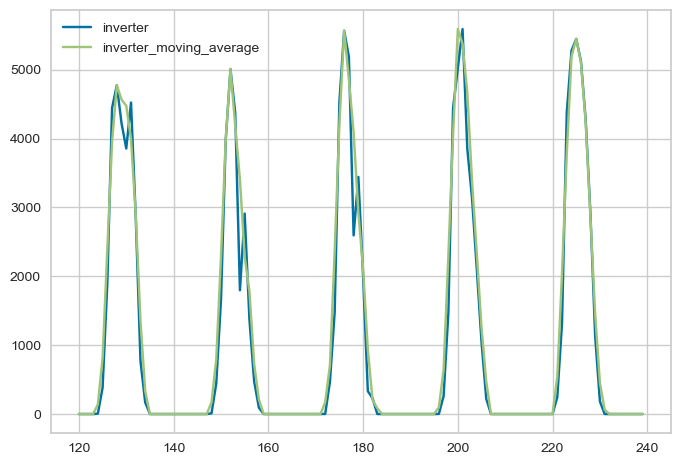

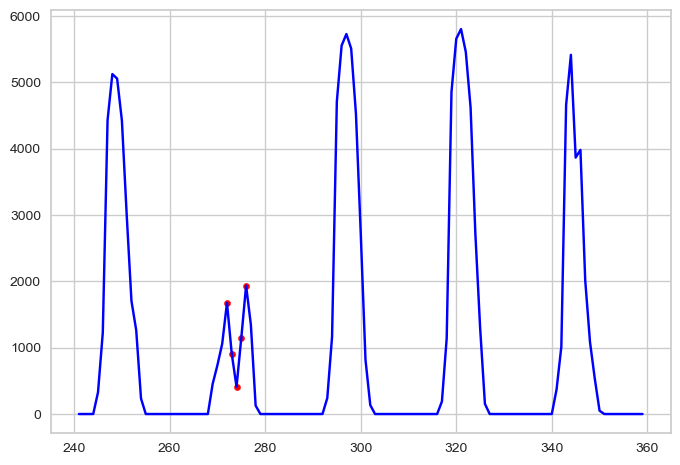

...

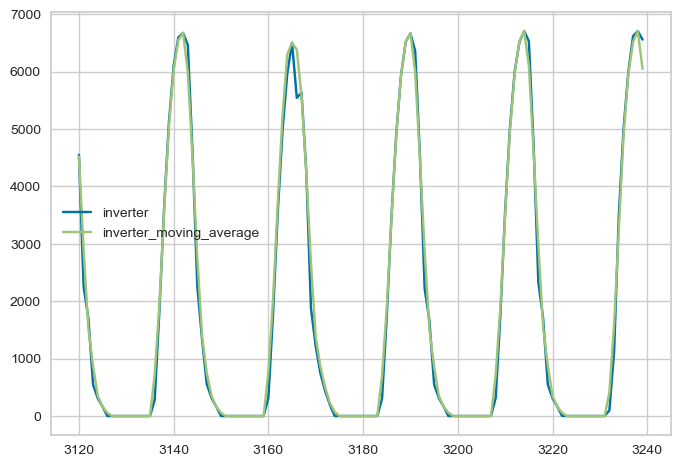

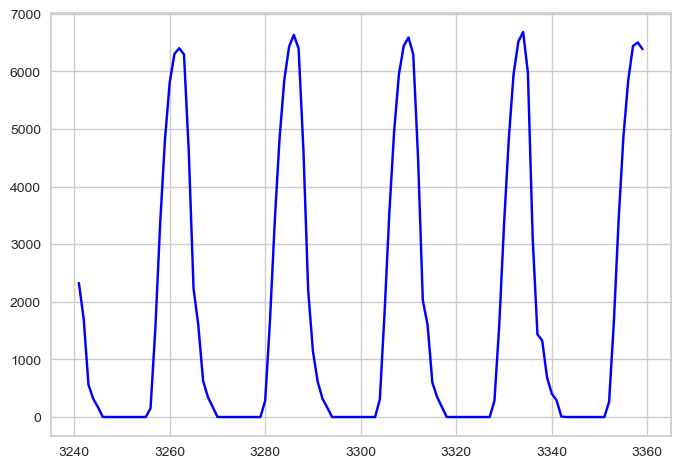

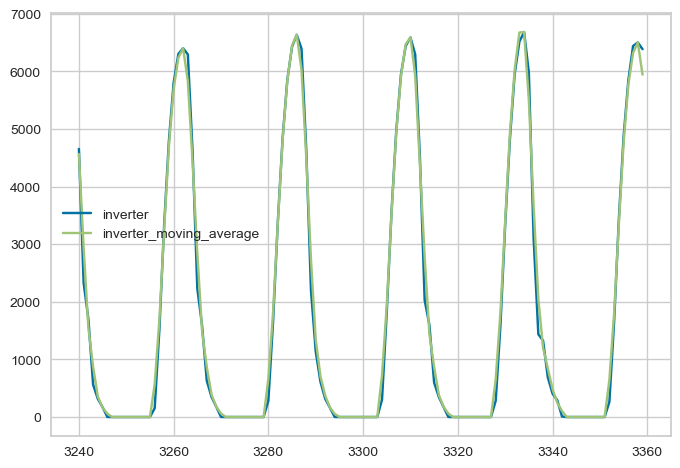

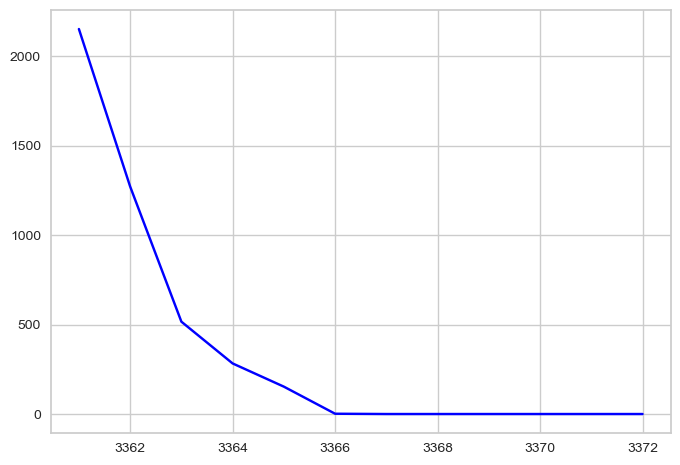

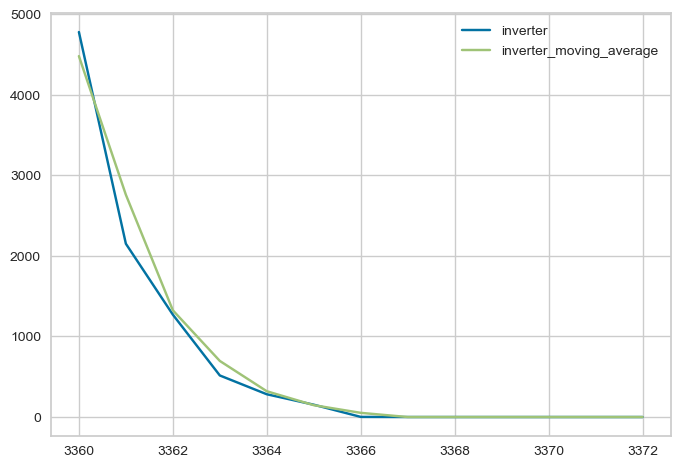

In [177]:
import matplotlib.pyplot as plt

for i in range(0,int(3373/120)+1) :
    x = i*120
    y = (i+1)*120

    plt.plot(dfi.index[(dfi.index>x) & (dfi.index<y)], dfi.inverter[(dfi.index>x) & (dfi.index<y)], color="blue", markersize=4)
    plt.scatter(fluctuations.index[(fluctuations.index>x) & (fluctuations.index<y)], fluctuations.inverter[(fluctuations.index>x) & (fluctuations.index<y)], color="red", s=20)

    plt.show()
    
    dfi[['inverter','inverter_moving_average']][x:y].plot()
    
    plt.show()

In [178]:
dfi.columns

Index(['datetime', 'inverter', 'panel_size', 'temperature_2m',
       'relative_humidity_2m', 'apparent_temperature', 'precipitation', 'rain',
       'cloud_cover', 'cloud_cover_low', 'cloud_cover_mid', 'cloud_cover_high',
       'wind_speed_10m', 'wind_speed_100m', 'wind_gusts_10m', 'is_day',
       'sunshine_duration', 'shortwave_radiation', 'direct_radiation',
       'diffuse_radiation', 'direct_normal_irradiance',
       'terrestrial_radiation', 'shortwave_radiation_instant',
       'direct_radiation_instant', 'diffuse_radiation_instant',
       'direct_normal_irradiance_instant', 'terrestrial_radiation_instant',
       'azimuth', 'zenith', 'month', 'hour', 'energy',
       'inverter_moving_average', 'inverter_max',
       'inverter_moving_average_max', 'ratio', 'difference', 'difference_max',
       'difference__maxx', 'fluctuation', 'fluct-1', 'fluct-2', 'fluct+1',
       'fluct+2'],
      dtype='object')

In [179]:
dfi = dfi.drop(['energy',
       'inverter_moving_average', 'inverter_max',
       'inverter_moving_average_max', 'ratio', 'difference', 'difference_max',
       'difference__maxx', 'fluct-1', 'fluct-2', 'fluct+1',
       'fluct+2','panel_size','inverter'],axis=1)

dfi['fluctuation'] = dfi['fluctuation'].astype(int)

In [180]:
dfi.columns

Index(['datetime', 'temperature_2m', 'relative_humidity_2m',
       'apparent_temperature', 'precipitation', 'rain', 'cloud_cover',
       'cloud_cover_low', 'cloud_cover_mid', 'cloud_cover_high',
       'wind_speed_10m', 'wind_speed_100m', 'wind_gusts_10m', 'is_day',
       'sunshine_duration', 'shortwave_radiation', 'direct_radiation',
       'diffuse_radiation', 'direct_normal_irradiance',
       'terrestrial_radiation', 'shortwave_radiation_instant',
       'direct_radiation_instant', 'diffuse_radiation_instant',
       'direct_normal_irradiance_instant', 'terrestrial_radiation_instant',
       'azimuth', 'zenith', 'month', 'hour', 'fluctuation'],
      dtype='object')

In [181]:
data_train, data_test = train_test_split(dfi, test_size=0.2, random_state=1)
data_test = data_test.sort_values('datetime')

data_train = data_train.drop('datetime',axis=1)
data_test = data_test.drop('datetime',axis=1)

### pycaret

In [182]:
s = setup(data = data_train, target = 'fluctuation', session_id = 1, fold = 5)

,Description,Value
0,Session id,1
1,Target,fluctuation
2,Target type,Binary
3,Original data shape,"(2698, 29)"
4,Transformed data shape,"(2698, 29)"
5,Transformed train set shape,"(1888, 29)"
6,Transformed test set shape,"(810, 29)"
7,Numeric features,28
8,Preprocess,True
9,Imputation type,simple


In [183]:
best3 = s.compare_models(n_select = 3, sort='F1') #include = ['et', 'rf', 'lightgbm', 'xgboost', 'lda', 'ridge', 'dt', 'knn', 'gbc', 'ada', 'catboost', 'lr']

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
rf,Random Forest Classifier,0.9550,0.9386,0.2795,0.7014,0.3863,0.3690,0.4166,0.2860
gbc,Gradient Boosting Classifier,0.9491,0.9318,0.2990,0.5567,0.3811,0.3581,0.3803,0.6600
et,Extra Trees Classifier,0.9544,0.9305,0.2786,0.6783,0.3789,0.3614,0.4065,0.1620
lda,Linear Discriminant Analysis,0.9396,0.9056,0.3295,0.4623,0.3783,0.3476,0.3564,0.0220
lightgbm,Light Gradient Boosting Machine,0.9481,0.9298,0.3181,0.4962,0.3764,0.3529,0.3667,0.5500
xgboost,Extreme Gradient Boosting,0.9481,0.9159,0.3090,0.5147,0.3708,0.3478,0.3659,0.2120
dt,Decision Tree Classifier,0.9311,0.6658,0.3681,0.3587,0.3585,0.3227,0.3251,0.0220
nb,Naive Bayes,0.7701,0.8961,0.8924,0.1795,0.2985,0.2285,0.3352,0.0180
knn,K Neighbors Classifier,0.9407,0.7849,0.2229,0.4121,0.2885,0.2607,0.2744,0.1140
svm,SVM - Linear Kernel,0.9248,0.0000,0.2529,0.4253,0.2627,0.2319,0.2648,0.0160


### pycaret - SMOTEENN

In [184]:
from imblearn.combine import SMOTEENN

sme = SMOTEENN(sampling_strategy='all', random_state=1, n_jobs=-1)

In [185]:
X = data_train.drop('fluctuation',axis=1)
y = data_train[['fluctuation']]

In [186]:
X_res, y_res = sme.fit_resample(X, y)

<Axes: xlabel='fluctuation'>

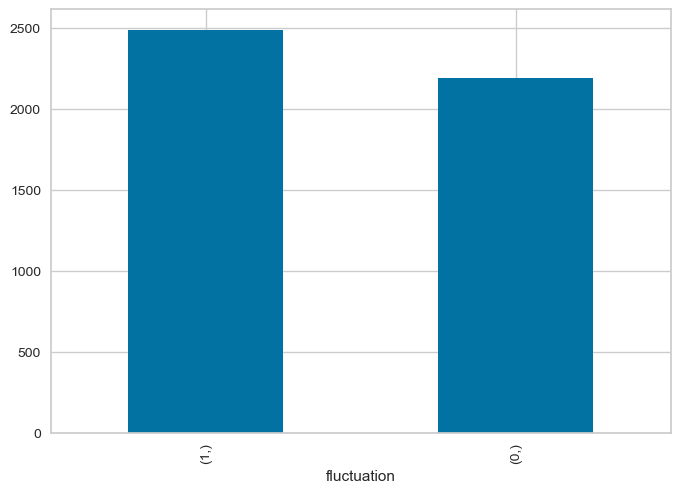

In [187]:
y_res.value_counts().plot.bar()

In [188]:
data_train = X_res.copy()
data_train['fluctuation'] = y_res

In [189]:
s = setup(data = data_train, target = 'fluctuation', session_id = 1, fold = 10)

,Description,Value
0,Session id,1
1,Target,fluctuation
2,Target type,Binary
3,Original data shape,"(4678, 29)"
4,Transformed data shape,"(4678, 29)"
5,Transformed train set shape,"(3274, 29)"
6,Transformed test set shape,"(1404, 29)"
7,Numeric features,28
8,Preprocess,True
9,Imputation type,simple


In [190]:
best3 = s.compare_models(n_select = 3, sort='F1') 

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
et,Extra Trees Classifier,0.9924,0.9999,0.9983,0.9876,0.9929,0.9847,0.9848,0.2110
lightgbm,Light Gradient Boosting Machine,0.9899,0.9993,0.9948,0.9865,0.9906,0.9798,0.9799,0.6450
xgboost,Extreme Gradient Boosting,0.9884,0.9993,0.9925,0.9859,0.9891,0.9767,0.9768,0.1920
rf,Random Forest Classifier,0.9869,0.9995,0.9937,0.9820,0.9878,0.9736,0.9738,0.6860
gbc,Gradient Boosting Classifier,0.9805,0.9984,0.9891,0.9747,0.9818,0.9607,0.9610,1.6150
knn,K Neighbors Classifier,0.9765,0.9963,0.9994,0.9586,0.9785,0.9526,0.9539,0.0820
ada,Ada Boost Classifier,0.9750,0.9968,0.9879,0.9661,0.9768,0.9496,0.9501,0.4460
dt,Decision Tree Classifier,0.9707,0.9702,0.9776,0.9680,0.9726,0.9411,0.9415,0.0720
lr,Logistic Regression,0.9499,0.9848,0.9747,0.9343,0.9540,0.8991,0.9004,0.2050
ridge,Ridge Classifier,0.9276,0.0000,0.9874,0.8892,0.9356,0.8535,0.8600,0.0260


In [191]:
predict_model(best3[0],data_test)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Extra Trees Classifier,0.8844,0.9382,0.8049,0.3204,0.4583,0.4068,0.4613


,temperature_2m,relative_humidity_2m,apparent_temperature,precipitation,rain,cloud_cover,cloud_cover_low,cloud_cover_mid,cloud_cover_high,wind_speed_10m,...,diffuse_radiation_instant,direct_normal_irradiance_instant,terrestrial_radiation_instant,azimuth,zenith,month,hour,fluctuation,prediction_label,prediction_score
3,16.108000,89.370384,16.999006,0.0,0.0,5.700000,0.0,0.0,19.0,3.706427,...,0.000000,0.000000,0.000000,98.224670,104.536469,11,3,0,0,1.00
4,15.558001,87.033760,16.109491,0.0,0.0,0.000000,0.0,0.0,0.0,3.706427,...,0.000000,0.000000,0.000000,106.508156,92.468445,11,4,0,0,1.00
6,21.458000,55.240314,21.177088,0.0,0.0,0.000000,0.0,0.0,0.0,6.409617,...,90.817406,482.204742,461.024963,125.681030,70.558144,11,6,0,0,0.91
7,23.858000,53.366432,24.076742,0.0,0.0,3.000000,3.0,0.0,1.0,6.924738,...,105.385185,655.079834,663.350281,138.007629,61.436432,11,7,0,0,0.78
10,28.257999,35.032356,28.253460,0.0,0.0,32.700001,1.0,3.0,100.0,5.116561,...,120.144188,754.419495,879.966187,189.398972,50.678322,11,10,0,0,0.58
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3347,24.808001,84.455307,28.627396,0.0,0.0,0.000000,0.0,0.0,0.0,7.594207,...,0.000000,0.000000,0.000000,2.672956,121.631645,6,22,0,0,1.00
3351,24.058001,90.237267,28.688232,0.0,0.0,4.500000,5.0,0.0,0.0,3.396233,...,0.000000,0.000000,0.000000,55.226421,96.913406,6,2,0,0,1.00
3357,33.708000,29.083176,34.158760,0.0,0.0,0.000000,0.0,0.0,0.0,13.441071,...,142.423309,796.412048,1181.411499,109.222427,26.760262,6,8,0,0,0.98
3369,27.908001,63.170002,29.901440,0.0,0.0,0.000000,0.0,0.0,0.0,13.679999,...,0.000000,0.000000,0.000000,331.687134,116.142097,6,20,0,0,1.00


In [192]:
predict_model(best3[1],data_test)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Light Gradient Boosting Machine,0.9007,0.9272,0.8537,0.3646,0.5109,0.4654,0.5180


,temperature_2m,relative_humidity_2m,apparent_temperature,precipitation,rain,cloud_cover,cloud_cover_low,cloud_cover_mid,cloud_cover_high,wind_speed_10m,...,diffuse_radiation_instant,direct_normal_irradiance_instant,terrestrial_radiation_instant,azimuth,zenith,month,hour,fluctuation,prediction_label,prediction_score
3,16.108000,89.370384,16.999006,0.0,0.0,5.700000,0.0,0.0,19.0,3.706427,...,0.000000,0.000000,0.000000,98.224670,104.536469,11,3,0,0,1.0000
4,15.558001,87.033760,16.109491,0.0,0.0,0.000000,0.0,0.0,0.0,3.706427,...,0.000000,0.000000,0.000000,106.508156,92.468445,11,4,0,0,1.0000
6,21.458000,55.240314,21.177088,0.0,0.0,0.000000,0.0,0.0,0.0,6.409617,...,90.817406,482.204742,461.024963,125.681030,70.558144,11,6,0,0,0.9998
7,23.858000,53.366432,24.076742,0.0,0.0,3.000000,3.0,0.0,1.0,6.924738,...,105.385185,655.079834,663.350281,138.007629,61.436432,11,7,0,0,0.7913
10,28.257999,35.032356,28.253460,0.0,0.0,32.700001,1.0,3.0,100.0,5.116561,...,120.144188,754.419495,879.966187,189.398972,50.678322,11,10,0,1,0.9989
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3347,24.808001,84.455307,28.627396,0.0,0.0,0.000000,0.0,0.0,0.0,7.594207,...,0.000000,0.000000,0.000000,2.672956,121.631645,6,22,0,0,1.0000
3351,24.058001,90.237267,28.688232,0.0,0.0,4.500000,5.0,0.0,0.0,3.396233,...,0.000000,0.000000,0.000000,55.226421,96.913406,6,2,0,0,1.0000
3357,33.708000,29.083176,34.158760,0.0,0.0,0.000000,0.0,0.0,0.0,13.441071,...,142.423309,796.412048,1181.411499,109.222427,26.760262,6,8,0,0,0.9999
3369,27.908001,63.170002,29.901440,0.0,0.0,0.000000,0.0,0.0,0.0,13.679999,...,0.000000,0.000000,0.000000,331.687134,116.142097,6,20,0,0,1.0000


In [193]:
predict_model(best3[2],data_test)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Extreme Gradient Boosting,0.8978,0.9272,0.8537,0.3571,0.5036,0.4571,0.5114


,temperature_2m,relative_humidity_2m,apparent_temperature,precipitation,rain,cloud_cover,cloud_cover_low,cloud_cover_mid,cloud_cover_high,wind_speed_10m,...,diffuse_radiation_instant,direct_normal_irradiance_instant,terrestrial_radiation_instant,azimuth,zenith,month,hour,fluctuation,prediction_label,prediction_score
3,16.108000,89.370384,16.999006,0.0,0.0,5.700000,0.0,0.0,19.0,3.706427,...,0.000000,0.000000,0.000000,98.224670,104.536469,11,3,0,0,0.9998
4,15.558001,87.033760,16.109491,0.0,0.0,0.000000,0.0,0.0,0.0,3.706427,...,0.000000,0.000000,0.000000,106.508156,92.468445,11,4,0,0,0.9999
6,21.458000,55.240314,21.177088,0.0,0.0,0.000000,0.0,0.0,0.0,6.409617,...,90.817406,482.204742,461.024963,125.681030,70.558144,11,6,0,0,0.9997
7,23.858000,53.366432,24.076742,0.0,0.0,3.000000,3.0,0.0,1.0,6.924738,...,105.385185,655.079834,663.350281,138.007629,61.436432,11,7,0,0,0.9315
10,28.257999,35.032356,28.253460,0.0,0.0,32.700001,1.0,3.0,100.0,5.116561,...,120.144188,754.419495,879.966187,189.398972,50.678322,11,10,0,1,0.9951
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3347,24.808001,84.455307,28.627396,0.0,0.0,0.000000,0.0,0.0,0.0,7.594207,...,0.000000,0.000000,0.000000,2.672956,121.631645,6,22,0,0,1.0000
3351,24.058001,90.237267,28.688232,0.0,0.0,4.500000,5.0,0.0,0.0,3.396233,...,0.000000,0.000000,0.000000,55.226421,96.913406,6,2,0,0,0.9999
3357,33.708000,29.083176,34.158760,0.0,0.0,0.000000,0.0,0.0,0.0,13.441071,...,142.423309,796.412048,1181.411499,109.222427,26.760262,6,8,0,0,0.9998
3369,27.908001,63.170002,29.901440,0.0,0.0,0.000000,0.0,0.0,0.0,13.679999,...,0.000000,0.000000,0.000000,331.687134,116.142097,6,20,0,0,1.0000


### ExtraTreesClassifier

In [194]:
from sklearn.ensemble import ExtraTreesClassifier

from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score

from sklearn import metrics
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix

In [195]:
dfi = df[df['id']=='inverter3'].copy()
dfi = dfi.drop('id',axis=1)

dfi = dfi.set_index('datetime')
dfi['inverter_moving_average'] = dfi['inverter'].rolling(window=pd.Timedelta(hours=3),center=True).mean()
dfi['inverter_max'] = dfi['inverter'].rolling(window=pd.Timedelta(hours=24),center=True).max()
dfi['inverter_moving_average_max'] = dfi['inverter_moving_average'].rolling(window=pd.Timedelta(hours=24),center=True).max()

dfi['ratio'] = dfi['inverter_max']/dfi['inverter_moving_average_max']
dfi['inverter_moving_average'] = dfi['inverter_moving_average']*dfi['ratio']
dfi['inverter_moving_average'] = dfi.apply(lambda x: 0 if x['inverter']==0 else x['inverter_moving_average'],axis=1)

dfi['difference'] = abs(dfi['inverter_moving_average']-dfi['inverter'])
dfi['difference_max'] = dfi['difference'].rolling(window=pd.Timedelta(hours=12),center=True).max()
dfi['difference__maxx'] = dfi.apply(lambda x: x['difference'] if x['difference']==x['difference_max'] else 0, axis=1)

dfi['fluctuation'] = dfi['difference__maxx']>(dfi['inverter_max']*1/4)
dfi = dfi.reset_index()

dfi['fluct-1'] = dfi['fluctuation'].shift(-1)
dfi['fluct-2'] = dfi['fluctuation'].shift(-2)
dfi['fluct+1'] = dfi['fluctuation'].shift(1)
dfi['fluct+2'] = dfi['fluctuation'].shift(2)

dfi['fluctuation'] = dfi.apply(lambda x: x['fluct-1'] or x['fluct-2'] or x['fluctuation'] or x['fluct+1'] or x['fluct+2'],axis=1)
dfi['fluctuation'] = dfi['fluctuation'].fillna(False)

dfi = dfi.drop(['energy',
       'inverter_moving_average', 'inverter_max',
       'inverter_moving_average_max', 'ratio', 'difference', 'difference_max',
       'difference__maxx', 'fluct-1', 'fluct-2', 'fluct+1',
       'fluct+2','panel_size','inverter'],axis=1)

dfi['fluctuation'] = dfi['fluctuation'].astype(int)

data_train, data_test = train_test_split(dfi, test_size=0.2, random_state=1)
data_test = data_test.sort_values('datetime')

data_train = data_train.drop('datetime',axis=1)
data_test = data_test.drop('datetime',axis=1)

X_train = data_train.drop('fluctuation',axis=1)
y_train = data_train[['fluctuation']]

X_test = data_test.drop('fluctuation',axis=1)
y_test = data_test[['fluctuation']]

In [196]:
et = ExtraTreesClassifier(random_state=1, n_jobs=-1)

cv = KFold(n_splits=5, shuffle=True, random_state=1)

scores = cross_val_score(et, X_train, y_train, cv=cv, scoring = 'f1')

print(scores)
print(scores.mean())

[0.35555556 0.48275862 0.48979592 0.32432432 0.43478261]
0.4174434055265069


In [197]:
et = ExtraTreesClassifier(random_state=1, n_jobs=-1)

et.fit(X_train,y_train)

y_pred = et.predict(X_test)

y_pred = pd.DataFrame({'pred':y_pred,'true':y_test['fluctuation']})

In [198]:
print(classification_report(y_pred['true'],y_pred['pred']))

              precision    recall  f1-score   support

           0       0.96      1.00      0.98       634
           1       0.87      0.32      0.46        41

    accuracy                           0.96       675
   macro avg       0.91      0.66      0.72       675
weighted avg       0.95      0.96      0.95       675



In [199]:
confusion_matrix(y_pred['true'],y_pred['pred'])

array([[632,   2],
       [ 28,  13]], dtype=int64)

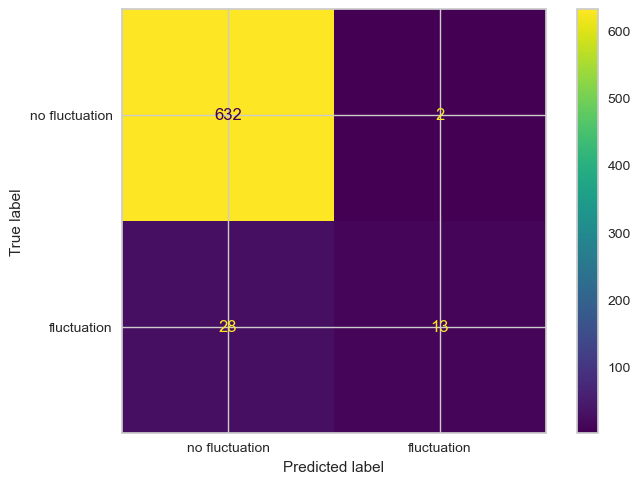

In [200]:
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix(y_pred['true'],y_pred['pred']), display_labels = ['no fluctuation','fluctuation'])
cm_display.plot()
plt.show()

In [201]:
et = ExtraTreesClassifier(class_weight = 'balanced_subsample', random_state=1, n_jobs=-1)

cv = KFold(n_splits=5, shuffle=True, random_state=1)

scores = cross_val_score(et, X_train, y_train, cv=cv, scoring = 'f1')

print(scores)
print(scores.mean())

[0.38297872 0.46666667 0.45833333 0.33333333 0.40909091]
0.41008059316569956


In [202]:
et = ExtraTreesClassifier(class_weight = 'balanced_subsample', random_state=1, n_jobs=-1)

et.fit(X_train,y_train)

y_pred = et.predict(X_test)

y_pred = pd.DataFrame({'pred':y_pred,'true':y_test['fluctuation']})

In [203]:
print(classification_report(y_pred['true'],y_pred['pred']))

              precision    recall  f1-score   support

           0       0.95      1.00      0.97       634
           1       0.89      0.20      0.32        41

    accuracy                           0.95       675
   macro avg       0.92      0.60      0.65       675
weighted avg       0.95      0.95      0.93       675



In [204]:
confusion_matrix(y_pred['true'],y_pred['pred'])

array([[633,   1],
       [ 33,   8]], dtype=int64)

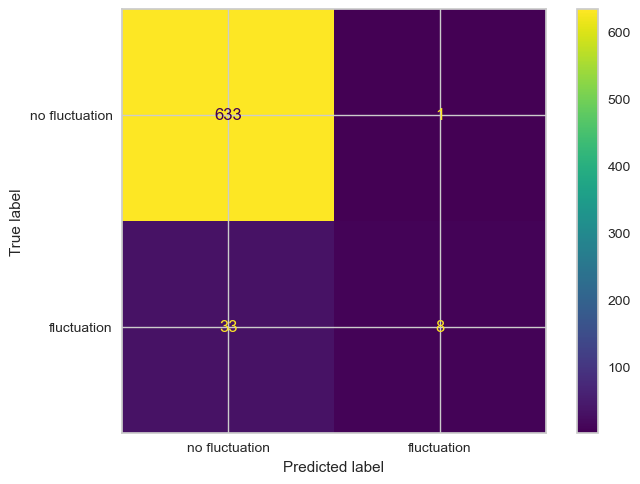

In [205]:
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix(y_pred['true'],y_pred['pred']), display_labels = ['no fluctuation','fluctuation'])
cm_display.plot()
plt.show()

### LGBMClassifier

In [206]:
from lightgbm import LGBMClassifier

In [207]:
lgbm = LGBMClassifier(random_state=1, n_jobs=-1)

cv = KFold(n_splits=5, shuffle=True, random_state=1)

scores = cross_val_score(lgbm, X_train, y_train, cv=cv, scoring = 'f1')

print(scores)
print(scores.mean())

[LightGBM] [Info] Number of positive: 114, number of negative: 2044
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001360 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4987
[LightGBM] [Info] Number of data points in the train set: 2158, number of used features: 28
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.052827 -> initscore=-2.886466
[LightGBM] [Info] Start training from score -2.886466
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 128, number of negative: 2030
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000571 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4998
[LightGBM] [Info] Number of data points in the train set: 2158, number of used features: 28
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.059314 -> initscore=-2.763761

In [208]:
lgbm = LGBMClassifier(random_state=1, n_jobs=-1)

lgbm.fit(X_train,y_train)

y_pred = lgbm.predict(X_test)

y_pred = pd.DataFrame({'pred':y_pred,'true':y_test['fluctuation']})

[LightGBM] [Info] Number of positive: 147, number of negative: 2551
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001205 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5083
[LightGBM] [Info] Number of data points in the train set: 2698, number of used features: 28
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.054485 -> initscore=-2.853808
[LightGBM] [Info] Start training from score -2.853808


In [209]:
print(classification_report(y_pred['true'],y_pred['pred']))

              precision    recall  f1-score   support

           0       0.96      0.99      0.98       634
           1       0.76      0.39      0.52        41

    accuracy                           0.96       675
   macro avg       0.86      0.69      0.75       675
weighted avg       0.95      0.96      0.95       675



In [210]:
confusion_matrix(y_pred['true'],y_pred['pred'])

array([[629,   5],
       [ 25,  16]], dtype=int64)

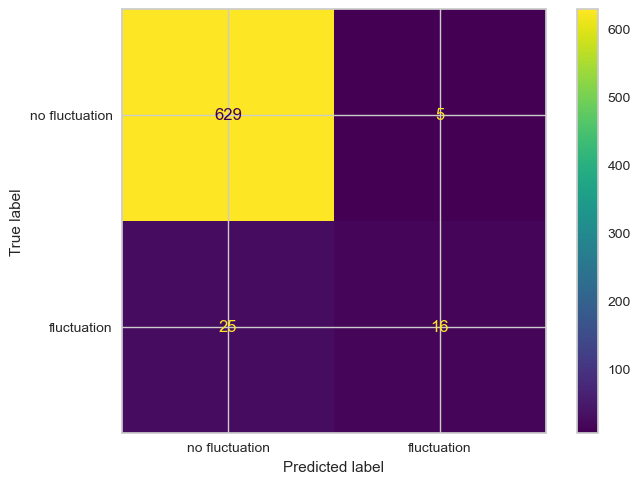

In [211]:
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix(y_pred['true'],y_pred['pred']), display_labels = ['no fluctuation','fluctuation'])
cm_display.plot()
plt.show()

In [212]:
lgbm = LGBMClassifier(class_weight='balanced', random_state=1, n_jobs=-1)

cv = KFold(n_splits=5, shuffle=True, random_state=1)

scores = cross_val_score(lgbm, X_train, y_train, cv=cv, scoring = 'f1')

print(scores)
print(scores.mean())

[LightGBM] [Info] Number of positive: 114, number of negative: 2044
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001317 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4987
[LightGBM] [Info] Number of data points in the train set: 2158, number of used features: 28
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=-0.000000
[LightGBM] [Info] Start training from score -0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 128, number of negative: 2030
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000958 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4998
[LightGBM] [Info] Number of data points in the train set: 2158, number of used features: 28
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=-0.000000

In [213]:
lgbm = LGBMClassifier(class_weight='balanced', random_state=1, n_jobs=-1)

lgbm.fit(X_train,y_train)

y_pred = lgbm.predict(X_test)

y_pred = pd.DataFrame({'pred':y_pred,'true':y_test['fluctuation']})

[LightGBM] [Info] Number of positive: 147, number of negative: 2551
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001165 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5083
[LightGBM] [Info] Number of data points in the train set: 2698, number of used features: 28
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=-0.000000
[LightGBM] [Info] Start training from score -0.000000


In [214]:
print(classification_report(y_pred['true'],y_pred['pred']))

              precision    recall  f1-score   support

           0       0.97      0.98      0.97       634
           1       0.59      0.54      0.56        41

    accuracy                           0.95       675
   macro avg       0.78      0.76      0.77       675
weighted avg       0.95      0.95      0.95       675



In [215]:
confusion_matrix(y_pred['true'],y_pred['pred'])

array([[619,  15],
       [ 19,  22]], dtype=int64)

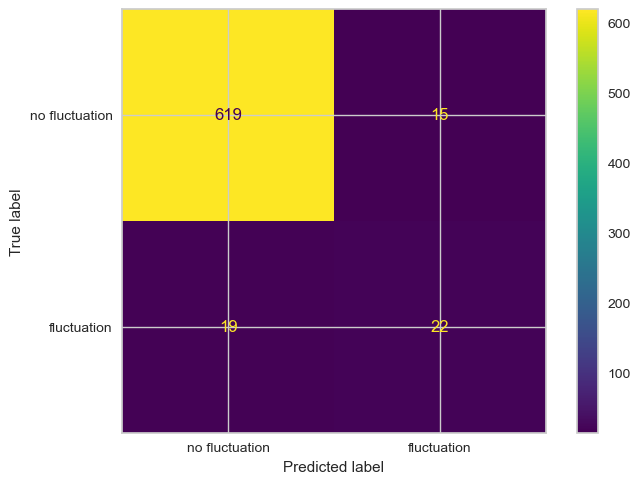

In [216]:
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix(y_pred['true'],y_pred['pred']), display_labels = ['no fluctuation','fluctuation'])
cm_display.plot()
plt.show()

### RnadomForestClassifier

In [217]:
from sklearn.ensemble import RandomForestClassifier

In [218]:
rf = RandomForestClassifier(random_state=1, n_jobs=-1)

cv = KFold(n_splits=5, shuffle=True, random_state=1)

scores = cross_val_score(rf, X_train, y_train, cv=cv, scoring = 'f1')

print(scores)
print(scores.mean())

[0.33333333 0.5        0.52       0.33333333 0.45454545]
0.4282424242424242


In [219]:
rf = RandomForestClassifier(random_state=1, n_jobs=-1)

rf.fit(X_train,y_train)

y_pred = rf.predict(X_test)

y_pred = pd.DataFrame({'pred':y_pred,'true':y_test['fluctuation']})

In [220]:
print(classification_report(y_pred['true'],y_pred['pred']))

              precision    recall  f1-score   support

           0       0.95      1.00      0.98       634
           1       0.91      0.24      0.38        41

    accuracy                           0.95       675
   macro avg       0.93      0.62      0.68       675
weighted avg       0.95      0.95      0.94       675



In [221]:
confusion_matrix(y_pred['true'],y_pred['pred'])

array([[633,   1],
       [ 31,  10]], dtype=int64)

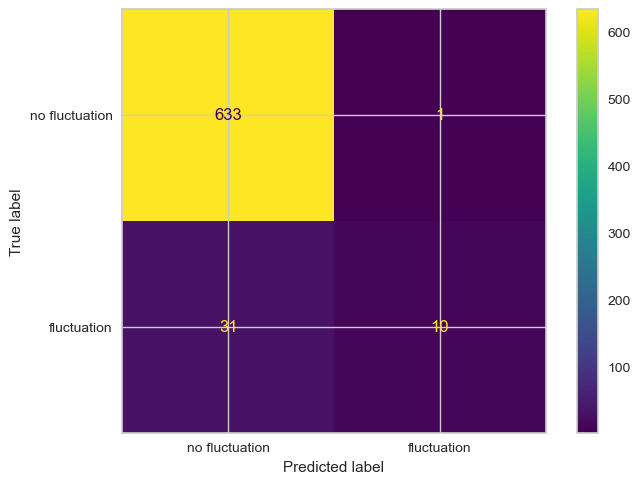

In [222]:
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix(y_pred['true'],y_pred['pred']), display_labels = ['no fluctuation','fluctuation'])
cm_display.plot()
plt.show()

In [223]:
rf = RandomForestClassifier(class_weight = 'balanced', random_state=1, n_jobs=-1)

cv = KFold(n_splits=5, shuffle=True, random_state=1)

scores = cross_val_score(rf, X_train, y_train, cv=cv, scoring = 'f1')

print(scores)
print(scores.mean())

[0.34042553 0.46153846 0.45833333 0.29411765 0.38095238]
0.38707347095957856


In [224]:
rf = RandomForestClassifier(class_weight = 'balanced', random_state=1, n_jobs=-1)

rf.fit(X_train,y_train)

y_pred = rf.predict(X_test)

y_pred = pd.DataFrame({'pred':y_pred,'true':y_test['fluctuation']})

In [225]:
print(classification_report(y_pred['true'],y_pred['pred']))

              precision    recall  f1-score   support

           0       0.95      1.00      0.97       634
           1       0.88      0.17      0.29        41

    accuracy                           0.95       675
   macro avg       0.91      0.58      0.63       675
weighted avg       0.94      0.95      0.93       675



In [226]:
confusion_matrix(y_pred['true'],y_pred['pred'])

array([[633,   1],
       [ 34,   7]], dtype=int64)

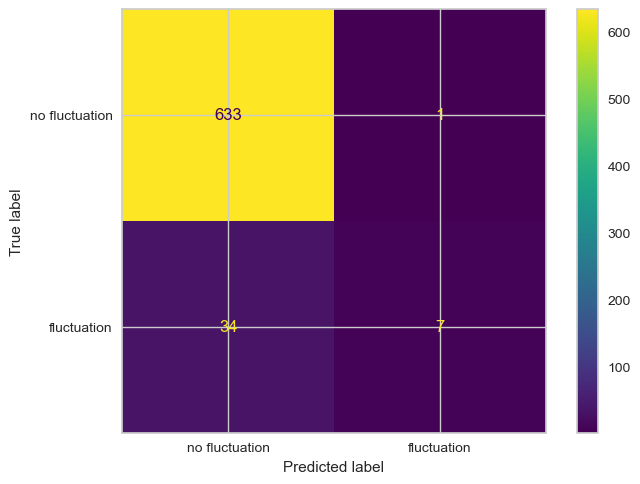

In [227]:
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix(y_pred['true'],y_pred['pred']), display_labels = ['no fluctuation','fluctuation'])
cm_display.plot()
plt.show()

# LGBM huperparameter tuning - f1 score

In [246]:
from lightgbm import LGBMClassifier

import optuna

import warnings

warnings.simplefilter('ignore')

## INVERTER1

In [247]:
dfi = df[df['id']=='inverter1'].copy()
dfi = dfi.drop('id',axis=1)

dfi = dfi.set_index('datetime')
dfi['inverter_moving_average'] = dfi['inverter'].rolling(window=pd.Timedelta(hours=3),center=True).mean()
dfi['inverter_max'] = dfi['inverter'].rolling(window=pd.Timedelta(hours=24),center=True).max()
dfi['inverter_moving_average_max'] = dfi['inverter_moving_average'].rolling(window=pd.Timedelta(hours=24),center=True).max()

dfi['ratio'] = dfi['inverter_max']/dfi['inverter_moving_average_max']
dfi['inverter_moving_average'] = dfi['inverter_moving_average']*dfi['ratio']
dfi['inverter_moving_average'] = dfi.apply(lambda x: 0 if x['inverter']==0 else x['inverter_moving_average'],axis=1)

dfi['difference'] = abs(dfi['inverter_moving_average']-dfi['inverter'])
dfi['difference_max'] = dfi['difference'].rolling(window=pd.Timedelta(hours=12),center=True).max()
dfi['difference__maxx'] = dfi.apply(lambda x: x['difference'] if x['difference']==x['difference_max'] else 0, axis=1)

dfi['fluctuation'] = dfi['difference__maxx']>(dfi['inverter_max']*1/4)
dfi = dfi.reset_index()

dfi['fluct-1'] = dfi['fluctuation'].shift(-1)
dfi['fluct-2'] = dfi['fluctuation'].shift(-2)
dfi['fluct+1'] = dfi['fluctuation'].shift(1)
dfi['fluct+2'] = dfi['fluctuation'].shift(2)

dfi['fluctuation'] = dfi.apply(lambda x: x['fluct-1'] or x['fluct-2'] or x['fluctuation'] or x['fluct+1'] or x['fluct+2'],axis=1)
dfi['fluctuation'] = dfi['fluctuation'].fillna(False)

dfi = dfi.drop(['energy',
       'inverter_moving_average', 'inverter_max',
       'inverter_moving_average_max', 'ratio', 'difference', 'difference_max',
       'difference__maxx', 'fluct-1', 'fluct-2', 'fluct+1',
       'fluct+2','panel_size','inverter'],axis=1)

dfi['fluctuation'] = dfi['fluctuation'].astype(int)

data_train, data_test = train_test_split(dfi, test_size=0.2, random_state=1)
data_test = data_test.sort_values('datetime')

data_train = data_train.drop('datetime',axis=1)
data_test = data_test.drop('datetime',axis=1)

X_train = data_train.drop('fluctuation',axis=1)
y_train = data_train[['fluctuation']]

X_test = data_test.drop('fluctuation',axis=1)
y_test = data_test[['fluctuation']]

In [248]:
def _(doc):
    return doc

def objective(trial):

    lgbm_max_depth = trial.suggest_int("max_depth", 3, 30)
    lgbm_n_estimators = trial.suggest_int("n_estimators", 100, 500)
    lgbm_learning_rate = trial.suggest_float("learning_rate", 0.01, 0.3)
    lgbm_num_leaves = trial.suggest_int("num_leaves", 20, 3000, step=20)
    lgbm_min_data_in_leaf = trial.suggest_int("min_data_in_leaf", 200, 10000, step=100)
    lgbm_lambda_l1 = trial.suggest_int("lambda_l1", 0, 100, step=5)
    lgbm_lambda_l2 = trial.suggest_int("lambda_l2", 0, 100, step=5)

    lgbm_cl = LGBMClassifier(class_weight = 'balanced',max_depth = lgbm_max_depth,n_estimators = lgbm_n_estimators,
                             learning_rate=lgbm_learning_rate,num_leaves=lgbm_num_leaves,min_data_in_leaf=lgbm_min_data_in_leaf,
                             lambda_l1=lgbm_lambda_l1,lambda_l2=lgbm_lambda_l2,random_state = 1,n_jobs = -1)

    cv = KFold(n_splits=5, shuffle=True, random_state=1)

    scores = cross_val_score(lgbm_cl, X_train, y_train, cv=cv, scoring = 'f1')

    return scores.mean()

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=200, n_jobs = -1, show_progress_bar=True)

print("Best trial:")
best_trial = study.best_trial
print("  Value: ", best_trial.value)
print("  Params: ")
for key, value in best_trial.params.items():
    print("    {}: {}".format(key, value))

[I 2024-07-26 13:11:01,771] A new study created in memory with name: no-name-ccfc0c61-6aac-4e79-9c34-6e7510ee73e7


  0%|          | 0/200 [00:00<?, ?it/s]

[I 2024-07-26 13:11:05,421] Trial 10 finished with value: 0.08824319745852956 and parameters: {'max_depth': 20, 'n_estimators': 129, 'learning_rate': 0.11500546641740696, 'num_leaves': 800, 'min_data_in_leaf': 1500, 'lambda_l1': 60, 'lambda_l2': 25}. Best is trial 10 with value: 0.08824319745852956.
[I 2024-07-26 13:11:05,488] Trial 2 finished with value: 0.08824319745852956 and parameters: {'max_depth': 24, 'n_estimators': 135, 'learning_rate': 0.159403235743463, 'num_leaves': 2040, 'min_data_in_leaf': 3100, 'lambda_l1': 0, 'lambda_l2': 95}. Best is trial 10 with value: 0.08824319745852956.
[I 2024-07-26 13:11:05,704] Trial 3 finished with value: 0.08824319745852956 and parameters: {'max_depth': 5, 'n_estimators': 141, 'learning_rate': 0.015596952528234214, 'num_leaves': 580, 'min_data_in_leaf': 9000, 'lambda_l1': 60, 'lambda_l2': 70}. Best is trial 10 with value: 0.08824319745852956.
[I 2024-07-26 13:11:06,470] Trial 6 finished with value: 0.08824319745852956 and parameters: {'max_de

[I 2024-07-26 13:11:46,778] Trial 32 finished with value: 0.30405977099691245 and parameters: {'max_depth': 24, 'n_estimators': 224, 'learning_rate': 0.15981066951356526, 'num_leaves': 2400, 'min_data_in_leaf': 900, 'lambda_l1': 25, 'lambda_l2': 50}. Best is trial 26 with value: 0.3364832614835629.
[I 2024-07-26 13:11:48,083] Trial 30 finished with value: 0.3423927331532874 and parameters: {'max_depth': 24, 'n_estimators': 216, 'learning_rate': 0.13544895229940762, 'num_leaves': 2440, 'min_data_in_leaf': 300, 'lambda_l1': 30, 'lambda_l2': 40}. Best is trial 30 with value: 0.3423927331532874.
[I 2024-07-26 13:11:48,398] Trial 33 finished with value: 0.3429832069830696 and parameters: {'max_depth': 23, 'n_estimators': 230, 'learning_rate': 0.1557095848144051, 'num_leaves': 2040, 'min_data_in_leaf': 300, 'lambda_l1': 30, 'lambda_l2': 40}. Best is trial 33 with value: 0.3429832069830696.
[I 2024-07-26 13:11:52,560] Trial 19 finished with value: 0.3210706870804286 and parameters: {'max_dept

[I 2024-07-26 13:12:34,798] Trial 61 finished with value: 0.08824319745852956 and parameters: {'max_depth': 18, 'n_estimators': 156, 'learning_rate': 0.18844977898410403, 'num_leaves': 1980, 'min_data_in_leaf': 1500, 'lambda_l1': 10, 'lambda_l2': 30}. Best is trial 34 with value: 0.3534987641225079.
[I 2024-07-26 13:12:36,586] Trial 42 finished with value: 0.3256131709343423 and parameters: {'max_depth': 14, 'n_estimators': 338, 'learning_rate': 0.13638359660485513, 'num_leaves': 1680, 'min_data_in_leaf': 200, 'lambda_l1': 50, 'lambda_l2': 60}. Best is trial 34 with value: 0.3534987641225079.
[I 2024-07-26 13:12:37,370] Trial 43 finished with value: 0.32786251201981537 and parameters: {'max_depth': 14, 'n_estimators': 321, 'learning_rate': 0.14697508161969758, 'num_leaves': 1680, 'min_data_in_leaf': 200, 'lambda_l1': 50, 'lambda_l2': 60}. Best is trial 34 with value: 0.3534987641225079.
[I 2024-07-26 13:12:40,161] Trial 57 finished with value: 0.08824319745852956 and parameters: {'max_

[I 2024-07-26 13:14:08,208] Trial 80 finished with value: 0.30823935747862985 and parameters: {'max_depth': 22, 'n_estimators': 200, 'learning_rate': 0.04722595757507194, 'num_leaves': 2280, 'min_data_in_leaf': 600, 'lambda_l1': 40, 'lambda_l2': 40}. Best is trial 64 with value: 0.39511881378344194.
[I 2024-07-26 13:14:11,493] Trial 90 finished with value: 0.08824319745852956 and parameters: {'max_depth': 16, 'n_estimators': 271, 'learning_rate': 0.02516128235338492, 'num_leaves': 1140, 'min_data_in_leaf': 7500, 'lambda_l1': 5, 'lambda_l2': 20}. Best is trial 64 with value: 0.39511881378344194.
[I 2024-07-26 13:14:13,701] Trial 91 finished with value: 0.08824319745852956 and parameters: {'max_depth': 16, 'n_estimators': 280, 'learning_rate': 0.030542682822926832, 'num_leaves': 1560, 'min_data_in_leaf': 8800, 'lambda_l1': 0, 'lambda_l2': 20}. Best is trial 64 with value: 0.39511881378344194.
[I 2024-07-26 13:14:15,948] Trial 81 finished with value: 0.30154564799034267 and parameters: {'

[I 2024-07-26 13:16:18,363] Trial 108 finished with value: 0.3754205665657294 and parameters: {'max_depth': 18, 'n_estimators': 349, 'learning_rate': 0.06078951555436948, 'num_leaves': 2020, 'min_data_in_leaf': 200, 'lambda_l1': 20, 'lambda_l2': 10}. Best is trial 98 with value: 0.4519997438688608.
[I 2024-07-26 13:16:23,322] Trial 121 finished with value: 0.08824319745852956 and parameters: {'max_depth': 15, 'n_estimators': 289, 'learning_rate': 0.10507346063001939, 'num_leaves': 2400, 'min_data_in_leaf': 3900, 'lambda_l1': 0, 'lambda_l2': 25}. Best is trial 98 with value: 0.4519997438688608.
[I 2024-07-26 13:16:23,569] Trial 114 finished with value: 0.371006484970763 and parameters: {'max_depth': 18, 'n_estimators': 229, 'learning_rate': 0.10529589557176824, 'num_leaves': 1780, 'min_data_in_leaf': 200, 'lambda_l1': 20, 'lambda_l2': 15}. Best is trial 98 with value: 0.4519997438688608.
[I 2024-07-26 13:16:34,416] Trial 120 finished with value: 0.32000436455006387 and parameters: {'max

[I 2024-07-26 13:19:06,878] Trial 143 finished with value: 0.3519101090247879 and parameters: {'max_depth': 20, 'n_estimators': 426, 'learning_rate': 0.05233349432580287, 'num_leaves': 680, 'min_data_in_leaf': 800, 'lambda_l1': 5, 'lambda_l2': 20}. Best is trial 98 with value: 0.4519997438688608.
[I 2024-07-26 13:19:14,934] Trial 144 finished with value: 0.34887358515125866 and parameters: {'max_depth': 21, 'n_estimators': 387, 'learning_rate': 0.08919332492014435, 'num_leaves': 740, 'min_data_in_leaf': 800, 'lambda_l1': 5, 'lambda_l2': 20}. Best is trial 98 with value: 0.4519997438688608.
[I 2024-07-26 13:19:17,790] Trial 139 finished with value: 0.3518203280943387 and parameters: {'max_depth': 20, 'n_estimators': 429, 'learning_rate': 0.08992264562948658, 'num_leaves': 2480, 'min_data_in_leaf': 800, 'lambda_l1': 5, 'lambda_l2': 30}. Best is trial 98 with value: 0.4519997438688608.
[I 2024-07-26 13:19:20,237] Trial 145 finished with value: 0.3611957891455548 and parameters: {'max_dept

[I 2024-07-26 13:22:54,379] Trial 176 finished with value: 0.08824319745852956 and parameters: {'max_depth': 12, 'n_estimators': 447, 'learning_rate': 0.2770879358070864, 'num_leaves': 2780, 'min_data_in_leaf': 1100, 'lambda_l1': 5, 'lambda_l2': 20}. Best is trial 98 with value: 0.4519997438688608.
[I 2024-07-26 13:22:54,475] Trial 170 finished with value: 0.3815310542636294 and parameters: {'max_depth': 9, 'n_estimators': 379, 'learning_rate': 0.27076056219410205, 'num_leaves': 2640, 'min_data_in_leaf': 500, 'lambda_l1': 10, 'lambda_l2': 15}. Best is trial 98 with value: 0.4519997438688608.
[I 2024-07-26 13:22:57,777] Trial 181 finished with value: 0.08824319745852956 and parameters: {'max_depth': 13, 'n_estimators': 105, 'learning_rate': 0.1204057698370321, 'num_leaves': 2400, 'min_data_in_leaf': 1500, 'lambda_l1': 5, 'lambda_l2': 20}. Best is trial 98 with value: 0.4519997438688608.
[I 2024-07-26 13:22:58,361] Trial 166 finished with value: 0.37103184126136046 and parameters: {'max_

[I 2024-07-26 13:24:40,610] Trial 190 finished with value: 0.43266548543909866 and parameters: {'max_depth': 17, 'n_estimators': 477, 'learning_rate': 0.07877131167041226, 'num_leaves': 2200, 'min_data_in_leaf': 400, 'lambda_l1': 0, 'lambda_l2': 10}. Best is trial 98 with value: 0.4519997438688608.
[I 2024-07-26 13:24:42,559] Trial 194 finished with value: 0.45144033502729153 and parameters: {'max_depth': 9, 'n_estimators': 476, 'learning_rate': 0.29217391944404963, 'num_leaves': 2340, 'min_data_in_leaf': 400, 'lambda_l1': 0, 'lambda_l2': 10}. Best is trial 98 with value: 0.4519997438688608.
[I 2024-07-26 13:24:42,950] Trial 196 finished with value: 0.41002351737122805 and parameters: {'max_depth': 15, 'n_estimators': 484, 'learning_rate': 0.28910954916120335, 'num_leaves': 2920, 'min_data_in_leaf': 700, 'lambda_l1': 0, 'lambda_l2': 15}. Best is trial 98 with value: 0.4519997438688608.
[I 2024-07-26 13:24:43,523] Trial 199 finished with value: 0.40973304409661954 and parameters: {'max_

In [249]:
best_trial.params

{'max_depth': 19,
 'n_estimators': 243,
 'learning_rate': 0.1524556402558868,
 'num_leaves': 2540,
 'min_data_in_leaf': 200,
 'lambda_l1': 5,
 'lambda_l2': 10}

{'max_depth': 19,
 'n_estimators': 243,
 'learning_rate': 0.1524556402558868,
 'num_leaves': 2540,
 'min_data_in_leaf': 200,
 'lambda_l1': 5,
 'lambda_l2': 10}

In [250]:
lgbm = LGBMClassifier(class_weight='balanced', **best_trial.params, random_state=1, n_jobs=-1)

cv = KFold(n_splits=5, shuffle=True, random_state=1)

scores = cross_val_score(lgbm, X_train, y_train, cv=cv, scoring = 'f1')

print(scores)
print(scores.mean())

[LightGBM] [Warning] min_data_in_leaf is set=200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=200
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] min_data_in_leaf is set=200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=200
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Info] Number of positive: 112, number of negative: 2046
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.005966 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4957
[LightGBM] [Info] Number of data points in the train set: 2158, number of used feature

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of data points in the train set: 2158, number of used features: 26
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=-0.000000
[LightGBM] [Info] Start training from score -0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

[LightGBM] [Info] Number of data points in the train set: 2158, number of used features: 26
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Info] Start training from score 0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fu

[LightGBM] [Warning] min_data_in_leaf is set=200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=200
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] min_data_in_leaf is set=200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=200
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] min_data_in_leaf is set=200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=200
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Info] Number 

[LightGBM] [Warning] min_data_in_leaf is set=200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=200
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] min_data_in_leaf is set=200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=200
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] min_data_in_leaf is set=200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=200
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Info] Number 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] min_data_in_leaf is set=200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=200
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[0.4        0.37142857 0.49484536 0.47826087 0.51546392]
0.4519997438688608


In [251]:
lgbm = LGBMClassifier(class_weight='balanced', **best_trial.params, random_state=1, n_jobs=-1)

lgbm.fit(X_train,y_train)

y_pred = lgbm.predict(X_test)

y_pred = pd.DataFrame({'pred':y_pred,'true':y_test['fluctuation']})

[LightGBM] [Warning] min_data_in_leaf is set=200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=200
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] min_data_in_leaf is set=200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=200
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Info] Number of positive: 145, number of negative: 2553
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001735 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5047
[LightGBM] [Info] Number of data points in the train set: 2698, number of used feature

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] min_data_in_leaf is set=200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=200
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10


In [252]:
print(classification_report(y_pred['true'],y_pred['pred']))

              precision    recall  f1-score   support

           0       0.98      0.93      0.95       637
           1       0.37      0.68      0.48        38

    accuracy                           0.92       675
   macro avg       0.68      0.81      0.72       675
weighted avg       0.95      0.92      0.93       675



In [253]:
confusion_matrix(y_pred['true'],y_pred['pred'])

array([[593,  44],
       [ 12,  26]], dtype=int64)

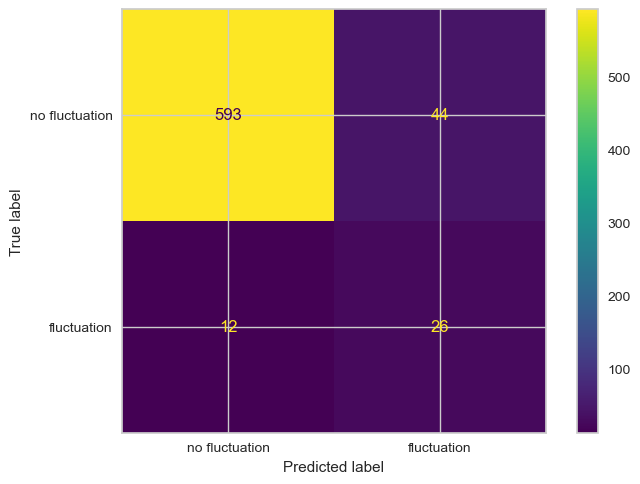

In [254]:
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix(y_pred['true'],y_pred['pred']), display_labels = ['no fluctuation','fluctuation'])
cm_display.plot()
plt.show()

## INVERTER2

In [255]:
dfi = df[df['id']=='inverter2'].copy()
dfi = dfi.drop('id',axis=1)

dfi = dfi.set_index('datetime')
dfi['inverter_moving_average'] = dfi['inverter'].rolling(window=pd.Timedelta(hours=3),center=True).mean()
dfi['inverter_max'] = dfi['inverter'].rolling(window=pd.Timedelta(hours=24),center=True).max()
dfi['inverter_moving_average_max'] = dfi['inverter_moving_average'].rolling(window=pd.Timedelta(hours=24),center=True).max()

dfi['ratio'] = dfi['inverter_max']/dfi['inverter_moving_average_max']
dfi['inverter_moving_average'] = dfi['inverter_moving_average']*dfi['ratio']
dfi['inverter_moving_average'] = dfi.apply(lambda x: 0 if x['inverter']==0 else x['inverter_moving_average'],axis=1)

dfi['difference'] = abs(dfi['inverter_moving_average']-dfi['inverter'])
dfi['difference_max'] = dfi['difference'].rolling(window=pd.Timedelta(hours=12),center=True).max()
dfi['difference__maxx'] = dfi.apply(lambda x: x['difference'] if x['difference']==x['difference_max'] else 0, axis=1)

dfi['fluctuation'] = dfi['difference__maxx']>(dfi['inverter_max']*1/4)
dfi = dfi.reset_index()

dfi['fluct-1'] = dfi['fluctuation'].shift(-1)
dfi['fluct-2'] = dfi['fluctuation'].shift(-2)
dfi['fluct+1'] = dfi['fluctuation'].shift(1)
dfi['fluct+2'] = dfi['fluctuation'].shift(2)

dfi['fluctuation'] = dfi.apply(lambda x: x['fluct-1'] or x['fluct-2'] or x['fluctuation'] or x['fluct+1'] or x['fluct+2'],axis=1)
dfi['fluctuation'] = dfi['fluctuation'].fillna(False)

dfi = dfi.drop(['energy',
       'inverter_moving_average', 'inverter_max',
       'inverter_moving_average_max', 'ratio', 'difference', 'difference_max',
       'difference__maxx', 'fluct-1', 'fluct-2', 'fluct+1',
       'fluct+2','panel_size','inverter'],axis=1)

dfi['fluctuation'] = dfi['fluctuation'].astype(int)

data_train, data_test = train_test_split(dfi, test_size=0.2, random_state=1)
data_test = data_test.sort_values('datetime')

data_train = data_train.drop('datetime',axis=1)
data_test = data_test.drop('datetime',axis=1)

X_train = data_train.drop('fluctuation',axis=1)
y_train = data_train[['fluctuation']]

X_test = data_test.drop('fluctuation',axis=1)
y_test = data_test[['fluctuation']]

In [256]:
def _(doc):
    return doc

def objective(trial):

    lgbm_max_depth = trial.suggest_int("max_depth", 3, 30)
    lgbm_n_estimators = trial.suggest_int("n_estimators", 100, 500)
    lgbm_learning_rate = trial.suggest_float("learning_rate", 0.01, 0.3)
    lgbm_num_leaves = trial.suggest_int("num_leaves", 20, 3000, step=20)
    lgbm_min_data_in_leaf = trial.suggest_int("min_data_in_leaf", 200, 10000, step=100)
    lgbm_lambda_l1 = trial.suggest_int("lambda_l1", 0, 100, step=5)
    lgbm_lambda_l2 = trial.suggest_int("lambda_l2", 0, 100, step=5)

    lgbm_cl = LGBMClassifier(class_weight = 'balanced',max_depth = lgbm_max_depth,n_estimators = lgbm_n_estimators,
                             learning_rate=lgbm_learning_rate,num_leaves=lgbm_num_leaves,min_data_in_leaf=lgbm_min_data_in_leaf,
                             lambda_l1=lgbm_lambda_l1,lambda_l2=lgbm_lambda_l2,random_state = 1,n_jobs = -1)

    cv = KFold(n_splits=5, shuffle=True, random_state=1)

    scores = cross_val_score(lgbm_cl, X_train, y_train, cv=cv, scoring = 'f1')

    return scores.mean()

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=200, n_jobs = -1, show_progress_bar=True)

print("Best trial:")
best_trial = study.best_trial
print("  Value: ", best_trial.value)
print("  Params: ")
for key, value in best_trial.params.items():
    print("    {}: {}".format(key, value))

[I 2024-07-26 13:24:47,209] A new study created in memory with name: no-name-e5e88d5a-cf70-4a04-b933-8d488089e0a1


  0%|          | 0/200 [00:00<?, ?it/s]

[I 2024-07-26 13:24:51,287] Trial 9 finished with value: 0.019081272084805652 and parameters: {'max_depth': 24, 'n_estimators': 178, 'learning_rate': 0.2887244410134661, 'num_leaves': 140, 'min_data_in_leaf': 2200, 'lambda_l1': 15, 'lambda_l2': 95}. Best is trial 9 with value: 0.019081272084805652.
[I 2024-07-26 13:24:51,877] Trial 5 finished with value: 0.019081272084805652 and parameters: {'max_depth': 9, 'n_estimators': 193, 'learning_rate': 0.2366302223509419, 'num_leaves': 2580, 'min_data_in_leaf': 3000, 'lambda_l1': 75, 'lambda_l2': 45}. Best is trial 9 with value: 0.019081272084805652.
[I 2024-07-26 13:24:52,598] Trial 4 finished with value: 0.019081272084805652 and parameters: {'max_depth': 13, 'n_estimators': 222, 'learning_rate': 0.29925873576903866, 'num_leaves': 400, 'min_data_in_leaf': 1200, 'lambda_l1': 20, 'lambda_l2': 10}. Best is trial 9 with value: 0.019081272084805652.
[I 2024-07-26 13:24:53,493] Trial 3 finished with value: 0.019081272084805652 and parameters: {'max

[I 2024-07-26 13:25:14,412] Trial 28 finished with value: 0.019081272084805652 and parameters: {'max_depth': 30, 'n_estimators': 465, 'learning_rate': 0.01291332874546805, 'num_leaves': 2960, 'min_data_in_leaf': 5000, 'lambda_l1': 55, 'lambda_l2': 30}. Best is trial 16 with value: 0.30895054274420797.
[I 2024-07-26 13:25:15,607] Trial 29 finished with value: 0.019081272084805652 and parameters: {'max_depth': 20, 'n_estimators': 401, 'learning_rate': 0.13504950198646823, 'num_leaves': 2280, 'min_data_in_leaf': 5700, 'lambda_l1': 50, 'lambda_l2': 30}. Best is trial 16 with value: 0.30895054274420797.
[I 2024-07-26 13:25:16,446] Trial 30 finished with value: 0.019081272084805652 and parameters: {'max_depth': 21, 'n_estimators': 414, 'learning_rate': 0.015361169623224818, 'num_leaves': 2340, 'min_data_in_leaf': 6200, 'lambda_l1': 50, 'lambda_l2': 30}. Best is trial 16 with value: 0.30895054274420797.
[I 2024-07-26 13:25:16,714] Trial 31 finished with value: 0.019081272084805652 and paramet

[I 2024-07-26 13:26:13,674] Trial 60 finished with value: 0.019081272084805652 and parameters: {'max_depth': 7, 'n_estimators': 446, 'learning_rate': 0.12430275038243749, 'num_leaves': 1880, 'min_data_in_leaf': 1400, 'lambda_l1': 10, 'lambda_l2': 40}. Best is trial 34 with value: 0.39935429370924735.
[I 2024-07-26 13:26:14,000] Trial 61 finished with value: 0.019081272084805652 and parameters: {'max_depth': 12, 'n_estimators': 445, 'learning_rate': 0.12691420447171153, 'num_leaves': 1520, 'min_data_in_leaf': 3000, 'lambda_l1': 10, 'lambda_l2': 45}. Best is trial 34 with value: 0.39935429370924735.
[I 2024-07-26 13:26:14,244] Trial 64 finished with value: 0.019081272084805652 and parameters: {'max_depth': 6, 'n_estimators': 447, 'learning_rate': 0.22115559146300995, 'num_leaves': 1360, 'min_data_in_leaf': 1400, 'lambda_l1': 10, 'lambda_l2': 45}. Best is trial 34 with value: 0.39935429370924735.
[I 2024-07-26 13:26:14,324] Trial 63 finished with value: 0.019081272084805652 and parameters

[I 2024-07-26 13:26:51,680] Trial 89 finished with value: 0.019081272084805652 and parameters: {'max_depth': 9, 'n_estimators': 406, 'learning_rate': 0.18561298351093644, 'num_leaves': 860, 'min_data_in_leaf': 4500, 'lambda_l1': 5, 'lambda_l2': 45}. Best is trial 34 with value: 0.39935429370924735.
[I 2024-07-26 13:26:52,461] Trial 90 finished with value: 0.019081272084805652 and parameters: {'max_depth': 18, 'n_estimators': 404, 'learning_rate': 0.11617334718509577, 'num_leaves': 780, 'min_data_in_leaf': 1100, 'lambda_l1': 5, 'lambda_l2': 35}. Best is trial 34 with value: 0.39935429370924735.
[I 2024-07-26 13:26:52,609] Trial 91 finished with value: 0.019081272084805652 and parameters: {'max_depth': 9, 'n_estimators': 399, 'learning_rate': 0.11306413485337462, 'num_leaves': 860, 'min_data_in_leaf': 4200, 'lambda_l1': 5, 'lambda_l2': 35}. Best is trial 34 with value: 0.39935429370924735.
[I 2024-07-26 13:26:55,328] Trial 93 finished with value: 0.019081272084805652 and parameters: {'ma

[I 2024-07-26 13:28:10,265] Trial 103 finished with value: 0.4107148539436104 and parameters: {'max_depth': 11, 'n_estimators': 351, 'learning_rate': 0.08366601426202613, 'num_leaves': 2800, 'min_data_in_leaf': 400, 'lambda_l1': 0, 'lambda_l2': 25}. Best is trial 92 with value: 0.46127162163690816.
[I 2024-07-26 13:28:21,432] Trial 120 finished with value: 0.019081272084805652 and parameters: {'max_depth': 7, 'n_estimators': 421, 'learning_rate': 0.14547076953523103, 'num_leaves': 1980, 'min_data_in_leaf': 1600, 'lambda_l1': 0, 'lambda_l2': 70}. Best is trial 92 with value: 0.46127162163690816.
[I 2024-07-26 13:28:22,390] Trial 112 finished with value: 0.3522320871494587 and parameters: {'max_depth': 16, 'n_estimators': 339, 'learning_rate': 0.2072636212911364, 'num_leaves': 1440, 'min_data_in_leaf': 400, 'lambda_l1': 30, 'lambda_l2': 45}. Best is trial 92 with value: 0.46127162163690816.
[I 2024-07-26 13:28:27,295] Trial 111 finished with value: 0.34995906137830585 and parameters: {'m

[I 2024-07-26 13:29:43,416] Trial 144 finished with value: 0.3761416435170588 and parameters: {'max_depth': 10, 'n_estimators': 105, 'learning_rate': 0.2395369949460573, 'num_leaves': 2460, 'min_data_in_leaf': 600, 'lambda_l1': 5, 'lambda_l2': 30}. Best is trial 92 with value: 0.46127162163690816.
[I 2024-07-26 13:29:56,158] Trial 137 finished with value: 0.3382821948911835 and parameters: {'max_depth': 19, 'n_estimators': 392, 'learning_rate': 0.2558144680268336, 'num_leaves': 2160, 'min_data_in_leaf': 900, 'lambda_l1': 0, 'lambda_l2': 65}. Best is trial 92 with value: 0.46127162163690816.
[I 2024-07-26 13:30:01,883] Trial 138 finished with value: 0.34058573807370013 and parameters: {'max_depth': 19, 'n_estimators': 393, 'learning_rate': 0.25540276130807466, 'num_leaves': 2920, 'min_data_in_leaf': 900, 'lambda_l1': 0, 'lambda_l2': 15}. Best is trial 92 with value: 0.46127162163690816.
[I 2024-07-26 13:30:06,374] Trial 141 finished with value: 0.2792114372451577 and parameters: {'max_d

[I 2024-07-26 13:31:30,328] Trial 177 finished with value: 0.019081272084805652 and parameters: {'max_depth': 24, 'n_estimators': 387, 'learning_rate': 0.28498789743243524, 'num_leaves': 2320, 'min_data_in_leaf': 3300, 'lambda_l1': 0, 'lambda_l2': 25}. Best is trial 92 with value: 0.46127162163690816.
[I 2024-07-26 13:31:32,088] Trial 171 finished with value: 0.4290465676275413 and parameters: {'max_depth': 9, 'n_estimators': 425, 'learning_rate': 0.2824870138977302, 'num_leaves': 2300, 'min_data_in_leaf': 600, 'lambda_l1': 0, 'lambda_l2': 25}. Best is trial 92 with value: 0.46127162163690816.
[I 2024-07-26 13:31:32,897] Trial 172 finished with value: 0.422245674506512 and parameters: {'max_depth': 9, 'n_estimators': 420, 'learning_rate': 0.28474126158152974, 'num_leaves': 2320, 'min_data_in_leaf': 600, 'lambda_l1': 0, 'lambda_l2': 25}. Best is trial 92 with value: 0.46127162163690816.
[I 2024-07-26 13:31:38,226] Trial 173 finished with value: 0.419191197153967 and parameters: {'max_de

[I 2024-07-26 13:32:42,986] Trial 196 finished with value: 0.4354403377643682 and parameters: {'max_depth': 23, 'n_estimators': 406, 'learning_rate': 0.2910719896361408, 'num_leaves': 480, 'min_data_in_leaf': 300, 'lambda_l1': 5, 'lambda_l2': 25}. Best is trial 167 with value: 0.4645565275254649.
[I 2024-07-26 13:32:44,106] Trial 197 finished with value: 0.4415322084150066 and parameters: {'max_depth': 25, 'n_estimators': 403, 'learning_rate': 0.2912824923987187, 'num_leaves': 460, 'min_data_in_leaf': 300, 'lambda_l1': 5, 'lambda_l2': 30}. Best is trial 167 with value: 0.4645565275254649.
[I 2024-07-26 13:32:44,467] Trial 198 finished with value: 0.43919140322620825 and parameters: {'max_depth': 25, 'n_estimators': 406, 'learning_rate': 0.2886854864044241, 'num_leaves': 320, 'min_data_in_leaf': 300, 'lambda_l1': 5, 'lambda_l2': 25}. Best is trial 167 with value: 0.4645565275254649.
[I 2024-07-26 13:32:44,813] Trial 199 finished with value: 0.43568213661712896 and parameters: {'max_dept

In [257]:
best_trial.params

{'max_depth': 9,
 'n_estimators': 378,
 'learning_rate': 0.284379067556672,
 'num_leaves': 2560,
 'min_data_in_leaf': 200,
 'lambda_l1': 0,
 'lambda_l2': 25}

{'max_depth': 9,
 'n_estimators': 378,
 'learning_rate': 0.284379067556672,
 'num_leaves': 2560,
 'min_data_in_leaf': 200,
 'lambda_l1': 0,
 'lambda_l2': 25}

In [258]:
lgbm = LGBMClassifier(class_weight='balanced', **best_trial.params, random_state=1, n_jobs=-1)

cv = KFold(n_splits=5, shuffle=True, random_state=1)

scores = cross_val_score(lgbm, X_train, y_train, cv=cv, scoring = 'f1')

print(scores)
print(scores.mean())

[LightGBM] [Warning] min_data_in_leaf is set=200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=200
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] min_data_in_leaf is set=200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=200
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Info] Number of positive: 109, number of negative: 2049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002045 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4957
[LightGBM] [Info] Number of data points in the train set: 2158, number of used feature

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

In [259]:
lgbm = LGBMClassifier(class_weight='balanced', **best_trial.params, random_state=1, n_jobs=-1)

lgbm.fit(X_train,y_train)

y_pred = lgbm.predict(X_test)

y_pred = pd.DataFrame({'pred':y_pred,'true':y_test['fluctuation']})

[LightGBM] [Warning] min_data_in_leaf is set=200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=200
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] min_data_in_leaf is set=200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=200
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Info] Number of positive: 146, number of negative: 2552
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003967 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5047
[LightGBM] [Info] Number of data points in the train set: 2698, number of used feature

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

In [260]:
print(classification_report(y_pred['true'],y_pred['pred']))

              precision    recall  f1-score   support

           0       0.97      0.97      0.97       638
           1       0.48      0.54      0.51        37

    accuracy                           0.94       675
   macro avg       0.72      0.75      0.74       675
weighted avg       0.95      0.94      0.94       675



In [261]:
confusion_matrix(y_pred['true'],y_pred['pred'])

array([[616,  22],
       [ 17,  20]], dtype=int64)

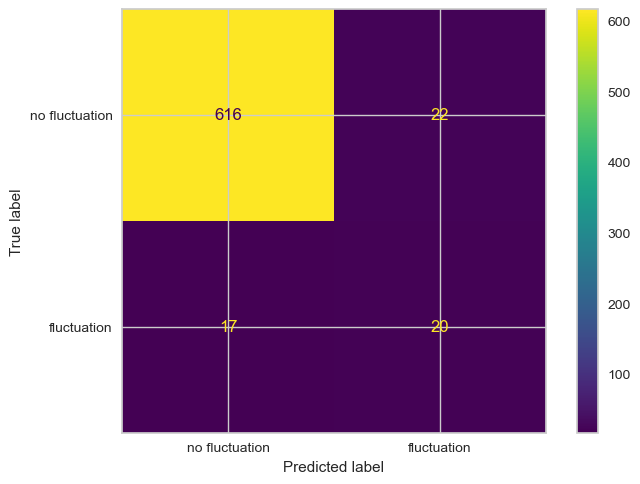

In [262]:
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix(y_pred['true'],y_pred['pred']), display_labels = ['no fluctuation','fluctuation'])
cm_display.plot()
plt.show()

## INVERTER3

In [263]:
dfi = df[df['id']=='inverter3'].copy()
dfi = dfi.drop('id',axis=1)

dfi = dfi.set_index('datetime')
dfi['inverter_moving_average'] = dfi['inverter'].rolling(window=pd.Timedelta(hours=3),center=True).mean()
dfi['inverter_max'] = dfi['inverter'].rolling(window=pd.Timedelta(hours=24),center=True).max()
dfi['inverter_moving_average_max'] = dfi['inverter_moving_average'].rolling(window=pd.Timedelta(hours=24),center=True).max()

dfi['ratio'] = dfi['inverter_max']/dfi['inverter_moving_average_max']
dfi['inverter_moving_average'] = dfi['inverter_moving_average']*dfi['ratio']
dfi['inverter_moving_average'] = dfi.apply(lambda x: 0 if x['inverter']==0 else x['inverter_moving_average'],axis=1)

dfi['difference'] = abs(dfi['inverter_moving_average']-dfi['inverter'])
dfi['difference_max'] = dfi['difference'].rolling(window=pd.Timedelta(hours=12),center=True).max()
dfi['difference__maxx'] = dfi.apply(lambda x: x['difference'] if x['difference']==x['difference_max'] else 0, axis=1)

dfi['fluctuation'] = dfi['difference__maxx']>(dfi['inverter_max']*1/4)
dfi = dfi.reset_index()

dfi['fluct-1'] = dfi['fluctuation'].shift(-1)
dfi['fluct-2'] = dfi['fluctuation'].shift(-2)
dfi['fluct+1'] = dfi['fluctuation'].shift(1)
dfi['fluct+2'] = dfi['fluctuation'].shift(2)

dfi['fluctuation'] = dfi.apply(lambda x: x['fluct-1'] or x['fluct-2'] or x['fluctuation'] or x['fluct+1'] or x['fluct+2'],axis=1)
dfi['fluctuation'] = dfi['fluctuation'].fillna(False)

dfi = dfi.drop(['energy',
       'inverter_moving_average', 'inverter_max',
       'inverter_moving_average_max', 'ratio', 'difference', 'difference_max',
       'difference__maxx', 'fluct-1', 'fluct-2', 'fluct+1',
       'fluct+2','panel_size','inverter'],axis=1)

dfi['fluctuation'] = dfi['fluctuation'].astype(int)

data_train, data_test = train_test_split(dfi, test_size=0.2, random_state=1)
data_test = data_test.sort_values('datetime')

data_train = data_train.drop('datetime',axis=1)
data_test = data_test.drop('datetime',axis=1)

X_train = data_train.drop('fluctuation',axis=1)
y_train = data_train[['fluctuation']]

X_test = data_test.drop('fluctuation',axis=1)
y_test = data_test[['fluctuation']]

In [264]:
def _(doc):
    return doc

def objective(trial):

    lgbm_max_depth = trial.suggest_int("max_depth", 3, 30)
    lgbm_n_estimators = trial.suggest_int("n_estimators", 100, 500)
    lgbm_learning_rate = trial.suggest_float("learning_rate", 0.01, 0.3)
    lgbm_num_leaves = trial.suggest_int("num_leaves", 20, 3000, step=20)
    lgbm_min_data_in_leaf = trial.suggest_int("min_data_in_leaf", 200, 10000, step=100)
    lgbm_lambda_l1 = trial.suggest_int("lambda_l1", 0, 100, step=5)
    lgbm_lambda_l2 = trial.suggest_int("lambda_l2", 0, 100, step=5)

    lgbm_cl = LGBMClassifier(class_weight = 'balanced',max_depth = lgbm_max_depth,n_estimators = lgbm_n_estimators,
                             learning_rate=lgbm_learning_rate,num_leaves=lgbm_num_leaves,min_data_in_leaf=lgbm_min_data_in_leaf,
                             lambda_l1=lgbm_lambda_l1,lambda_l2=lgbm_lambda_l2,random_state = 1,n_jobs = -1)

    cv = KFold(n_splits=5, shuffle=True, random_state=1)

    scores = cross_val_score(lgbm_cl, X_train, y_train, cv=cv, scoring = 'f1')

    return scores.mean()

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=200, n_jobs = -1, show_progress_bar=True)

print("Best trial:")
best_trial = study.best_trial
print("  Value: ", best_trial.value)
print("  Params: ")
for key, value in best_trial.params.items():
    print("    {}: {}".format(key, value))

[I 2024-07-26 13:32:48,510] A new study created in memory with name: no-name-564c481b-f053-4ec4-bbfc-c81069e10e67


  0%|          | 0/200 [00:00<?, ?it/s]

[I 2024-07-26 13:32:51,571] Trial 11 finished with value: 0.04410091250670961 and parameters: {'max_depth': 11, 'n_estimators': 111, 'learning_rate': 0.21850671172235592, 'num_leaves': 540, 'min_data_in_leaf': 6200, 'lambda_l1': 85, 'lambda_l2': 55}. Best is trial 11 with value: 0.04410091250670961.
[I 2024-07-26 13:32:52,399] Trial 3 finished with value: 0.04410091250670961 and parameters: {'max_depth': 17, 'n_estimators': 146, 'learning_rate': 0.02338909062941809, 'num_leaves': 2560, 'min_data_in_leaf': 2100, 'lambda_l1': 5, 'lambda_l2': 95}. Best is trial 11 with value: 0.04410091250670961.
[I 2024-07-26 13:32:53,332] Trial 6 finished with value: 0.04410091250670961 and parameters: {'max_depth': 20, 'n_estimators': 176, 'learning_rate': 0.08862848221572923, 'num_leaves': 2740, 'min_data_in_leaf': 3500, 'lambda_l1': 60, 'lambda_l2': 90}. Best is trial 11 with value: 0.04410091250670961.
[I 2024-07-26 13:32:55,880] Trial 1 finished with value: 0.04410091250670961 and parameters: {'max

[I 2024-07-26 13:33:14,679] Trial 30 finished with value: 0.04410091250670961 and parameters: {'max_depth': 6, 'n_estimators': 362, 'learning_rate': 0.13515946397456802, 'num_leaves': 2960, 'min_data_in_leaf': 7200, 'lambda_l1': 100, 'lambda_l2': 30}. Best is trial 27 with value: 0.2798694061659125.
[I 2024-07-26 13:33:15,379] Trial 33 finished with value: 0.04410091250670961 and parameters: {'max_depth': 21, 'n_estimators': 266, 'learning_rate': 0.051146756667575705, 'num_leaves': 2980, 'min_data_in_leaf': 5400, 'lambda_l1': 100, 'lambda_l2': 40}. Best is trial 27 with value: 0.2798694061659125.
[I 2024-07-26 13:33:20,030] Trial 28 finished with value: 0.2850809022648433 and parameters: {'max_depth': 5, 'n_estimators': 227, 'learning_rate': 0.1320255944139757, 'num_leaves': 1920, 'min_data_in_leaf': 300, 'lambda_l1': 100, 'lambda_l2': 5}. Best is trial 28 with value: 0.2850809022648433.
[I 2024-07-26 13:33:22,276] Trial 31 finished with value: 0.28855104402636506 and parameters: {'max

[I 2024-07-26 13:33:41,209] Trial 56 finished with value: 0.04410091250670961 and parameters: {'max_depth': 15, 'n_estimators': 297, 'learning_rate': 0.27264353474810044, 'num_leaves': 280, 'min_data_in_leaf': 1300, 'lambda_l1': 55, 'lambda_l2': 20}. Best is trial 38 with value: 0.335533186156306.
[I 2024-07-26 13:33:41,573] Trial 60 finished with value: 0.04410091250670961 and parameters: {'max_depth': 17, 'n_estimators': 296, 'learning_rate': 0.2778293167138793, 'num_leaves': 280, 'min_data_in_leaf': 1900, 'lambda_l1': 40, 'lambda_l2': 20}. Best is trial 38 with value: 0.335533186156306.
[I 2024-07-26 13:33:43,226] Trial 62 finished with value: 0.04410091250670961 and parameters: {'max_depth': 17, 'n_estimators': 291, 'learning_rate': 0.2728661785884862, 'num_leaves': 300, 'min_data_in_leaf': 1900, 'lambda_l1': 40, 'lambda_l2': 20}. Best is trial 38 with value: 0.335533186156306.
[I 2024-07-26 13:33:44,015] Trial 59 finished with value: 0.04410091250670961 and parameters: {'max_depth

[I 2024-07-26 13:34:28,674] Trial 87 finished with value: 0.3037789215645906 and parameters: {'max_depth': 11, 'n_estimators': 313, 'learning_rate': 0.21937997152365474, 'num_leaves': 860, 'min_data_in_leaf': 1000, 'lambda_l1': 30, 'lambda_l2': 0}. Best is trial 38 with value: 0.335533186156306.
[I 2024-07-26 13:34:28,978] Trial 90 finished with value: 0.353834240274443 and parameters: {'max_depth': 11, 'n_estimators': 311, 'learning_rate': 0.2182161852956321, 'num_leaves': 1000, 'min_data_in_leaf': 500, 'lambda_l1': 30, 'lambda_l2': 0}. Best is trial 90 with value: 0.353834240274443.
[I 2024-07-26 13:34:29,833] Trial 85 finished with value: 0.30519754730242565 and parameters: {'max_depth': 11, 'n_estimators': 379, 'learning_rate': 0.21758849629651214, 'num_leaves': 860, 'min_data_in_leaf': 900, 'lambda_l1': 30, 'lambda_l2': 0}. Best is trial 90 with value: 0.353834240274443.
[I 2024-07-26 13:34:29,991] Trial 86 finished with value: 0.299411082300445 and parameters: {'max_depth': 10, '

[I 2024-07-26 13:35:21,185] Trial 108 finished with value: 0.3819332557579561 and parameters: {'max_depth': 13, 'n_estimators': 307, 'learning_rate': 0.28623145509344333, 'num_leaves': 1080, 'min_data_in_leaf': 500, 'lambda_l1': 15, 'lambda_l2': 15}. Best is trial 109 with value: 0.40008405243566647.
[I 2024-07-26 13:35:22,662] Trial 111 finished with value: 0.3784679123995515 and parameters: {'max_depth': 13, 'n_estimators': 276, 'learning_rate': 0.17184394046800996, 'num_leaves': 1100, 'min_data_in_leaf': 500, 'lambda_l1': 15, 'lambda_l2': 15}. Best is trial 109 with value: 0.40008405243566647.
[I 2024-07-26 13:35:23,782] Trial 117 finished with value: 0.04410091250670961 and parameters: {'max_depth': 13, 'n_estimators': 452, 'learning_rate': 0.1613961898193891, 'num_leaves': 1180, 'min_data_in_leaf': 4000, 'lambda_l1': 20, 'lambda_l2': 15}. Best is trial 109 with value: 0.40008405243566647.
[I 2024-07-26 13:35:23,806] Trial 118 finished with value: 0.04410091250670961 and parameters

[I 2024-07-26 13:36:34,443] Trial 149 finished with value: 0.04410091250670961 and parameters: {'max_depth': 18, 'n_estimators': 245, 'learning_rate': 0.29850538947682603, 'num_leaves': 1600, 'min_data_in_leaf': 10000, 'lambda_l1': 5, 'lambda_l2': 45}. Best is trial 139 with value: 0.49034018266642176.
[I 2024-07-26 13:36:36,081] Trial 143 finished with value: 0.4814042470036477 and parameters: {'max_depth': 18, 'n_estimators': 283, 'learning_rate': 0.29375374398094833, 'num_leaves': 1580, 'min_data_in_leaf': 200, 'lambda_l1': 5, 'lambda_l2': 35}. Best is trial 139 with value: 0.49034018266642176.
[I 2024-07-26 13:36:40,230] Trial 140 finished with value: 0.48393178237490153 and parameters: {'max_depth': 16, 'n_estimators': 244, 'learning_rate': 0.29029454675137284, 'num_leaves': 1700, 'min_data_in_leaf': 200, 'lambda_l1': 5, 'lambda_l2': 45}. Best is trial 139 with value: 0.49034018266642176.
[I 2024-07-26 13:36:40,964] Trial 141 finished with value: 0.4837146070030648 and parameters:

[I 2024-07-26 13:37:58,101] Trial 170 finished with value: 0.3952777194992711 and parameters: {'max_depth': 19, 'n_estimators': 286, 'learning_rate': 0.2920199905225669, 'num_leaves': 1460, 'min_data_in_leaf': 700, 'lambda_l1': 5, 'lambda_l2': 40}. Best is trial 148 with value: 0.4957792947366101.
[I 2024-07-26 13:37:59,309] Trial 162 finished with value: 0.49317947554151614 and parameters: {'max_depth': 19, 'n_estimators': 217, 'learning_rate': 0.29224447964571937, 'num_leaves': 1800, 'min_data_in_leaf': 200, 'lambda_l1': 5, 'lambda_l2': 50}. Best is trial 148 with value: 0.4957792947366101.
[I 2024-07-26 13:38:06,989] Trial 171 finished with value: 0.3932583213185559 and parameters: {'max_depth': 17, 'n_estimators': 285, 'learning_rate': 0.27895639709902337, 'num_leaves': 1440, 'min_data_in_leaf': 700, 'lambda_l1': 5, 'lambda_l2': 40}. Best is trial 148 with value: 0.4957792947366101.
[I 2024-07-26 13:38:08,444] Trial 180 finished with value: 0.04410091250670961 and parameters: {'max

[I 2024-07-26 13:39:49,925] Trial 195 finished with value: 0.4818446582160261 and parameters: {'max_depth': 15, 'n_estimators': 299, 'learning_rate': 0.29855898424024097, 'num_leaves': 1660, 'min_data_in_leaf': 400, 'lambda_l1': 0, 'lambda_l2': 45}. Best is trial 182 with value: 0.504776510039668.
[I 2024-07-26 13:39:49,954] Trial 196 finished with value: 0.48588493461900895 and parameters: {'max_depth': 22, 'n_estimators': 305, 'learning_rate': 0.2862739225616898, 'num_leaves': 1640, 'min_data_in_leaf': 400, 'lambda_l1': 0, 'lambda_l2': 45}. Best is trial 182 with value: 0.504776510039668.
[I 2024-07-26 13:39:50,770] Trial 198 finished with value: 0.48640973847270236 and parameters: {'max_depth': 21, 'n_estimators': 301, 'learning_rate': 0.29835349417199547, 'num_leaves': 1780, 'min_data_in_leaf': 400, 'lambda_l1': 0, 'lambda_l2': 45}. Best is trial 182 with value: 0.504776510039668.
[I 2024-07-26 13:39:51,045] Trial 199 finished with value: 0.48557854160317493 and parameters: {'max_d

In [265]:
best_trial.params

{'max_depth': 21,
 'n_estimators': 299,
 'learning_rate': 0.29972561182592056,
 'num_leaves': 1640,
 'min_data_in_leaf': 300,
 'lambda_l1': 0,
 'lambda_l2': 45}

{'max_depth': 21,
 'n_estimators': 299,
 'learning_rate': 0.29972561182592056,
 'num_leaves': 1640,
 'min_data_in_leaf': 300,
 'lambda_l1': 0,
 'lambda_l2': 45}

In [266]:
lgbm = LGBMClassifier(class_weight='balanced', **best_trial.params, random_state=1, n_jobs=-1)

cv = KFold(n_splits=5, shuffle=True, random_state=1)

scores = cross_val_score(lgbm, X_train, y_train, cv=cv, scoring = 'f1')

print(scores)
print(scores.mean())

[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Info] Number of positive: 114, number of negative: 2044
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001556 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4957
[LightGBM] [Info] Number of data points in the train set: 2158, number of used feature

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Info] Number 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of data points in the train set: 2159, number of used features: 26
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=-0.000000
[LightGBM] [Info] Start training from score -0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

In [267]:
lgbm = LGBMClassifier(class_weight='balanced', **best_trial.params, random_state=1, n_jobs=-1)

lgbm.fit(X_train,y_train)

y_pred = lgbm.predict(X_test)

y_pred = pd.DataFrame({'pred':y_pred,'true':y_test['fluctuation']})

[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Info] Number of positive: 147, number of negative: 2551
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001161 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5047
[LightGBM] [Info] Number of data points in the train set: 2698, number of used feature

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45


In [268]:
print(classification_report(y_pred['true'],y_pred['pred']))

              precision    recall  f1-score   support

           0       0.98      0.94      0.96       634
           1       0.43      0.68      0.53        41

    accuracy                           0.93       675
   macro avg       0.70      0.81      0.74       675
weighted avg       0.95      0.93      0.93       675



In [269]:
confusion_matrix(y_pred['true'],y_pred['pred'])

array([[597,  37],
       [ 13,  28]], dtype=int64)

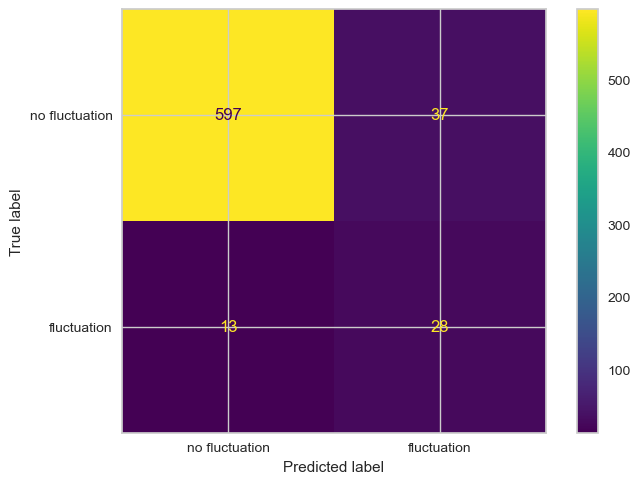

In [270]:
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix(y_pred['true'],y_pred['pred']), display_labels = ['no fluctuation','fluctuation'])
cm_display.plot()
plt.show()

# LGBM huperparameter tuning - recall

## INVERTER1

In [271]:
dfi = df[df['id']=='inverter1'].copy()
dfi = dfi.drop('id',axis=1)

dfi = dfi.set_index('datetime')
dfi['inverter_moving_average'] = dfi['inverter'].rolling(window=pd.Timedelta(hours=3),center=True).mean()
dfi['inverter_max'] = dfi['inverter'].rolling(window=pd.Timedelta(hours=24),center=True).max()
dfi['inverter_moving_average_max'] = dfi['inverter_moving_average'].rolling(window=pd.Timedelta(hours=24),center=True).max()

dfi['ratio'] = dfi['inverter_max']/dfi['inverter_moving_average_max']
dfi['inverter_moving_average'] = dfi['inverter_moving_average']*dfi['ratio']
dfi['inverter_moving_average'] = dfi.apply(lambda x: 0 if x['inverter']==0 else x['inverter_moving_average'],axis=1)

dfi['difference'] = abs(dfi['inverter_moving_average']-dfi['inverter'])
dfi['difference_max'] = dfi['difference'].rolling(window=pd.Timedelta(hours=12),center=True).max()
dfi['difference__maxx'] = dfi.apply(lambda x: x['difference'] if x['difference']==x['difference_max'] else 0, axis=1)

dfi['fluctuation'] = dfi['difference__maxx']>(dfi['inverter_max']*1/4)
dfi = dfi.reset_index()

dfi['fluct-1'] = dfi['fluctuation'].shift(-1)
dfi['fluct-2'] = dfi['fluctuation'].shift(-2)
dfi['fluct+1'] = dfi['fluctuation'].shift(1)
dfi['fluct+2'] = dfi['fluctuation'].shift(2)

dfi['fluctuation'] = dfi.apply(lambda x: x['fluct-1'] or x['fluct-2'] or x['fluctuation'] or x['fluct+1'] or x['fluct+2'],axis=1)
dfi['fluctuation'] = dfi['fluctuation'].fillna(False)

dfi = dfi.drop(['energy',
       'inverter_moving_average', 'inverter_max',
       'inverter_moving_average_max', 'ratio', 'difference', 'difference_max',
       'difference__maxx', 'fluct-1', 'fluct-2', 'fluct+1',
       'fluct+2','panel_size','inverter'],axis=1)

dfi['fluctuation'] = dfi['fluctuation'].astype(int)

data_train, data_test = train_test_split(dfi, test_size=0.2, random_state=1)
data_test = data_test.sort_values('datetime')

data_train = data_train.drop('datetime',axis=1)
data_test = data_test.drop('datetime',axis=1)

X_train = data_train.drop('fluctuation',axis=1)
y_train = data_train[['fluctuation']]

X_test = data_test.drop('fluctuation',axis=1)
y_test = data_test[['fluctuation']]

In [272]:
def _(doc):
    return doc

def objective(trial):

    lgbm_max_depth = trial.suggest_int("max_depth", 3, 30)
    lgbm_n_estimators = trial.suggest_int("n_estimators", 100, 500)
    lgbm_learning_rate = trial.suggest_float("learning_rate", 0.01, 0.3)
    lgbm_num_leaves = trial.suggest_int("num_leaves", 20, 3000, step=20)
    lgbm_min_data_in_leaf = trial.suggest_int("min_data_in_leaf", 200, 10000, step=100)
    lgbm_lambda_l1 = trial.suggest_int("lambda_l1", 0, 100, step=5)
    lgbm_lambda_l2 = trial.suggest_int("lambda_l2", 0, 100, step=5)

    lgbm_cl = LGBMClassifier(class_weight = 'balanced',max_depth = lgbm_max_depth,n_estimators = lgbm_n_estimators,
                             learning_rate=lgbm_learning_rate,num_leaves=lgbm_num_leaves,min_data_in_leaf=lgbm_min_data_in_leaf,
                             lambda_l1=lgbm_lambda_l1,lambda_l2=lgbm_lambda_l2,random_state = 1,n_jobs = -1)

    cv = KFold(n_splits=5, shuffle=True, random_state=1)

    scores = cross_val_score(lgbm_cl, X_train, y_train, cv=cv, scoring = 'recall')

    return scores.mean()

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=200, n_jobs = -1, show_progress_bar=True)

print("Best trial:")
best_trial = study.best_trial
print("  Value: ", best_trial.value)
print("  Params: ")
for key, value in best_trial.params.items():
    print("    {}: {}".format(key, value))

[I 2024-07-26 13:53:23,153] A new study created in memory with name: no-name-5138aa6a-1100-41c2-9c66-6577eab7ff88


  0%|          | 0/200 [00:00<?, ?it/s]

[I 2024-07-26 13:53:25,414] Trial 2 finished with value: 0.8 and parameters: {'max_depth': 28, 'n_estimators': 121, 'learning_rate': 0.21158771209853916, 'num_leaves': 580, 'min_data_in_leaf': 2100, 'lambda_l1': 20, 'lambda_l2': 40}. Best is trial 2 with value: 0.8.
[I 2024-07-26 13:53:26,100] Trial 9 finished with value: 0.8 and parameters: {'max_depth': 9, 'n_estimators': 156, 'learning_rate': 0.1557417995782718, 'num_leaves': 2540, 'min_data_in_leaf': 9700, 'lambda_l1': 80, 'lambda_l2': 55}. Best is trial 2 with value: 0.8.
[I 2024-07-26 13:53:26,221] Trial 6 finished with value: 0.8 and parameters: {'max_depth': 16, 'n_estimators': 145, 'learning_rate': 0.26031257223099735, 'num_leaves': 1060, 'min_data_in_leaf': 2800, 'lambda_l1': 100, 'lambda_l2': 40}. Best is trial 2 with value: 0.8.
[I 2024-07-26 13:53:26,720] Trial 1 finished with value: 0.8 and parameters: {'max_depth': 19, 'n_estimators': 220, 'learning_rate': 0.023244714074447538, 'num_leaves': 1760, 'min_data_in_leaf': 660

[I 2024-07-26 13:53:36,397] Trial 33 finished with value: 0.8 and parameters: {'max_depth': 13, 'n_estimators': 161, 'learning_rate': 0.19173852362452978, 'num_leaves': 640, 'min_data_in_leaf': 4500, 'lambda_l1': 10, 'lambda_l2': 30}. Best is trial 2 with value: 0.8.
[I 2024-07-26 13:53:36,667] Trial 32 finished with value: 0.8 and parameters: {'max_depth': 13, 'n_estimators': 188, 'learning_rate': 0.1920161457916534, 'num_leaves': 700, 'min_data_in_leaf': 4100, 'lambda_l1': 0, 'lambda_l2': 30}. Best is trial 2 with value: 0.8.
[I 2024-07-26 13:53:36,900] Trial 34 finished with value: 0.8 and parameters: {'max_depth': 14, 'n_estimators': 176, 'learning_rate': 0.2056990445189085, 'num_leaves': 780, 'min_data_in_leaf': 4400, 'lambda_l1': 10, 'lambda_l2': 35}. Best is trial 2 with value: 0.8.
[I 2024-07-26 13:53:36,974] Trial 31 finished with value: 0.8 and parameters: {'max_depth': 14, 'n_estimators': 201, 'learning_rate': 0.012221783588356709, 'num_leaves': 820, 'min_data_in_leaf': 4700

[I 2024-07-26 13:54:09,249] Trial 55 finished with value: 0.8324888926862611 and parameters: {'max_depth': 16, 'n_estimators': 248, 'learning_rate': 0.17196740307108305, 'num_leaves': 920, 'min_data_in_leaf': 500, 'lambda_l1': 10, 'lambda_l2': 20}. Best is trial 48 with value: 0.9195616883116884.
[I 2024-07-26 13:54:09,551] Trial 42 finished with value: 0.795555650489861 and parameters: {'max_depth': 11, 'n_estimators': 326, 'learning_rate': 0.19870139463250833, 'num_leaves': 2820, 'min_data_in_leaf': 200, 'lambda_l1': 10, 'lambda_l2': 30}. Best is trial 48 with value: 0.9195616883116884.
[I 2024-07-26 13:54:09,635] Trial 64 finished with value: 0.9029747664616086 and parameters: {'max_depth': 7, 'n_estimators': 139, 'learning_rate': 0.1365671470004334, 'num_leaves': 260, 'min_data_in_leaf': 800, 'lambda_l1': 30, 'lambda_l2': 15}. Best is trial 48 with value: 0.9195616883116884.
[I 2024-07-26 13:54:09,763] Trial 60 finished with value: 0.898509056732741 and parameters: {'max_depth': 11

[I 2024-07-26 13:54:25,271] Trial 90 finished with value: 0.9195616883116884 and parameters: {'max_depth': 29, 'n_estimators': 186, 'learning_rate': 0.16009720988416362, 'num_leaves': 580, 'min_data_in_leaf': 700, 'lambda_l1': 30, 'lambda_l2': 0}. Best is trial 48 with value: 0.9195616883116884.
[I 2024-07-26 13:54:25,463] Trial 93 finished with value: 0.8747792777398041 and parameters: {'max_depth': 5, 'n_estimators': 181, 'learning_rate': 0.16042623907866288, 'num_leaves': 540, 'min_data_in_leaf': 800, 'lambda_l1': 20, 'lambda_l2': 0}. Best is trial 48 with value: 0.9195616883116884.
[I 2024-07-26 13:54:25,512] Trial 92 finished with value: 0.9018925153793574 and parameters: {'max_depth': 9, 'n_estimators': 187, 'learning_rate': 0.15867250475239553, 'num_leaves': 2500, 'min_data_in_leaf': 700, 'lambda_l1': 20, 'lambda_l2': 15}. Best is trial 48 with value: 0.9195616883116884.
[I 2024-07-26 13:54:27,268] Trial 97 finished with value: 0.9195616883116884 and parameters: {'max_depth': 29

[I 2024-07-26 13:54:48,215] Trial 120 finished with value: 0.8 and parameters: {'max_depth': 5, 'n_estimators': 386, 'learning_rate': 0.06105204164999467, 'num_leaves': 620, 'min_data_in_leaf': 1400, 'lambda_l1': 50, 'lambda_l2': 5}. Best is trial 48 with value: 0.9195616883116884.
[I 2024-07-26 13:54:48,812] Trial 121 finished with value: 0.8 and parameters: {'max_depth': 26, 'n_estimators': 370, 'learning_rate': 0.1817213065103665, 'num_leaves': 640, 'min_data_in_leaf': 3000, 'lambda_l1': 50, 'lambda_l2': 5}. Best is trial 48 with value: 0.9195616883116884.
[I 2024-07-26 13:54:48,913] Trial 113 finished with value: 0.8089499316473001 and parameters: {'max_depth': 4, 'n_estimators': 419, 'learning_rate': 0.09241241165927369, 'num_leaves': 1560, 'min_data_in_leaf': 1000, 'lambda_l1': 55, 'lambda_l2': 5}. Best is trial 48 with value: 0.9195616883116884.
[I 2024-07-26 13:54:48,960] Trial 119 finished with value: 0.8 and parameters: {'max_depth': 5, 'n_estimators': 427, 'learning_rate': 0

[I 2024-07-26 13:55:12,979] Trial 150 finished with value: 0.8 and parameters: {'max_depth': 26, 'n_estimators': 270, 'learning_rate': 0.19995527399328247, 'num_leaves': 700, 'min_data_in_leaf': 3800, 'lambda_l1': 80, 'lambda_l2': 10}. Best is trial 127 with value: 0.9256222943722945.
[I 2024-07-26 13:55:13,820] Trial 143 finished with value: 0.9150959785828207 and parameters: {'max_depth': 30, 'n_estimators': 405, 'learning_rate': 0.16435578866846226, 'num_leaves': 800, 'min_data_in_leaf': 400, 'lambda_l1': 65, 'lambda_l2': 10}. Best is trial 127 with value: 0.9256222943722945.
[I 2024-07-26 13:55:14,549] Trial 145 finished with value: 0.9150959785828207 and parameters: {'max_depth': 24, 'n_estimators': 289, 'learning_rate': 0.1979565609888264, 'num_leaves': 860, 'min_data_in_leaf': 400, 'lambda_l1': 80, 'lambda_l2': 40}. Best is trial 127 with value: 0.9256222943722945.
[I 2024-07-26 13:55:15,131] Trial 149 finished with value: 0.8 and parameters: {'max_depth': 30, 'n_estimators': 36

[I 2024-07-26 13:55:46,746] Trial 173 finished with value: 0.9195616883116884 and parameters: {'max_depth': 26, 'n_estimators': 310, 'learning_rate': 0.23545062430919086, 'num_leaves': 680, 'min_data_in_leaf': 600, 'lambda_l1': 100, 'lambda_l2': 15}. Best is trial 146 with value: 0.9316829004329005.
[I 2024-07-26 13:55:47,180] Trial 181 finished with value: 0.8 and parameters: {'max_depth': 22, 'n_estimators': 302, 'learning_rate': 0.17743637425421271, 'num_leaves': 740, 'min_data_in_leaf': 1200, 'lambda_l1': 95, 'lambda_l2': 20}. Best is trial 146 with value: 0.9316829004329005.
[I 2024-07-26 13:55:47,374] Trial 174 finished with value: 0.9195616883116884 and parameters: {'max_depth': 26, 'n_estimators': 303, 'learning_rate': 0.21343365637690875, 'num_leaves': 740, 'min_data_in_leaf': 600, 'lambda_l1': 100, 'lambda_l2': 20}. Best is trial 146 with value: 0.9316829004329005.
[I 2024-07-26 13:55:48,138] Trial 175 finished with value: 0.9256222943722945 and parameters: {'max_depth': 26, 

In [273]:
best_trial.params

{'max_depth': 24,
 'n_estimators': 275,
 'learning_rate': 0.20745349475556363,
 'num_leaves': 680,
 'min_data_in_leaf': 400,
 'lambda_l1': 90,
 'lambda_l2': 10}

{'max_depth': 24,
 'n_estimators': 275,
 'learning_rate': 0.20745349475556363,
 'num_leaves': 680,
 'min_data_in_leaf': 400,
 'lambda_l1': 90,
 'lambda_l2': 10}

In [274]:
lgbm = LGBMClassifier(class_weight='balanced', **best_trial.params, random_state=1, n_jobs=-1)

cv = KFold(n_splits=5, shuffle=True, random_state=1)

scores = cross_val_score(lgbm, X_train, y_train, cv=cv, scoring = 'recall')

print(scores)
print(scores.mean())

[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] lambda_l1 is set=90, reg_alpha=0.0 will be ignored. Current value: lambda_l1=90
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] lambda_l1 is set=90, reg_alpha=0.0 will be ignored. Current value: lambda_l1=90
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Info] Number of positive: 112, number of negative: 2046
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001480 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4957
[LightGBM] [Info] Number of data points in the train set: 2158, number of used fea

[LightGBM] [Info] Number of data points in the train set: 2158, number of used features: 26
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=-0.000000
[LightGBM] [Info] Start training from score -0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

In [275]:
lgbm = LGBMClassifier(class_weight='balanced', **best_trial.params, random_state=1, n_jobs=-1)

lgbm.fit(X_train,y_train)

y_pred = lgbm.predict(X_test)

y_pred = pd.DataFrame({'pred':y_pred,'true':y_test['fluctuation']})

[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] lambda_l1 is set=90, reg_alpha=0.0 will be ignored. Current value: lambda_l1=90
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] lambda_l1 is set=90, reg_alpha=0.0 will be ignored. Current value: lambda_l1=90
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Info] Number of positive: 145, number of negative: 2553
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001932 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5047
[LightGBM] [Info] Number of data points in the train set: 2698, number of used fea

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[

In [276]:
print(classification_report(y_pred['true'],y_pred['pred']))

              precision    recall  f1-score   support

           0       0.99      0.74      0.85       637
           1       0.17      0.87      0.28        38

    accuracy                           0.75       675
   macro avg       0.58      0.81      0.57       675
weighted avg       0.94      0.75      0.82       675



In [277]:
confusion_matrix(y_pred['true'],y_pred['pred'])

array([[474, 163],
       [  5,  33]], dtype=int64)

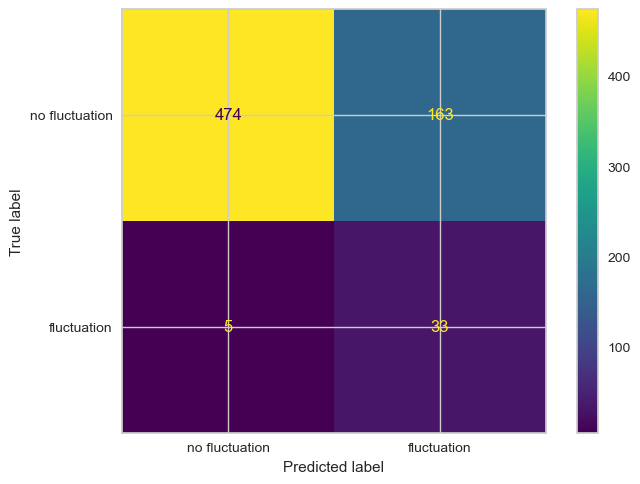

In [278]:
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix(y_pred['true'],y_pred['pred']), display_labels = ['no fluctuation','fluctuation'])
cm_display.plot()
plt.show()

## INVERTER2

In [279]:
dfi = df[df['id']=='inverter2'].copy()
dfi = dfi.drop('id',axis=1)

dfi = dfi.set_index('datetime')
dfi['inverter_moving_average'] = dfi['inverter'].rolling(window=pd.Timedelta(hours=3),center=True).mean()
dfi['inverter_max'] = dfi['inverter'].rolling(window=pd.Timedelta(hours=24),center=True).max()
dfi['inverter_moving_average_max'] = dfi['inverter_moving_average'].rolling(window=pd.Timedelta(hours=24),center=True).max()

dfi['ratio'] = dfi['inverter_max']/dfi['inverter_moving_average_max']
dfi['inverter_moving_average'] = dfi['inverter_moving_average']*dfi['ratio']
dfi['inverter_moving_average'] = dfi.apply(lambda x: 0 if x['inverter']==0 else x['inverter_moving_average'],axis=1)

dfi['difference'] = abs(dfi['inverter_moving_average']-dfi['inverter'])
dfi['difference_max'] = dfi['difference'].rolling(window=pd.Timedelta(hours=12),center=True).max()
dfi['difference__maxx'] = dfi.apply(lambda x: x['difference'] if x['difference']==x['difference_max'] else 0, axis=1)

dfi['fluctuation'] = dfi['difference__maxx']>(dfi['inverter_max']*1/4)
dfi = dfi.reset_index()

dfi['fluct-1'] = dfi['fluctuation'].shift(-1)
dfi['fluct-2'] = dfi['fluctuation'].shift(-2)
dfi['fluct+1'] = dfi['fluctuation'].shift(1)
dfi['fluct+2'] = dfi['fluctuation'].shift(2)

dfi['fluctuation'] = dfi.apply(lambda x: x['fluct-1'] or x['fluct-2'] or x['fluctuation'] or x['fluct+1'] or x['fluct+2'],axis=1)
dfi['fluctuation'] = dfi['fluctuation'].fillna(False)

dfi = dfi.drop(['energy',
       'inverter_moving_average', 'inverter_max',
       'inverter_moving_average_max', 'ratio', 'difference', 'difference_max',
       'difference__maxx', 'fluct-1', 'fluct-2', 'fluct+1',
       'fluct+2','panel_size','inverter'],axis=1)

dfi['fluctuation'] = dfi['fluctuation'].astype(int)

data_train, data_test = train_test_split(dfi, test_size=0.2, random_state=1)
data_test = data_test.sort_values('datetime')

data_train = data_train.drop('datetime',axis=1)
data_test = data_test.drop('datetime',axis=1)

X_train = data_train.drop('fluctuation',axis=1)
y_train = data_train[['fluctuation']]

X_test = data_test.drop('fluctuation',axis=1)
y_test = data_test[['fluctuation']]

In [280]:
def _(doc):
    return doc

def objective(trial):

    lgbm_max_depth = trial.suggest_int("max_depth", 3, 30)
    lgbm_n_estimators = trial.suggest_int("n_estimators", 100, 500)
    lgbm_learning_rate = trial.suggest_float("learning_rate", 0.01, 0.3)
    lgbm_num_leaves = trial.suggest_int("num_leaves", 20, 3000, step=20)
    lgbm_min_data_in_leaf = trial.suggest_int("min_data_in_leaf", 200, 10000, step=100)
    lgbm_lambda_l1 = trial.suggest_int("lambda_l1", 0, 100, step=5)
    lgbm_lambda_l2 = trial.suggest_int("lambda_l2", 0, 100, step=5)

    lgbm_cl = LGBMClassifier(class_weight = 'balanced',max_depth = lgbm_max_depth,n_estimators = lgbm_n_estimators,
                             learning_rate=lgbm_learning_rate,num_leaves=lgbm_num_leaves,min_data_in_leaf=lgbm_min_data_in_leaf,
                             lambda_l1=lgbm_lambda_l1,lambda_l2=lgbm_lambda_l2,random_state = 1,n_jobs = -1)

    cv = KFold(n_splits=5, shuffle=True, random_state=1)

    scores = cross_val_score(lgbm_cl, X_train, y_train, cv=cv, scoring = 'recall')

    return scores.mean()

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=200, n_jobs = -1, show_progress_bar=True)

print("Best trial:")
best_trial = study.best_trial
print("  Value: ", best_trial.value)
print("  Params: ")
for key, value in best_trial.params.items():
    print("    {}: {}".format(key, value))

[I 2024-07-26 13:56:04,143] A new study created in memory with name: no-name-4f8c024c-eb9a-425f-93d4-ad314a37f0b3


  0%|          | 0/200 [00:00<?, ?it/s]

[I 2024-07-26 13:56:06,652] Trial 7 finished with value: 0.2 and parameters: {'max_depth': 26, 'n_estimators': 124, 'learning_rate': 0.07942812641779506, 'num_leaves': 1620, 'min_data_in_leaf': 7200, 'lambda_l1': 50, 'lambda_l2': 5}. Best is trial 7 with value: 0.2.
[I 2024-07-26 13:56:06,887] Trial 5 finished with value: 0.2 and parameters: {'max_depth': 21, 'n_estimators': 148, 'learning_rate': 0.29503145469879427, 'num_leaves': 2700, 'min_data_in_leaf': 10000, 'lambda_l1': 25, 'lambda_l2': 15}. Best is trial 7 with value: 0.2.
[I 2024-07-26 13:56:07,139] Trial 2 finished with value: 0.2 and parameters: {'max_depth': 11, 'n_estimators': 159, 'learning_rate': 0.0500470445422841, 'num_leaves': 20, 'min_data_in_leaf': 6000, 'lambda_l1': 0, 'lambda_l2': 20}. Best is trial 7 with value: 0.2.
[I 2024-07-26 13:56:09,435] Trial 11 finished with value: 0.2 and parameters: {'max_depth': 20, 'n_estimators': 267, 'learning_rate': 0.08775789607037249, 'num_leaves': 620, 'min_data_in_leaf': 8800, 

[I 2024-07-26 13:56:33,749] Trial 33 finished with value: 0.9035997535997534 and parameters: {'max_depth': 10, 'n_estimators': 207, 'learning_rate': 0.14511039965626837, 'num_leaves': 2080, 'min_data_in_leaf': 700, 'lambda_l1': 90, 'lambda_l2': 30}. Best is trial 26 with value: 0.9145607145607144.
[I 2024-07-26 13:56:35,222] Trial 35 finished with value: 0.9145607145607144 and parameters: {'max_depth': 10, 'n_estimators': 224, 'learning_rate': 0.2506830549548291, 'num_leaves': 1440, 'min_data_in_leaf': 500, 'lambda_l1': 85, 'lambda_l2': 30}. Best is trial 26 with value: 0.9145607145607144.
[I 2024-07-26 13:56:36,163] Trial 41 finished with value: 0.2 and parameters: {'max_depth': 16, 'n_estimators': 214, 'learning_rate': 0.2467306806668274, 'num_leaves': 1420, 'min_data_in_leaf': 1800, 'lambda_l1': 85, 'lambda_l2': 25}. Best is trial 26 with value: 0.9145607145607144.
[I 2024-07-26 13:56:38,488] Trial 37 finished with value: 0.9045607145607146 and parameters: {'max_depth': 17, 'n_estim

[I 2024-07-26 13:57:18,695] Trial 55 finished with value: 0.9147108647108647 and parameters: {'max_depth': 11, 'n_estimators': 168, 'learning_rate': 0.12507625236652353, 'num_leaves': 2500, 'min_data_in_leaf': 200, 'lambda_l1': 80, 'lambda_l2': 20}. Best is trial 31 with value: 0.9201162701162702.
[I 2024-07-26 13:57:19,014] Trial 60 finished with value: 0.2 and parameters: {'max_depth': 23, 'n_estimators': 298, 'learning_rate': 0.07157621947474298, 'num_leaves': 1060, 'min_data_in_leaf': 1500, 'lambda_l1': 75, 'lambda_l2': 50}. Best is trial 31 with value: 0.9201162701162702.
[I 2024-07-26 13:57:19,099] Trial 63 finished with value: 0.2 and parameters: {'max_depth': 23, 'n_estimators': 172, 'learning_rate': 0.297861803470097, 'num_leaves': 2800, 'min_data_in_leaf': 1400, 'lambda_l1': 75, 'lambda_l2': 50}. Best is trial 31 with value: 0.9201162701162702.
[I 2024-07-26 13:57:19,697] Trial 61 finished with value: 0.2 and parameters: {'max_depth': 22, 'n_estimators': 293, 'learning_rate':

[I 2024-07-26 13:58:05,695] Trial 78 finished with value: 0.8120843920843921 and parameters: {'max_depth': 18, 'n_estimators': 180, 'learning_rate': 0.0983839016569591, 'num_leaves': 2580, 'min_data_in_leaf': 1000, 'lambda_l1': 55, 'lambda_l2': 10}. Best is trial 31 with value: 0.9201162701162702.
[I 2024-07-26 13:58:07,900] Trial 79 finished with value: 0.7991214291214291 and parameters: {'max_depth': 19, 'n_estimators': 170, 'learning_rate': 0.09393626049004741, 'num_leaves': 2600, 'min_data_in_leaf': 1000, 'lambda_l1': 65, 'lambda_l2': 20}. Best is trial 31 with value: 0.9201162701162702.
[I 2024-07-26 13:58:10,124] Trial 80 finished with value: 0.7991214291214291 and parameters: {'max_depth': 15, 'n_estimators': 175, 'learning_rate': 0.10684816979648507, 'num_leaves': 2600, 'min_data_in_leaf': 1000, 'lambda_l1': 70, 'lambda_l2': 20}. Best is trial 31 with value: 0.9201162701162702.
[I 2024-07-26 13:58:16,198] Trial 98 finished with value: 0.2 and parameters: {'max_depth': 30, 'n_es

[I 2024-07-26 13:59:35,148] Trial 113 finished with value: 0.9147108647108647 and parameters: {'max_depth': 9, 'n_estimators': 244, 'learning_rate': 0.12259653947532581, 'num_leaves': 1600, 'min_data_in_leaf': 200, 'lambda_l1': 80, 'lambda_l2': 30}. Best is trial 31 with value: 0.9201162701162702.
[I 2024-07-26 13:59:35,269] Trial 111 finished with value: 0.9147108647108647 and parameters: {'max_depth': 10, 'n_estimators': 242, 'learning_rate': 0.1442177382813753, 'num_leaves': 2480, 'min_data_in_leaf': 200, 'lambda_l1': 80, 'lambda_l2': 30}. Best is trial 31 with value: 0.9201162701162702.
[I 2024-07-26 13:59:37,460] Trial 117 finished with value: 0.9047108647108647 and parameters: {'max_depth': 9, 'n_estimators': 190, 'learning_rate': 0.20281124887013874, 'num_leaves': 1760, 'min_data_in_leaf': 200, 'lambda_l1': 80, 'lambda_l2': 30}. Best is trial 31 with value: 0.9201162701162702.
[I 2024-07-26 13:59:38,721] Trial 115 finished with value: 0.9147108647108647 and parameters: {'max_dep

[I 2024-07-26 14:00:58,804] Trial 142 finished with value: 0.9035997535997534 and parameters: {'max_depth': 18, 'n_estimators': 279, 'learning_rate': 0.13279449111689445, 'num_leaves': 2320, 'min_data_in_leaf': 500, 'lambda_l1': 90, 'lambda_l2': 25}. Best is trial 138 with value: 0.9255216755216754.
[I 2024-07-26 14:01:00,887] Trial 147 finished with value: 0.9145607145607144 and parameters: {'max_depth': 13, 'n_estimators': 208, 'learning_rate': 0.18778860532924338, 'num_leaves': 2200, 'min_data_in_leaf': 500, 'lambda_l1': 90, 'lambda_l2': 35}. Best is trial 138 with value: 0.9255216755216754.
[I 2024-07-26 14:01:01,533] Trial 136 finished with value: 0.9145607145607144 and parameters: {'max_depth': 18, 'n_estimators': 285, 'learning_rate': 0.15067981114972528, 'num_leaves': 2340, 'min_data_in_leaf': 500, 'lambda_l1': 85, 'lambda_l2': 55}. Best is trial 138 with value: 0.9255216755216754.
[I 2024-07-26 14:01:05,889] Trial 154 finished with value: 0.2 and parameters: {'max_depth': 18, 

[I 2024-07-26 14:01:48,411] Trial 174 finished with value: 0.2 and parameters: {'max_depth': 19, 'n_estimators': 321, 'learning_rate': 0.28677463735021835, 'num_leaves': 2100, 'min_data_in_leaf': 8400, 'lambda_l1': 75, 'lambda_l2': 65}. Best is trial 138 with value: 0.9255216755216754.
[I 2024-07-26 14:01:51,937] Trial 170 finished with value: 0.8593909293909293 and parameters: {'max_depth': 15, 'n_estimators': 196, 'learning_rate': 0.29085884280747776, 'num_leaves': 2240, 'min_data_in_leaf': 900, 'lambda_l1': 75, 'lambda_l2': 60}. Best is trial 138 with value: 0.9255216755216754.
[I 2024-07-26 14:01:52,812] Trial 180 finished with value: 0.2 and parameters: {'max_depth': 15, 'n_estimators': 198, 'learning_rate': 0.28266915390881675, 'num_leaves': 2080, 'min_data_in_leaf': 1200, 'lambda_l1': 65, 'lambda_l2': 50}. Best is trial 138 with value: 0.9255216755216754.
[I 2024-07-26 14:01:54,354] Trial 178 finished with value: 0.2 and parameters: {'max_depth': 15, 'n_estimators': 338, 'learni

In [281]:
best_trial.params

{'max_depth': 18,
 'n_estimators': 225,
 'learning_rate': 0.15281366483943934,
 'num_leaves': 20,
 'min_data_in_leaf': 500,
 'lambda_l1': 60,
 'lambda_l2': 55}

{'max_depth': 18,
 'n_estimators': 225,
 'learning_rate': 0.15281366483943934,
 'num_leaves': 20,
 'min_data_in_leaf': 500,
 'lambda_l1': 60,
 'lambda_l2': 55}

In [282]:
lgbm = LGBMClassifier(class_weight='balanced', **best_trial.params, random_state=1, n_jobs=-1)

cv = KFold(n_splits=5, shuffle=True, random_state=1)

scores = cross_val_score(lgbm, X_train, y_train, cv=cv, scoring = 'recall')

print(scores)
print(scores.mean())

[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Info] Number of positive: 109, number of negative: 2049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.079993 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4957
[LightGBM] [Info] 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

In [283]:
lgbm = LGBMClassifier(class_weight='balanced', **best_trial.params, random_state=1, n_jobs=-1)

lgbm.fit(X_train,y_train)

y_pred = lgbm.predict(X_test)

y_pred = pd.DataFrame({'pred':y_pred,'true':y_test['fluctuation']})

[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Info] Number of positive: 146, number of negative: 2552
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002949 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5047
[LightGBM] [Info] Number of data points in the train set: 2698, number of used fea

In [284]:
print(classification_report(y_pred['true'],y_pred['pred']))

              precision    recall  f1-score   support

           0       0.99      0.76      0.86       638
           1       0.17      0.84      0.28        37

    accuracy                           0.76       675
   macro avg       0.58      0.80      0.57       675
weighted avg       0.94      0.76      0.83       675



In [285]:
confusion_matrix(y_pred['true'],y_pred['pred'])

array([[484, 154],
       [  6,  31]], dtype=int64)

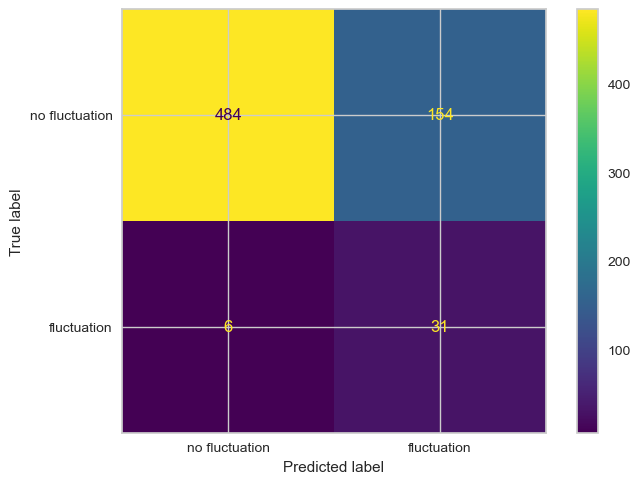

In [286]:
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix(y_pred['true'],y_pred['pred']), display_labels = ['no fluctuation','fluctuation'])
cm_display.plot()
plt.show()

## INVERTER3

In [287]:
dfi = df[df['id']=='inverter3'].copy()
dfi = dfi.drop('id',axis=1)

dfi = dfi.set_index('datetime')
dfi['inverter_moving_average'] = dfi['inverter'].rolling(window=pd.Timedelta(hours=3),center=True).mean()
dfi['inverter_max'] = dfi['inverter'].rolling(window=pd.Timedelta(hours=24),center=True).max()
dfi['inverter_moving_average_max'] = dfi['inverter_moving_average'].rolling(window=pd.Timedelta(hours=24),center=True).max()

dfi['ratio'] = dfi['inverter_max']/dfi['inverter_moving_average_max']
dfi['inverter_moving_average'] = dfi['inverter_moving_average']*dfi['ratio']
dfi['inverter_moving_average'] = dfi.apply(lambda x: 0 if x['inverter']==0 else x['inverter_moving_average'],axis=1)

dfi['difference'] = abs(dfi['inverter_moving_average']-dfi['inverter'])
dfi['difference_max'] = dfi['difference'].rolling(window=pd.Timedelta(hours=12),center=True).max()
dfi['difference__maxx'] = dfi.apply(lambda x: x['difference'] if x['difference']==x['difference_max'] else 0, axis=1)

dfi['fluctuation'] = dfi['difference__maxx']>(dfi['inverter_max']*1/4)
dfi = dfi.reset_index()

dfi['fluct-1'] = dfi['fluctuation'].shift(-1)
dfi['fluct-2'] = dfi['fluctuation'].shift(-2)
dfi['fluct+1'] = dfi['fluctuation'].shift(1)
dfi['fluct+2'] = dfi['fluctuation'].shift(2)

dfi['fluctuation'] = dfi.apply(lambda x: x['fluct-1'] or x['fluct-2'] or x['fluctuation'] or x['fluct+1'] or x['fluct+2'],axis=1)
dfi['fluctuation'] = dfi['fluctuation'].fillna(False)

dfi = dfi.drop(['energy',
       'inverter_moving_average', 'inverter_max',
       'inverter_moving_average_max', 'ratio', 'difference', 'difference_max',
       'difference__maxx', 'fluct-1', 'fluct-2', 'fluct+1',
       'fluct+2','panel_size','inverter'],axis=1)

dfi['fluctuation'] = dfi['fluctuation'].astype(int)

data_train, data_test = train_test_split(dfi, test_size=0.2, random_state=1)
data_test = data_test.sort_values('datetime')

data_train = data_train.drop('datetime',axis=1)
data_test = data_test.drop('datetime',axis=1)

X_train = data_train.drop('fluctuation',axis=1)
y_train = data_train[['fluctuation']]

X_test = data_test.drop('fluctuation',axis=1)
y_test = data_test[['fluctuation']]

In [288]:
def _(doc):
    return doc

def objective(trial):

    lgbm_max_depth = trial.suggest_int("max_depth", 3, 30)
    lgbm_n_estimators = trial.suggest_int("n_estimators", 100, 500)
    lgbm_learning_rate = trial.suggest_float("learning_rate", 0.01, 0.3)
    lgbm_num_leaves = trial.suggest_int("num_leaves", 20, 3000, step=20)
    lgbm_min_data_in_leaf = trial.suggest_int("min_data_in_leaf", 200, 10000, step=100)
    lgbm_lambda_l1 = trial.suggest_int("lambda_l1", 0, 100, step=5)
    lgbm_lambda_l2 = trial.suggest_int("lambda_l2", 0, 100, step=5)

    lgbm_cl = LGBMClassifier(class_weight = 'balanced',max_depth = lgbm_max_depth,n_estimators = lgbm_n_estimators,
                             learning_rate=lgbm_learning_rate,num_leaves=lgbm_num_leaves,min_data_in_leaf=lgbm_min_data_in_leaf,
                             lambda_l1=lgbm_lambda_l1,lambda_l2=lgbm_lambda_l2,random_state = 1,n_jobs = -1)

    cv = KFold(n_splits=5, shuffle=True, random_state=1)

    scores = cross_val_score(lgbm_cl, X_train, y_train, cv=cv, scoring = 'recall')

    return scores.mean()

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=200, n_jobs = -1, show_progress_bar=True)

print("Best trial:")
best_trial = study.best_trial
print("  Value: ", best_trial.value)
print("  Params: ")
for key, value in best_trial.params.items():
    print("    {}: {}".format(key, value))

[I 2024-07-26 14:02:39,890] A new study created in memory with name: no-name-007622d9-fb7c-4500-8f73-fee4d4782dbd


  0%|          | 0/200 [00:00<?, ?it/s]

[I 2024-07-26 14:02:42,623] Trial 0 finished with value: 0.4 and parameters: {'max_depth': 20, 'n_estimators': 111, 'learning_rate': 0.0726576073756034, 'num_leaves': 2220, 'min_data_in_leaf': 10000, 'lambda_l1': 25, 'lambda_l2': 95}. Best is trial 0 with value: 0.4.
[I 2024-07-26 14:02:43,110] Trial 8 finished with value: 0.4 and parameters: {'max_depth': 18, 'n_estimators': 124, 'learning_rate': 0.040313855560048184, 'num_leaves': 600, 'min_data_in_leaf': 3600, 'lambda_l1': 15, 'lambda_l2': 0}. Best is trial 0 with value: 0.4.
[I 2024-07-26 14:02:43,889] Trial 1 finished with value: 0.4 and parameters: {'max_depth': 27, 'n_estimators': 159, 'learning_rate': 0.12854677280784532, 'num_leaves': 820, 'min_data_in_leaf': 3800, 'lambda_l1': 25, 'lambda_l2': 55}. Best is trial 0 with value: 0.4.
[I 2024-07-26 14:02:46,354] Trial 5 finished with value: 0.4 and parameters: {'max_depth': 27, 'n_estimators': 259, 'learning_rate': 0.1485526340868853, 'num_leaves': 120, 'min_data_in_leaf': 1800, 

[I 2024-07-26 14:03:16,134] Trial 36 finished with value: 0.4 and parameters: {'max_depth': 6, 'n_estimators': 246, 'learning_rate': 0.1395204298944016, 'num_leaves': 700, 'min_data_in_leaf': 8400, 'lambda_l1': 30, 'lambda_l2': 65}. Best is trial 22 with value: 0.8938337320574163.
[I 2024-07-26 14:03:16,640] Trial 34 finished with value: 0.4 and parameters: {'max_depth': 8, 'n_estimators': 268, 'learning_rate': 0.13025729616644569, 'num_leaves': 840, 'min_data_in_leaf': 8600, 'lambda_l1': 30, 'lambda_l2': 65}. Best is trial 22 with value: 0.8938337320574163.
[I 2024-07-26 14:03:17,718] Trial 35 finished with value: 0.4 and parameters: {'max_depth': 9, 'n_estimators': 270, 'learning_rate': 0.13514460860918404, 'num_leaves': 760, 'min_data_in_leaf': 8300, 'lambda_l1': 30, 'lambda_l2': 70}. Best is trial 22 with value: 0.8938337320574163.
[I 2024-07-26 14:03:20,146] Trial 37 finished with value: 0.4 and parameters: {'max_depth': 8, 'n_estimators': 273, 'learning_rate': 0.1333294988525599,

[I 2024-07-26 14:04:29,284] Trial 60 finished with value: 0.4 and parameters: {'max_depth': 14, 'n_estimators': 204, 'learning_rate': 0.2239974793063208, 'num_leaves': 1600, 'min_data_in_leaf': 2400, 'lambda_l1': 90, 'lambda_l2': 75}. Best is trial 38 with value: 0.916481259968102.
[I 2024-07-26 14:04:29,413] Trial 59 finished with value: 0.4 and parameters: {'max_depth': 15, 'n_estimators': 226, 'learning_rate': 0.1743887164047625, 'num_leaves': 1600, 'min_data_in_leaf': 1600, 'lambda_l1': 85, 'lambda_l2': 80}. Best is trial 38 with value: 0.916481259968102.
[I 2024-07-26 14:04:29,695] Trial 65 finished with value: 0.4 and parameters: {'max_depth': 12, 'n_estimators': 122, 'learning_rate': 0.05363339270612494, 'num_leaves': 1640, 'min_data_in_leaf': 1500, 'lambda_l1': 60, 'lambda_l2': 85}. Best is trial 38 with value: 0.916481259968102.
[I 2024-07-26 14:04:30,142] Trial 61 finished with value: 0.4 and parameters: {'max_depth': 14, 'n_estimators': 213, 'learning_rate': 0.03523774201788

[I 2024-07-26 14:06:13,701] Trial 86 finished with value: 0.8192190704032809 and parameters: {'max_depth': 21, 'n_estimators': 195, 'learning_rate': 0.11743524953054113, 'num_leaves': 2680, 'min_data_in_leaf': 1000, 'lambda_l1': 55, 'lambda_l2': 70}. Best is trial 38 with value: 0.916481259968102.
[I 2024-07-26 14:06:21,677] Trial 90 finished with value: 0.90436004784689 and parameters: {'max_depth': 21, 'n_estimators': 112, 'learning_rate': 0.20052881698944622, 'num_leaves': 2880, 'min_data_in_leaf': 700, 'lambda_l1': 70, 'lambda_l2': 70}. Best is trial 38 with value: 0.916481259968102.
[I 2024-07-26 14:06:24,210] Trial 91 finished with value: 0.90436004784689 and parameters: {'max_depth': 23, 'n_estimators': 115, 'learning_rate': 0.20157265380599104, 'num_leaves': 2860, 'min_data_in_leaf': 700, 'lambda_l1': 70, 'lambda_l2': 30}. Best is trial 38 with value: 0.916481259968102.
[I 2024-07-26 14:06:52,729] Trial 96 finished with value: 0.916481259968102 and parameters: {'max_depth': 26,

[I 2024-07-26 14:08:23,594] Trial 112 finished with value: 0.910420653907496 and parameters: {'max_depth': 28, 'n_estimators': 139, 'learning_rate': 0.17272588097577327, 'num_leaves': 2460, 'min_data_in_leaf': 500, 'lambda_l1': 65, 'lambda_l2': 75}. Best is trial 94 with value: 0.9209469696969699.
[I 2024-07-26 14:08:26,363] Trial 111 finished with value: 0.910420653907496 and parameters: {'max_depth': 28, 'n_estimators': 136, 'learning_rate': 0.17036438501211332, 'num_leaves': 2440, 'min_data_in_leaf': 500, 'lambda_l1': 80, 'lambda_l2': 75}. Best is trial 94 with value: 0.9209469696969699.
[I 2024-07-26 14:08:34,928] Trial 127 finished with value: 0.4 and parameters: {'max_depth': 25, 'n_estimators': 300, 'learning_rate': 0.1882382751051673, 'num_leaves': 2580, 'min_data_in_leaf': 6000, 'lambda_l1': 75, 'lambda_l2': 85}. Best is trial 94 with value: 0.9209469696969699.
[I 2024-07-26 14:08:41,027] Trial 128 finished with value: 0.4 and parameters: {'max_depth': 25, 'n_estimators': 304,

[I 2024-07-26 14:10:43,857] Trial 144 finished with value: 0.8877731259968101 and parameters: {'max_depth': 26, 'n_estimators': 118, 'learning_rate': 0.16006063387405017, 'num_leaves': 2800, 'min_data_in_leaf': 800, 'lambda_l1': 60, 'lambda_l2': 55}. Best is trial 135 with value: 0.9263149350649351.
[I 2024-07-26 14:10:51,067] Trial 130 finished with value: 0.916481259968102 and parameters: {'max_depth': 25, 'n_estimators': 311, 'learning_rate': 0.18947210032581185, 'num_leaves': 2940, 'min_data_in_leaf': 300, 'lambda_l1': 75, 'lambda_l2': 85}. Best is trial 135 with value: 0.9263149350649351.
[I 2024-07-26 14:10:51,446] Trial 156 finished with value: 0.4 and parameters: {'max_depth': 23, 'n_estimators': 114, 'learning_rate': 0.18092444825048803, 'num_leaves': 2060, 'min_data_in_leaf': 1100, 'lambda_l1': 65, 'lambda_l2': 60}. Best is trial 135 with value: 0.9263149350649351.
[I 2024-07-26 14:10:51,940] Trial 155 finished with value: 0.4 and parameters: {'max_depth': 23, 'n_estimators':

[I 2024-07-26 14:13:17,462] Trial 170 finished with value: 0.9100743335611756 and parameters: {'max_depth': 27, 'n_estimators': 174, 'learning_rate': 0.20593744479228038, 'num_leaves': 2360, 'min_data_in_leaf': 200, 'lambda_l1': 75, 'lambda_l2': 35}. Best is trial 135 with value: 0.9263149350649351.
[I 2024-07-26 14:13:42,265] Trial 178 finished with value: 0.9040137275005696 and parameters: {'max_depth': 25, 'n_estimators': 100, 'learning_rate': 0.2083389218264397, 'num_leaves': 2680, 'min_data_in_leaf': 200, 'lambda_l1': 75, 'lambda_l2': 35}. Best is trial 135 with value: 0.9263149350649351.
[I 2024-07-26 14:13:46,682] Trial 173 finished with value: 0.9100743335611756 and parameters: {'max_depth': 27, 'n_estimators': 145, 'learning_rate': 0.20535997206530854, 'num_leaves': 2680, 'min_data_in_leaf': 200, 'lambda_l1': 75, 'lambda_l2': 20}. Best is trial 135 with value: 0.9263149350649351.
[I 2024-07-26 14:14:01,710] Trial 174 finished with value: 0.9270075757575758 and parameters: {'ma

In [289]:
best_trial.params

{'max_depth': 25,
 'n_estimators': 147,
 'learning_rate': 0.01968519168706509,
 'num_leaves': 2360,
 'min_data_in_leaf': 400,
 'lambda_l1': 70,
 'lambda_l2': 80}

{'max_depth': 25,
 'n_estimators': 147,
 'learning_rate': 0.01968519168706509,
 'num_leaves': 2360,
 'min_data_in_leaf': 400,
 'lambda_l1': 70,
 'lambda_l2': 80}

In [290]:
lgbm = LGBMClassifier(class_weight='balanced', **best_trial.params, random_state=1, n_jobs=-1)

cv = KFold(n_splits=5, shuffle=True, random_state=1)

scores = cross_val_score(lgbm, X_train, y_train, cv=cv, scoring = 'recall')

print(scores)
print(scores.mean())

[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] lambda_l1 is set=70, reg_alpha=0.0 will be ignored. Current value: lambda_l1=70
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] lambda_l1 is set=70, reg_alpha=0.0 will be ignored. Current value: lambda_l1=70
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Info] Number of positive: 114, number of negative: 2044
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004810 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4957
[LightGBM] [Info] Number of data points in the train set: 2158, number of used fea

[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] lambda_l1 is set=70, reg_alpha=0.0 will be ignored. Current value: lambda_l1=70
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] lambda_l1 is set=70, reg_alpha=0.0 will be ignored. Current value: lambda_l1=70
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] lambda_l1 is set=70, reg_alpha=0.0 will be ignored. Current value: lambda_l1=70
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Info] N

[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] lambda_l1 is set=70, reg_alpha=0.0 will be ignored. Current value: lambda_l1=70
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] lambda_l1 is set=70, reg_alpha=0.0 will be ignored. Current value: lambda_l1=70
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] lambda_l1 is set=70, reg_alpha=0.0 will be ignored. Current value: lambda_l1=70
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Info] N

[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] lambda_l1 is set=70, reg_alpha=0.0 will be ignored. Current value: lambda_l1=70
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] lambda_l1 is set=70, reg_alpha=0.0 will be ignored. Current value: lambda_l1=70
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] lambda_l1 is set=70, reg_alpha=0.0 will be ignored. Current value: lambda_l1=70
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Info] N

[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] lambda_l1 is set=70, reg_alpha=0.0 will be ignored. Current value: lambda_l1=70
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] lambda_l1 is set=70, reg_alpha=0.0 will be ignored. Current value: lambda_l1=70
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] lambda_l1 is set=70, reg_alpha=0.0 will be ignored. Current value: lambda_l1=70
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Info] N

[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] lambda_l1 is set=70, reg_alpha=0.0 will be ignored. Current value: lambda_l1=70
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[0.84848485 1.         0.94285714 0.96428571 0.90625   ]
0.9323755411255412


In [291]:
lgbm = LGBMClassifier(class_weight='balanced', **best_trial.params, random_state=1, n_jobs=-1)

lgbm.fit(X_train,y_train)

y_pred = lgbm.predict(X_test)

y_pred = pd.DataFrame({'pred':y_pred,'true':y_test['fluctuation']})

[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] lambda_l1 is set=70, reg_alpha=0.0 will be ignored. Current value: lambda_l1=70
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] lambda_l1 is set=70, reg_alpha=0.0 will be ignored. Current value: lambda_l1=70
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Info] Number of positive: 147, number of negative: 2551
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002613 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5047
[LightGBM] [Info] Number of data points in the train set: 2698, number of used fea

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

In [292]:
print(classification_report(y_pred['true'],y_pred['pred']))

              precision    recall  f1-score   support

           0       0.99      0.73      0.84       634
           1       0.18      0.90      0.30        41

    accuracy                           0.74       675
   macro avg       0.59      0.82      0.57       675
weighted avg       0.94      0.74      0.81       675



In [293]:
confusion_matrix(y_pred['true'],y_pred['pred'])

array([[465, 169],
       [  4,  37]], dtype=int64)

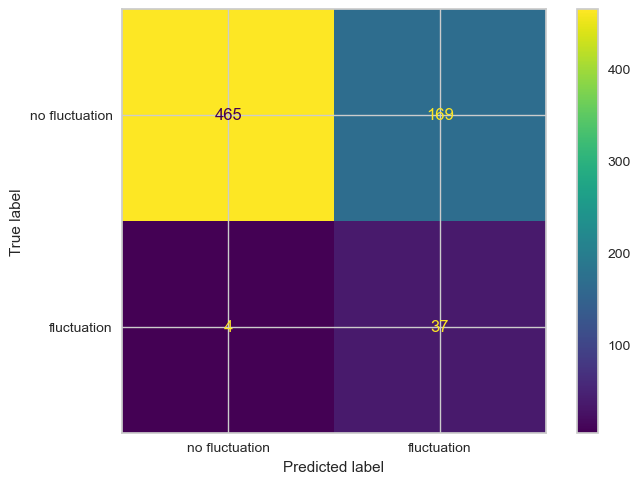

In [294]:
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix(y_pred['true'],y_pred['pred']), display_labels = ['no fluctuation','fluctuation'])
cm_display.plot()
plt.show()

## INVERTER1 - different anomaly detection techniques

In [295]:
from statsmodels.tsa.seasonal import seasonal_decompose
import matplotlib.dates as mdates

In [298]:
dfi = df[df['id']=='inverter1'].copy()
dfi = dfi.drop('id',axis=1)
dfi = dfi.set_index('datetime')

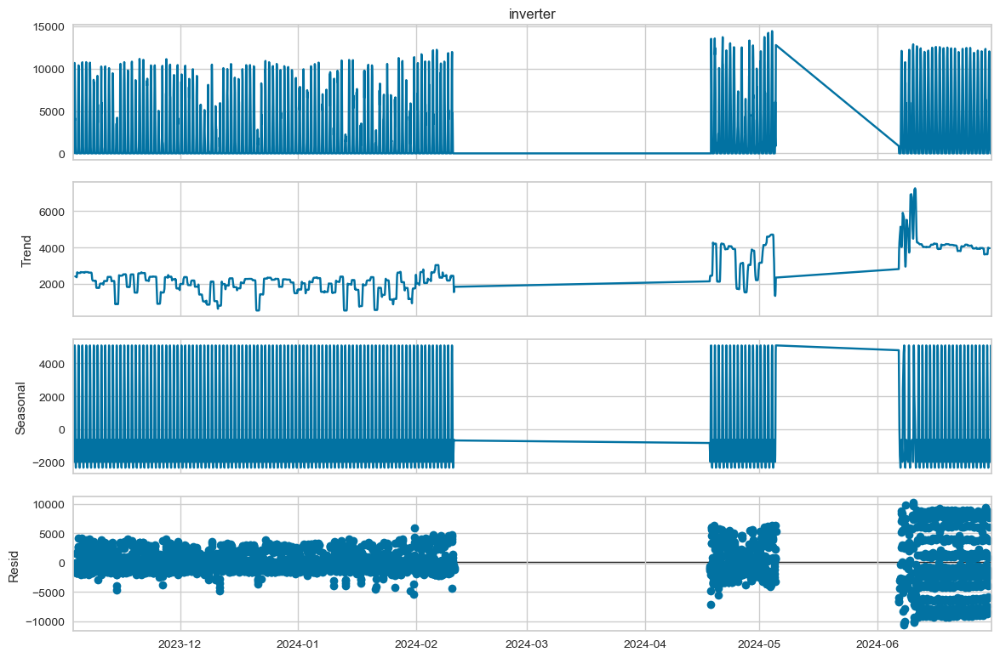

In [305]:
plt.rc('figure',figsize=(12,8))
plt.rc('font',size=15)

result = seasonal_decompose(dfi['inverter'],model='additive',period=24)
fig = result.plot()

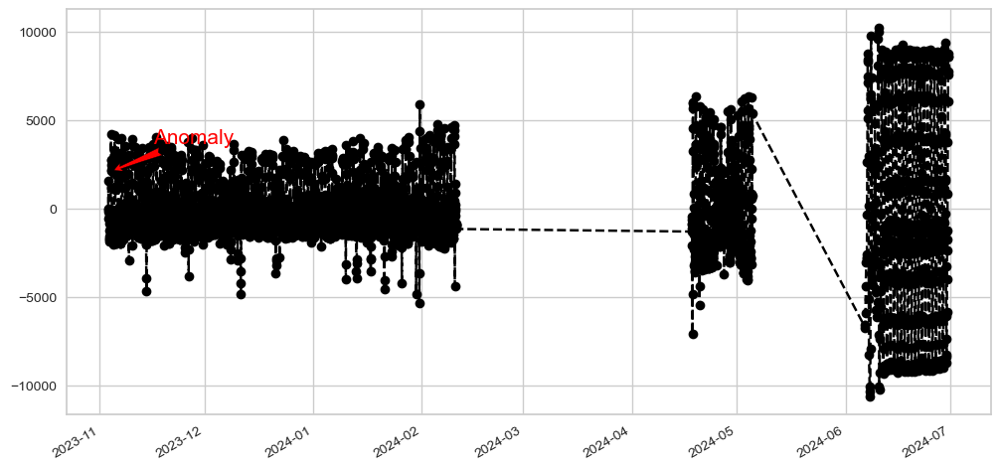

In [306]:
plt.rc('figure',figsize=(12,6))
plt.rc('font',size=15)

fig, ax = plt.subplots()
x = result.resid.index
y = result.resid.values
ax.plot_date(x, y, color='black',linestyle='--')

ax.annotate('Anomaly', (mdates.date2num(x[35]), y[35]), xytext=(30, 20), 
           textcoords='offset points', color='red',arrowprops=dict(facecolor='red',arrowstyle='fancy'))

fig.autofmt_xdate()
plt.show()

In [307]:
from sklearn.ensemble import IsolationForest

In [309]:
# train isolation forest
model =  IsolationForest(contamination=0.05)
model.fit(dfi[['inverter']]) 

IsolationForest(bootstrap=False, contamination=0.05, max_features=1.0,
                max_samples='auto', n_estimators=100, n_jobs=None,
                random_state=None, verbose=0, warm_start=False)

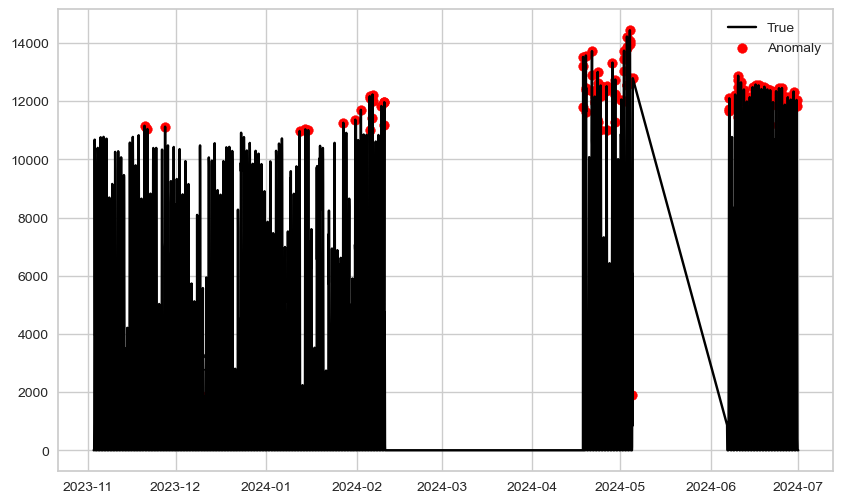

In [324]:
dfi['anomaly'] = model.predict(dfi[['inverter']])

# visualization
fig, ax = plt.subplots(figsize=(10,6))

a = dfi.loc[dfi['anomaly'] == -1, ['inverter']] #anomaly

ax.plot(dfi.index, dfi['inverter'], color='black', label = 'True')
ax.scatter(a.index,a['inverter'], color='red', label = 'Anomaly')
plt.legend()
plt.show();

In [330]:
dfi = dfi.reset_index()

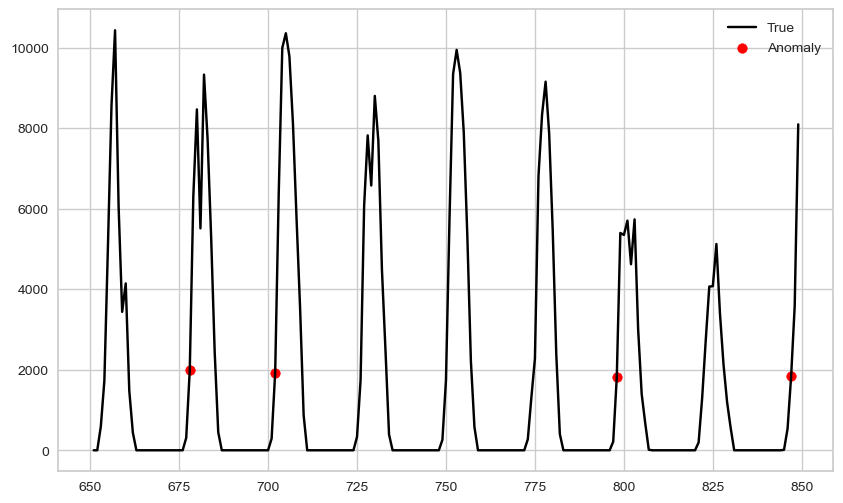

In [334]:
dfi['anomaly'] = model.predict(dfi[['inverter']])

x=650
y=850

# visualization
fig, ax = plt.subplots(figsize=(10,6))

a = dfi.loc[dfi['anomaly'] == -1, ['inverter']] #anomaly

ax.plot(dfi.index[(dfi.index>x) & (dfi.index<y)], dfi['inverter'][(dfi.index>x) & (dfi.index<y)], color='black', label = 'True')
ax.scatter(a.index[(a.index>x) & (a.index<y)],a['inverter'][(a.index>x) & (a.index<y)], color='red', label = 'Anomaly')
plt.legend()
plt.show();

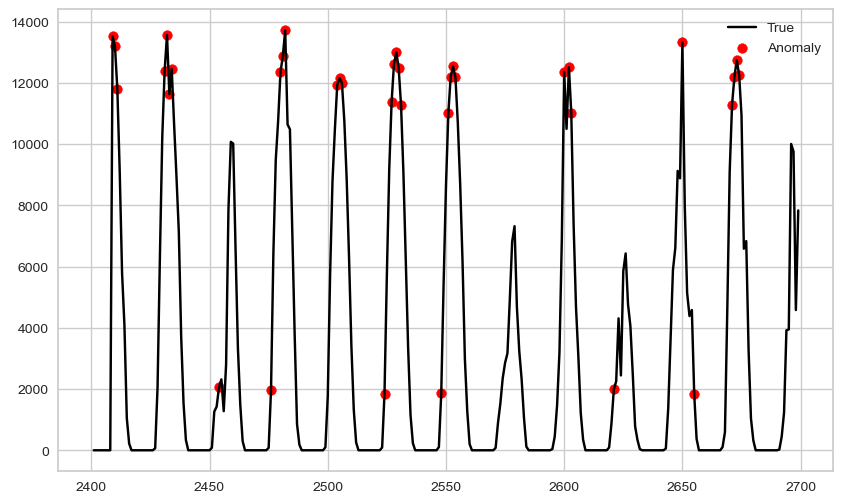

In [338]:
dfi['anomaly'] = model.predict(dfi[['inverter']])

x=2400
y=2700

# visualization
fig, ax = plt.subplots(figsize=(10,6))

a = dfi.loc[dfi['anomaly'] == -1, ['inverter']] #anomaly

ax.plot(dfi.index[(dfi.index>x) & (dfi.index<y)], dfi['inverter'][(dfi.index>x) & (dfi.index<y)], color='black', label = 'True')
ax.scatter(a.index[(a.index>x) & (a.index<y)],a['inverter'][(a.index>x) & (a.index<y)], color='red', label = 'Anomaly')
plt.legend()
plt.show();

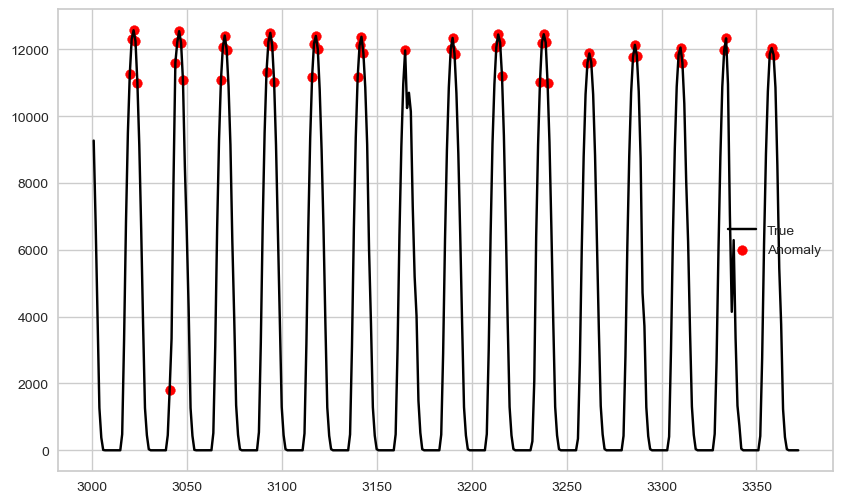

In [345]:
dfi['anomaly'] = model.predict(dfi[['inverter']])

x=3000
y=4000

# visualization
fig, ax = plt.subplots(figsize=(10,6))

a = dfi.loc[dfi['anomaly'] == -1, ['inverter']] #anomaly

ax.plot(dfi.index[(dfi.index>x) & (dfi.index<y)], dfi['inverter'][(dfi.index>x) & (dfi.index<y)], color='black', label = 'True')
ax.scatter(a.index[(a.index>x) & (a.index<y)],a['inverter'][(a.index>x) & (a.index<y)], color='red', label = 'Anomaly')
plt.legend()
plt.show();

In [346]:
from sklearn.neighbors import LocalOutlierFactor

In [347]:
model = LocalOutlierFactor() 

In [349]:
model.fit(dfi.set_index('datetime')[['inverter']])

LocalOutlierFactor(algorithm='auto', contamination='auto', leaf_size=30,
                   metric='minkowski', metric_params=None, n_jobs=None,
                   n_neighbors=20, novelty=False, p=2)

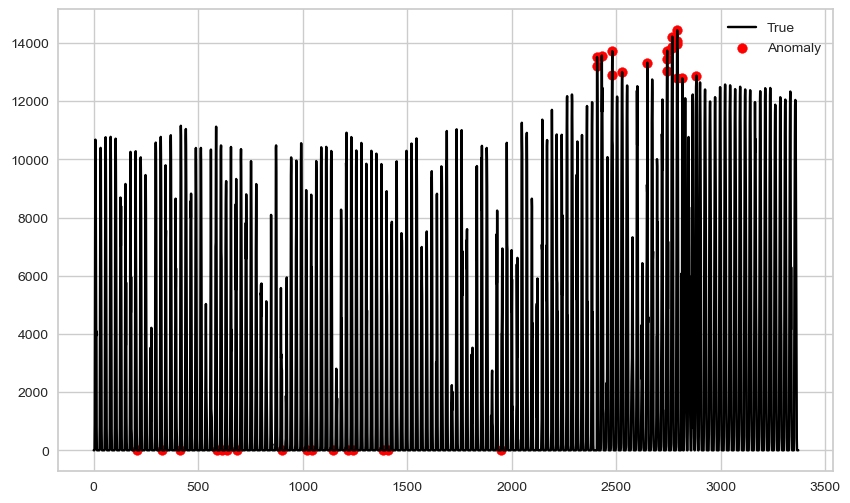

In [351]:
dfi['anomaly_2'] = model.fit_predict(dfi.set_index('datetime')[['inverter']])

# visualization
fig, ax = plt.subplots(figsize=(10,6))

a = dfi.loc[dfi['anomaly_2'] == -1, ['inverter']] #anomaly

ax.plot(dfi.index, dfi['inverter'], color='black', label = 'True')
ax.scatter(a.index,a['inverter'], color='red', label = 'Anomaly')
plt.legend()
plt.show();

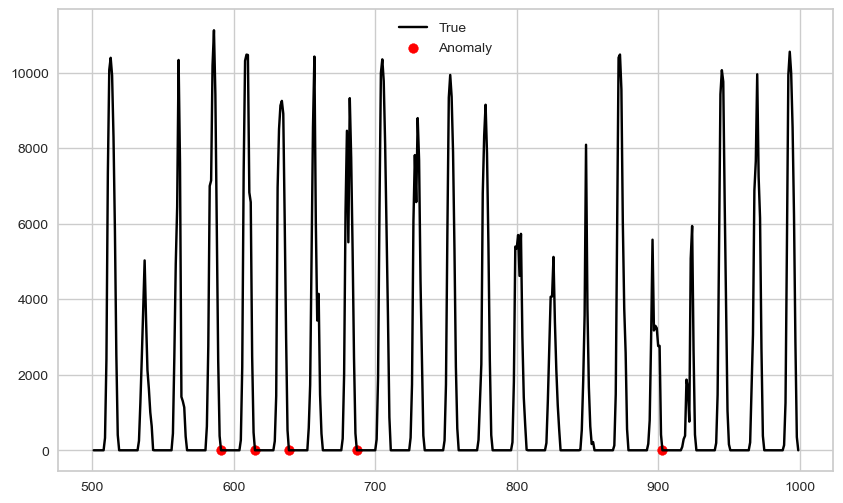

In [354]:
x=500
y=1000

# visualization
fig, ax = plt.subplots(figsize=(10,6))

a = dfi.loc[dfi['anomaly_2'] == -1, ['inverter']] #anomaly

ax.plot(dfi.index[(dfi.index>x) & (dfi.index<y)], dfi['inverter'][(dfi.index>x) & (dfi.index<y)], color='black', label = 'True')
ax.scatter(a.index[(a.index>x) & (a.index<y)],a['inverter'][(a.index>x) & (a.index<y)], color='red', label = 'Anomaly')
plt.legend()
plt.show();